In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from scipy.signal import convolve2d
from scipy.spatial.distance import *
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA

%matplotlib inline 

In [2]:
def getFilenames( train = True):
    names = []
    label = []
    folderName = './CASIA Iris Image Database (version 1.0)/'
     
    if train == True:
        numImg = 3
        index = 1
    else: 
        numImg = 4
        index = 2
        
    for i in range(1,109):
        for j in range(1,np.int0(numImg + 1)):       
            fileName = folderName + '{:03}'.format(i) + '/'+ '{:01}'.format(index) +'/' + '{:03}'.format(i) +'_' +'{:01}'.format(index)+'_' + '{:01}'.format(j) +'.bmp'
            names.append(fileName)
            label.append(i)
    return(names, label)

In [3]:
def getBestCircle(CircleCenterList, pupilCenter):
    a = CircleCenterList
    b = pupilCenter
    dis = []
    for i in range(0, len(a)):
        dis.append(euclidean(a[i][0:2], b[0:2]))
    return(a[np.argmin(dis)])


# Detecting Pupil and Outer Boundary of Iris
- Step 1: Roughtly Estimate the Coordinates of the Pupil by Profile Projection
- Step 2: More Accurate Estimate the Coordinates of the Pupil
- Step 3: More Accurate Estimate the Coordinates of the Iris

## Step 1:  Estimate the Coordinates of the Pupil
- Project image in the horizontal and vertical direction to approximately estimate the center coordinates (Xp, Yp)
- The center coordinates are the minima of projection profiles.

In [4]:
def roughPupilBound(img):
    #ret, thresh0 = cv2.threshold(img[65:, 60:-40],65,255,cv2.THRESH_BINARY)
    ret, thresh0 = cv2.threshold(img[70:, 62:-62],64,65,cv2.THRESH_BINARY)
    #plt.imshow(thresh0, cmap = 'gray')
    #plt.show()
    #ret, thresh0 = cv2.threshold(img,65,255,cv2.THRESH_BINARY)
    ver_pro = np.sum(thresh0, axis = 0)  # vertical projection profile, col sum, 320
    hor_pro = np.sum(thresh0, axis = 1)  # horizontal projection profile, row sum, 280
    Xp = np.argmin(ver_pro) # minima of vertical projection - vertical center of pupil
    Yp = np.argmin(hor_pro) # minima of vertical projection - horizontal center of pupil
    #return(Xp ,Yp )
    #return(Xp + 60 ,Yp + 65 )
    return(Xp + 62 ,Yp + 70 )

## Step 2:  More Accurate Estimate the Coordinates of the Pupil
- Subset a 120x120 region centered at the point (Xp, Yp)
- Calculate the radius and center of pupil by Canny edge detection and Hough transform

In [20]:
def pupilBoundary(img):
    [Xp,Yp] = roughPupilBound(img)
    
    subimg = img[(Yp-62):(Yp+62), (Xp-64):(Xp+70)]
    ret, thresh = cv2.threshold(subimg,64,65,cv2.THRESH_BINARY)

    Xp_acc,Yp_acc = roughPupilBound(thresh)
    
    dia1 = (np.max(np.where(thresh[Yp_acc, ] ==0)) - np.min(np.where(thresh[Yp_acc, ] ==0)))
    dia2 = (np.max(np.where(thresh[:,Xp_acc] ==0)) - np.min(np.where(thresh[:, Xp_acc] ==0)))
    radius = np.int0(np.sum([dia1,dia2])/4)
    #imgm = cv2.GaussianBlur(img,(5,5),0)
    
    imgm = cv2.medianBlur(img,3)
    #imgm = cv2.GaussianBlur(imgm,(5,5),0)
    testimg = cv2.normalize(imgm, 242, 255)
    edge = cv2.Canny(testimg,0, 1, L2gradient = True)[72:,(Xp-75):(Xp+75)]
    #plt.imshow(edge, cmap = 'gray')
    #plt.show()

    circle = None
    i = 0
    while circle is None:
        
        circle = cv2.HoughCircles(edge, cv2.HOUGH_GRADIENT,1,250,
                                  param1 =50,param2=10,minRadius= radius - i,maxRadius =  radius + i)
        i = i +1
        
        if circle is None:
            pass
        else:
            break
    
    circle = np.int0(np.array(circle))       
    [xp,yp,r] = circle[0,0]

    return(xp + (Xp-75), yp + 72,r)
    #return(xp , yp,r)


## Step 3:  More Accurate Estimate the Coordinates of the Iris
- Subset a 240x210 region centered at the point (Xp, Yp)
- Calculate the radius and center of Iris by Canny edge detection and Hough transform

In [21]:
def irisBoundary(img):
    [Xp,Yp,r] = pupilBoundary(img)
    #
    imgm = cv2.medianBlur(img,3)
    #imgm = cv2.GaussianBlur(imgm,(5,5),0)
    circles = []
    rmID = []

    threshList = list(range(110,225,1))
    for i in range(0, len(threshList)):
        testimg = cv2.normalize(imgm, 110, threshList[i])
        edge = cv2.Canny(testimg,0, 1,apertureSize = 3, L2gradient = True)
        #plt.imshow(testimg, cmap = 'gray')
        #plt.show()
        c = cv2.HoughCircles(edge, cv2.HOUGH_GRADIENT,1,250,
                           param1=30,param2=10,minRadius= 98,maxRadius= 118)
        #print(c)
        if c is None:
            rmID.append(i)
            #circles.append(c)
        else:
            circles.append(c[0,0])
    #print(circles)

    #for i in range(0, len(circles)):
        #cir_img = img.copy()
        #[xp,yp,r] = np.int0(np.array(circles[i]))
        #cv2.circle(cir_img,(xp,yp),r,(0,0,255),2)
        #plt.imshow(cir_img, cmap = 'gray')
        #plt.show()
    [X_iris, Y_iris, r_iris] = getBestCircle(circles, pupilBoundary(img))
    #[X_iris, Y_iris, r_iris] = getBestCircle(circles,pupilBoundary(img))
    return(X_iris, Y_iris, r_iris)
    


## Test of Our Functions Above:

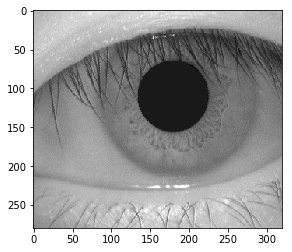

0

In [17]:
# Load an color image in grayscale   #/074/2/074_2_3.bmp
img = cv2.imread('./CASIA Iris Image Database (version 1.0)/011/2/011_2_2.bmp',0)  # 091/2/091_2_1.bmp  019/1/019_1_3.bmp
#011/1/011_1_1.bmp   020_1_1.bmp  023_1_3.bmp  039_1_3.bmp
plt.imshow(img , cmap = 'gray')
plt.show()
#edge = cv2.Canny(img,110, 220)
#plt.imshow(edge  , cmap = 'gray')
#plt.show()
len([])

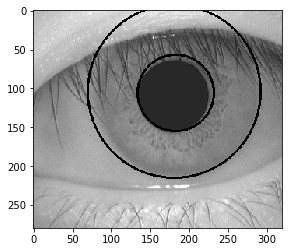

In [22]:
def drawIris(img):
    #img = cv2.imread(filename,0) 
    cir_img = img.copy()
    [X_pupil,Y_pupil,r] = pupilBoundary(img)
    [X_iris, Y_iris, r_iris] = irisBoundary(img)
    cv2.circle(cir_img,(X_pupil,Y_pupil),r,(0,0,255),2)
    cv2.circle(cir_img,(X_iris,Y_iris),r_iris,(0,0,255),2)
    plt.imshow(cir_img, cmap = 'gray')
    plt.show()
    
    return
drawIris(img)

./CASIA Iris Image Database (version 1.0)/101/1/101_1_1.bmp


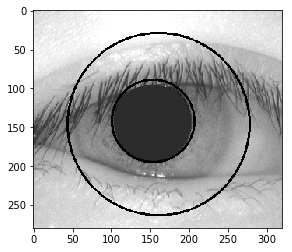

./CASIA Iris Image Database (version 1.0)/101/1/101_1_2.bmp


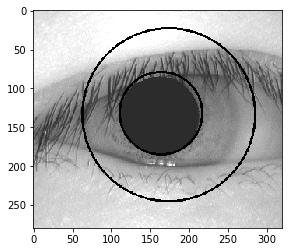

./CASIA Iris Image Database (version 1.0)/101/1/101_1_3.bmp


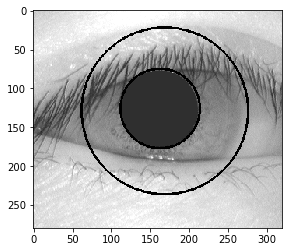

./CASIA Iris Image Database (version 1.0)/101/2/101_2_1.bmp


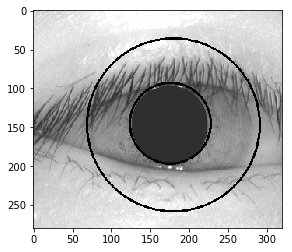

./CASIA Iris Image Database (version 1.0)/101/2/101_2_2.bmp


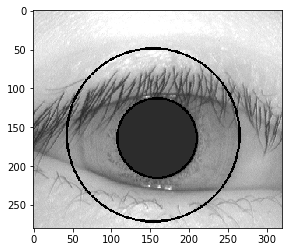

./CASIA Iris Image Database (version 1.0)/101/2/101_2_3.bmp


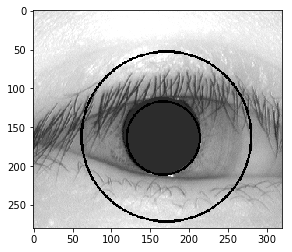

./CASIA Iris Image Database (version 1.0)/101/2/101_2_4.bmp


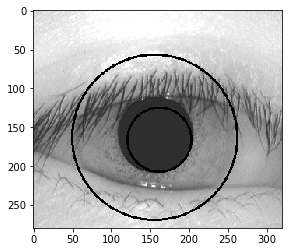

./CASIA Iris Image Database (version 1.0)/039/1/039_1_2.bmp


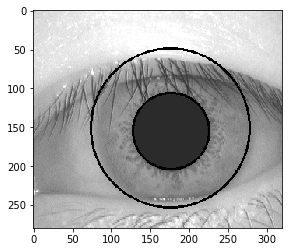

./CASIA Iris Image Database (version 1.0)/039/1/039_1_3.bmp


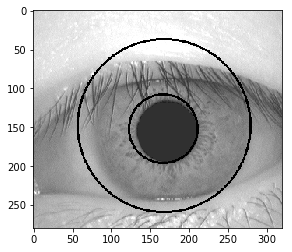

./CASIA Iris Image Database (version 1.0)/039/2/039_2_1.bmp


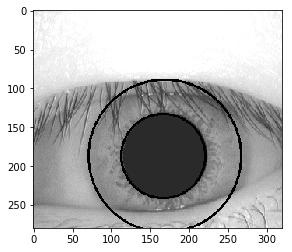

./CASIA Iris Image Database (version 1.0)/039/2/039_2_2.bmp


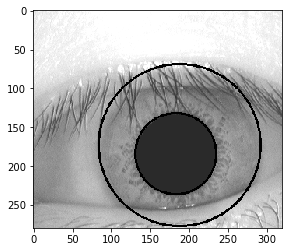

./CASIA Iris Image Database (version 1.0)/039/2/039_2_3.bmp


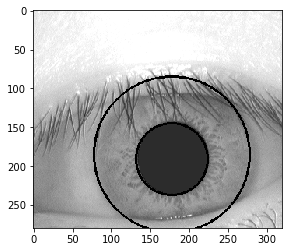

./CASIA Iris Image Database (version 1.0)/039/2/039_2_4.bmp


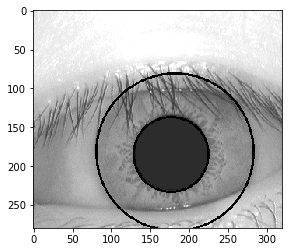

./CASIA Iris Image Database (version 1.0)/040/1/040_1_1.bmp


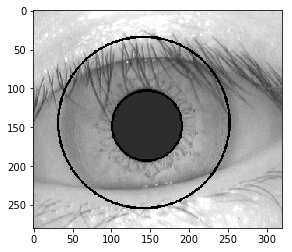

./CASIA Iris Image Database (version 1.0)/040/1/040_1_2.bmp


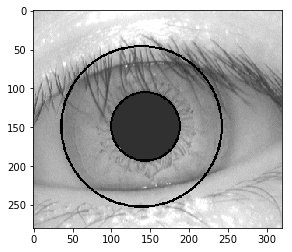

./CASIA Iris Image Database (version 1.0)/040/1/040_1_3.bmp


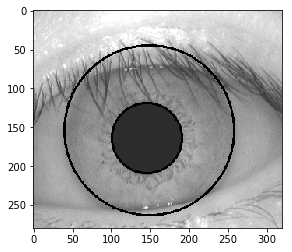

./CASIA Iris Image Database (version 1.0)/090/1/090_1_1.bmp


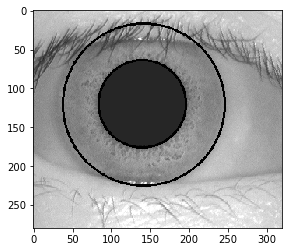

./CASIA Iris Image Database (version 1.0)/090/1/090_1_2.bmp


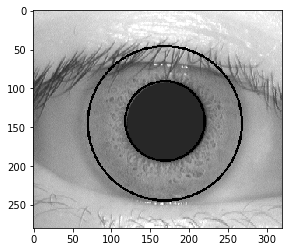

./CASIA Iris Image Database (version 1.0)/090/1/090_1_3.bmp


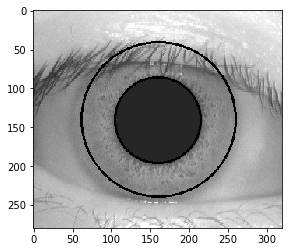

In [23]:


imgNames = ['./CASIA Iris Image Database (version 1.0)/101/1/101_1_1.bmp',
'./CASIA Iris Image Database (version 1.0)/101/1/101_1_2.bmp',
'./CASIA Iris Image Database (version 1.0)/101/1/101_1_3.bmp',
'./CASIA Iris Image Database (version 1.0)/101/2/101_2_1.bmp',
'./CASIA Iris Image Database (version 1.0)/101/2/101_2_2.bmp',
'./CASIA Iris Image Database (version 1.0)/101/2/101_2_3.bmp',
'./CASIA Iris Image Database (version 1.0)/101/2/101_2_4.bmp',
'./CASIA Iris Image Database (version 1.0)/039/1/039_1_2.bmp',
'./CASIA Iris Image Database (version 1.0)/039/1/039_1_3.bmp',
'./CASIA Iris Image Database (version 1.0)/039/2/039_2_1.bmp',
'./CASIA Iris Image Database (version 1.0)/039/2/039_2_2.bmp',
'./CASIA Iris Image Database (version 1.0)/039/2/039_2_3.bmp',
'./CASIA Iris Image Database (version 1.0)/039/2/039_2_4.bmp',
'./CASIA Iris Image Database (version 1.0)/040/1/040_1_1.bmp',
'./CASIA Iris Image Database (version 1.0)/040/1/040_1_2.bmp',
'./CASIA Iris Image Database (version 1.0)/040/1/040_1_3.bmp',
'./CASIA Iris Image Database (version 1.0)/090/1/090_1_1.bmp',
'./CASIA Iris Image Database (version 1.0)/090/1/090_1_2.bmp',
'./CASIA Iris Image Database (version 1.0)/090/1/090_1_3.bmp',
]

#'./CASIA Iris Image Database (version 1.0)/079/2/079_2_1.bmp',
#'./CASIA Iris Image Database (version 1.0)/079/2/079_2_2.bmp',
#'./CASIA Iris Image Database (version 1.0)/079/2/079_2_3.bmp',
#'./CASIA Iris Image Database (version 1.0)/079/2/079_2_4.bmp'

for i in range(0, len(imgNames)):
    name0 = imgNames[i]
    img00 = cv2.imread(name0,0)
    print(name0)
    drawIris(img00)

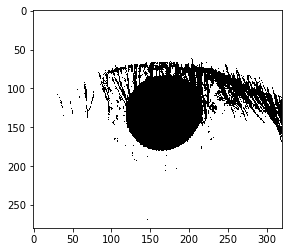

In [35]:
[Xp,Yp] = roughPupilBound(img)
    
subimg = img[(Yp-60):(Yp+60), (Xp-65):(Xp+65)]
ret, thresh = cv2.threshold(subimg,65,255,cv2.THRESH_BINARY)
Xp_acc,Yp_acc = roughPupilBound(thresh)
    
dia1 = (np.max(np.where(thresh[Yp_acc, ] ==0)) - np.min(np.where(thresh[Yp_acc, ] ==0)))
dia2 = (np.max(np.where(thresh[:,Xp_acc] ==0)) - np.min(np.where(thresh[:, Xp_acc] ==0)))
radius = np.int0(np.sum([dia1,dia2])/4)
    
testimg = cv2.normalize(img, 242, 255)
edge = cv2.Canny(testimg,0, 1)#[92:,(Xp-75):(Xp+75)]
plt.imshow(testimg, cmap = 'gray')
plt.show()

In [23]:
print(radius)
cir_img = img.copy()
circle = cv2.HoughCircles(edge, cv2.HOUGH_GRADIENT,1,250,
                           param1 =50,param2=10,minRadius= radius,maxRadius =  radius + 4)
circle = np.int0(np.array(circle))
[xp,yp,r] = circle[0,0]

cv2.circle(cir_img,(xp,yp),r,(0,0,255),2)
plt.imshow(cir_img, cmap = 'gray')
plt.show()

49


TypeError: int() argument must be a string, a bytes-like object or a number, not 'NoneType'

./CASIA Iris Image Database (version 1.0)/001/2/001_2_1.bmp


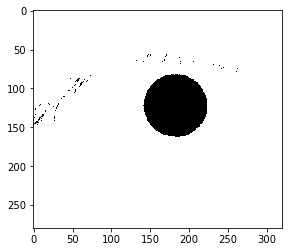

./CASIA Iris Image Database (version 1.0)/001/2/001_2_2.bmp


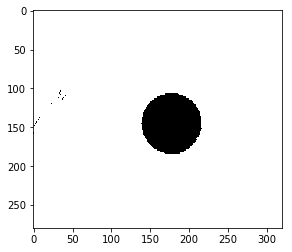

./CASIA Iris Image Database (version 1.0)/001/2/001_2_3.bmp


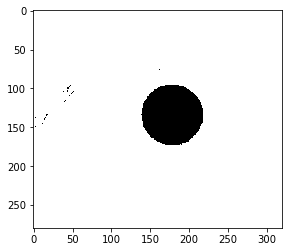

./CASIA Iris Image Database (version 1.0)/001/2/001_2_4.bmp


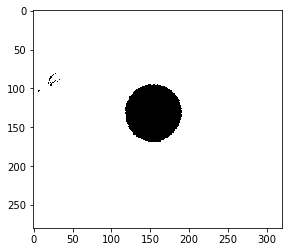

./CASIA Iris Image Database (version 1.0)/002/2/002_2_1.bmp


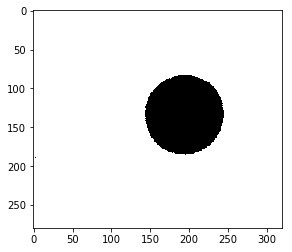

./CASIA Iris Image Database (version 1.0)/002/2/002_2_2.bmp


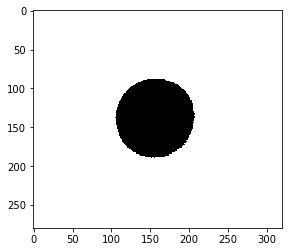

./CASIA Iris Image Database (version 1.0)/002/2/002_2_3.bmp


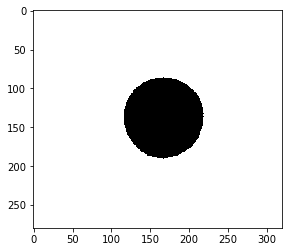

./CASIA Iris Image Database (version 1.0)/002/2/002_2_4.bmp


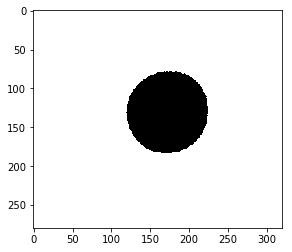

./CASIA Iris Image Database (version 1.0)/003/2/003_2_1.bmp


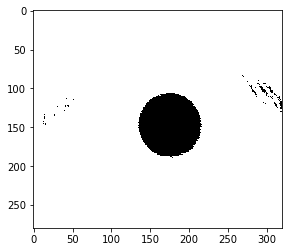

./CASIA Iris Image Database (version 1.0)/003/2/003_2_2.bmp


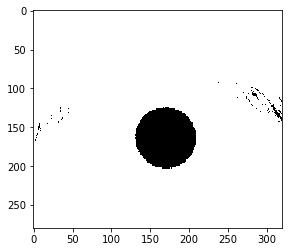

./CASIA Iris Image Database (version 1.0)/003/2/003_2_3.bmp


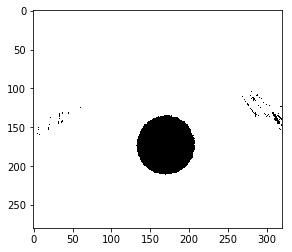

./CASIA Iris Image Database (version 1.0)/003/2/003_2_4.bmp


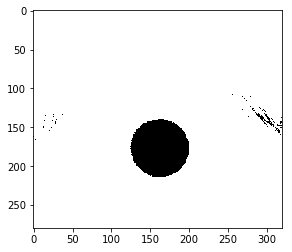

./CASIA Iris Image Database (version 1.0)/004/2/004_2_1.bmp


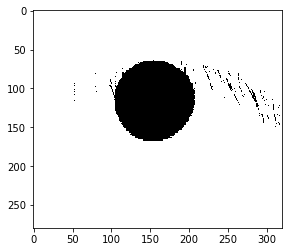

./CASIA Iris Image Database (version 1.0)/004/2/004_2_2.bmp


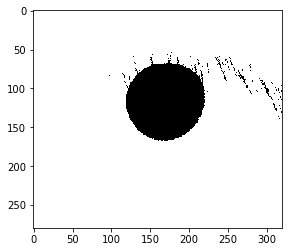

./CASIA Iris Image Database (version 1.0)/004/2/004_2_3.bmp


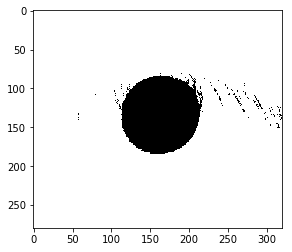

./CASIA Iris Image Database (version 1.0)/004/2/004_2_4.bmp


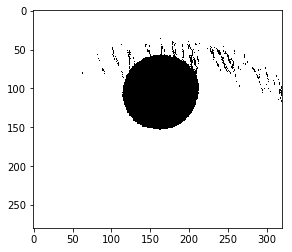

./CASIA Iris Image Database (version 1.0)/005/2/005_2_1.bmp


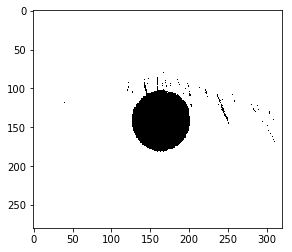

./CASIA Iris Image Database (version 1.0)/005/2/005_2_2.bmp


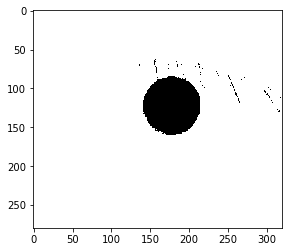

./CASIA Iris Image Database (version 1.0)/005/2/005_2_3.bmp


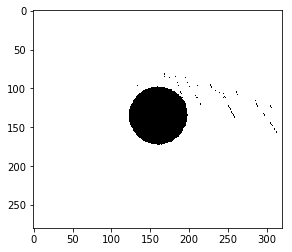

./CASIA Iris Image Database (version 1.0)/005/2/005_2_4.bmp


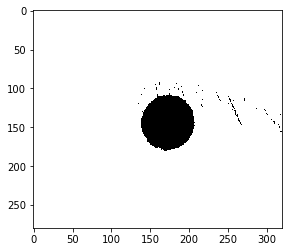

./CASIA Iris Image Database (version 1.0)/006/2/006_2_1.bmp


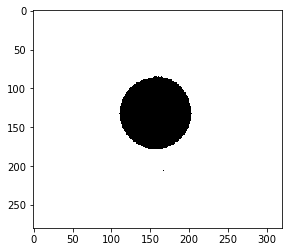

./CASIA Iris Image Database (version 1.0)/006/2/006_2_2.bmp


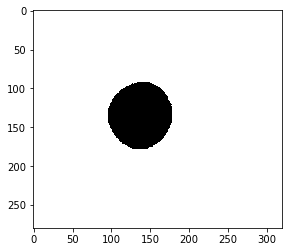

./CASIA Iris Image Database (version 1.0)/006/2/006_2_3.bmp


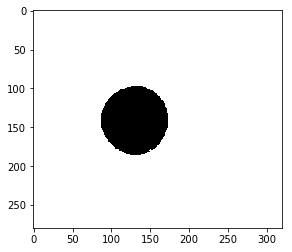

./CASIA Iris Image Database (version 1.0)/006/2/006_2_4.bmp


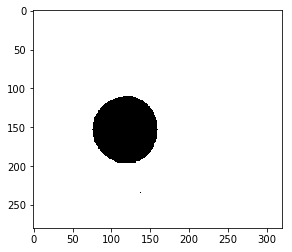

./CASIA Iris Image Database (version 1.0)/007/2/007_2_1.bmp


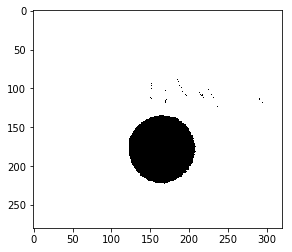

./CASIA Iris Image Database (version 1.0)/007/2/007_2_2.bmp


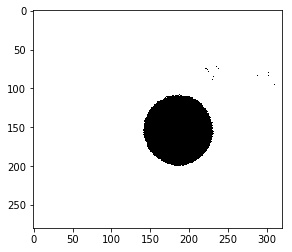

./CASIA Iris Image Database (version 1.0)/007/2/007_2_3.bmp


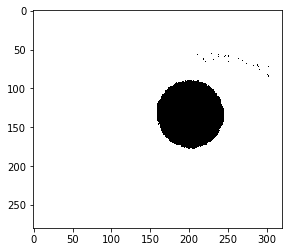

./CASIA Iris Image Database (version 1.0)/007/2/007_2_4.bmp


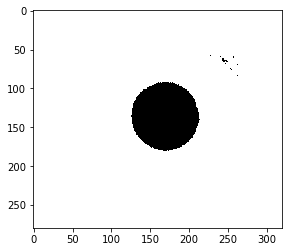

./CASIA Iris Image Database (version 1.0)/008/2/008_2_1.bmp


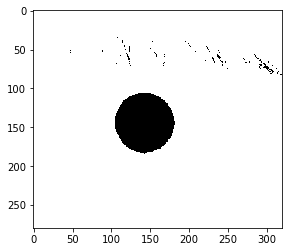

./CASIA Iris Image Database (version 1.0)/008/2/008_2_2.bmp


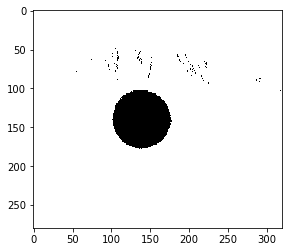

./CASIA Iris Image Database (version 1.0)/008/2/008_2_3.bmp


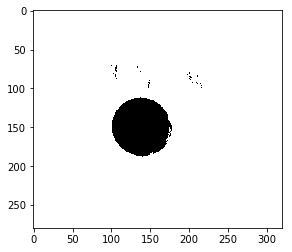

./CASIA Iris Image Database (version 1.0)/008/2/008_2_4.bmp


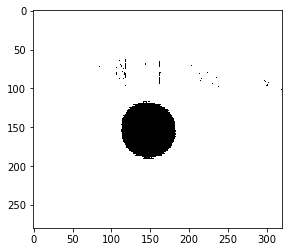

./CASIA Iris Image Database (version 1.0)/009/2/009_2_1.bmp


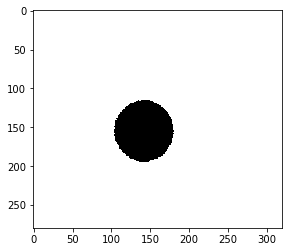

./CASIA Iris Image Database (version 1.0)/009/2/009_2_2.bmp


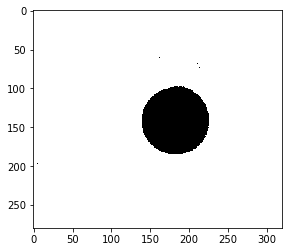

./CASIA Iris Image Database (version 1.0)/009/2/009_2_3.bmp


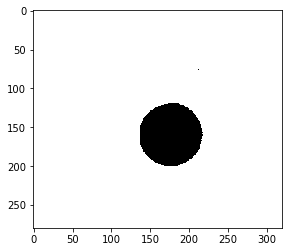

./CASIA Iris Image Database (version 1.0)/009/2/009_2_4.bmp


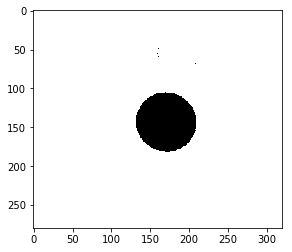

./CASIA Iris Image Database (version 1.0)/010/2/010_2_1.bmp


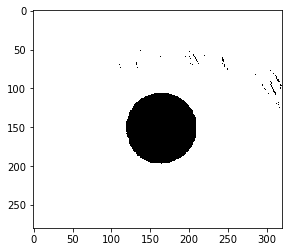

./CASIA Iris Image Database (version 1.0)/010/2/010_2_2.bmp


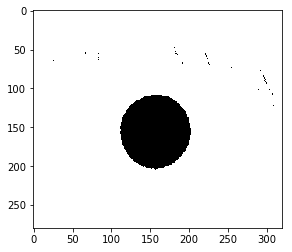

./CASIA Iris Image Database (version 1.0)/010/2/010_2_3.bmp


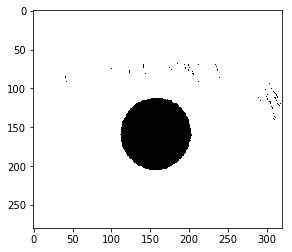

./CASIA Iris Image Database (version 1.0)/010/2/010_2_4.bmp


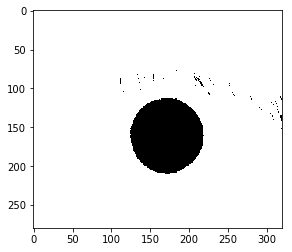

./CASIA Iris Image Database (version 1.0)/011/2/011_2_1.bmp


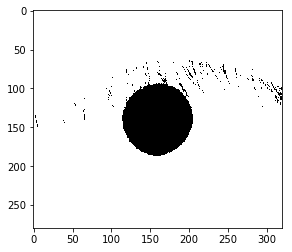

./CASIA Iris Image Database (version 1.0)/011/2/011_2_2.bmp


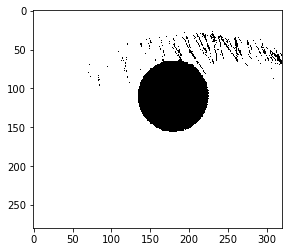

./CASIA Iris Image Database (version 1.0)/011/2/011_2_3.bmp


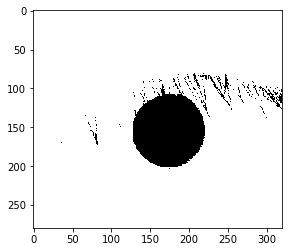

./CASIA Iris Image Database (version 1.0)/011/2/011_2_4.bmp


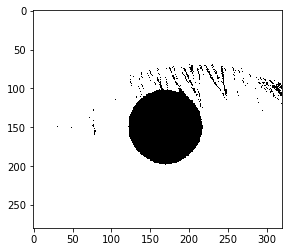

./CASIA Iris Image Database (version 1.0)/012/2/012_2_1.bmp


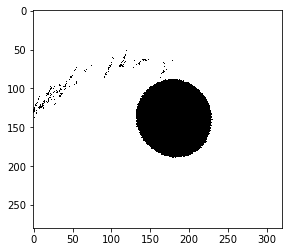

./CASIA Iris Image Database (version 1.0)/012/2/012_2_2.bmp


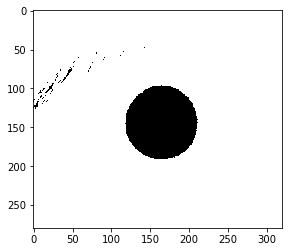

./CASIA Iris Image Database (version 1.0)/012/2/012_2_3.bmp


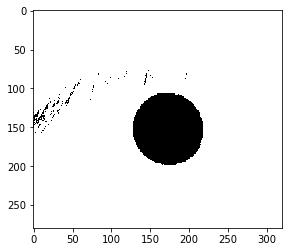

./CASIA Iris Image Database (version 1.0)/012/2/012_2_4.bmp


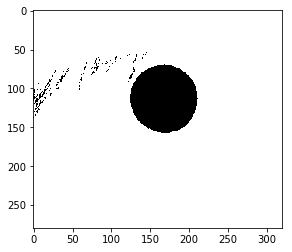

./CASIA Iris Image Database (version 1.0)/013/2/013_2_1.bmp


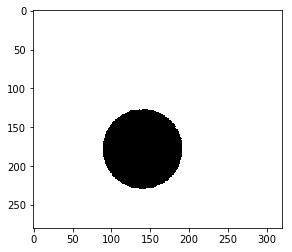

./CASIA Iris Image Database (version 1.0)/013/2/013_2_2.bmp


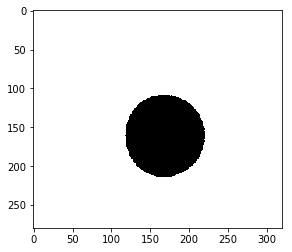

./CASIA Iris Image Database (version 1.0)/013/2/013_2_3.bmp


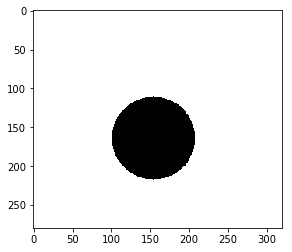

./CASIA Iris Image Database (version 1.0)/013/2/013_2_4.bmp


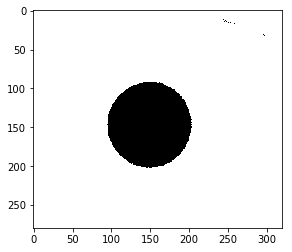

./CASIA Iris Image Database (version 1.0)/014/2/014_2_1.bmp


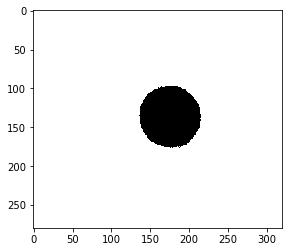

./CASIA Iris Image Database (version 1.0)/014/2/014_2_2.bmp


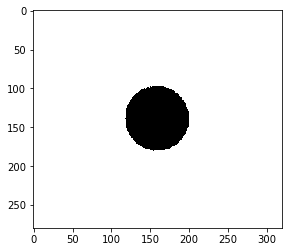

./CASIA Iris Image Database (version 1.0)/014/2/014_2_3.bmp


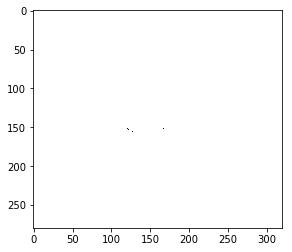

./CASIA Iris Image Database (version 1.0)/014/2/014_2_4.bmp


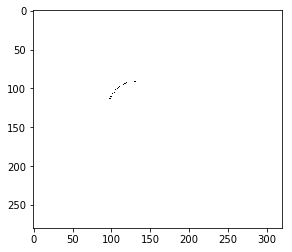

./CASIA Iris Image Database (version 1.0)/015/2/015_2_1.bmp


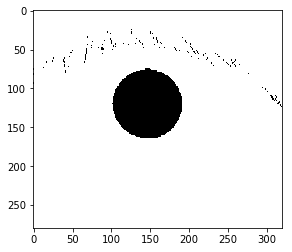

./CASIA Iris Image Database (version 1.0)/015/2/015_2_2.bmp


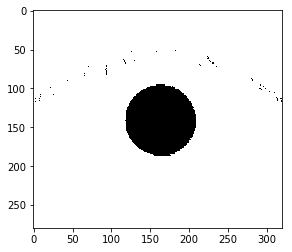

./CASIA Iris Image Database (version 1.0)/015/2/015_2_3.bmp


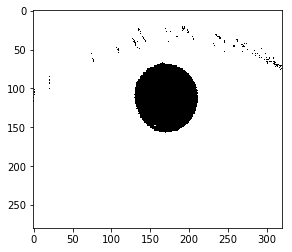

./CASIA Iris Image Database (version 1.0)/015/2/015_2_4.bmp


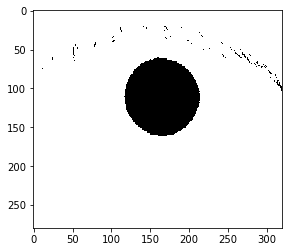

./CASIA Iris Image Database (version 1.0)/016/2/016_2_1.bmp


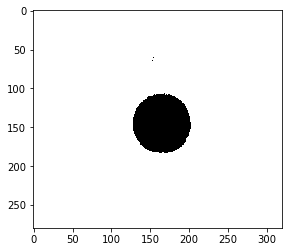

./CASIA Iris Image Database (version 1.0)/016/2/016_2_2.bmp


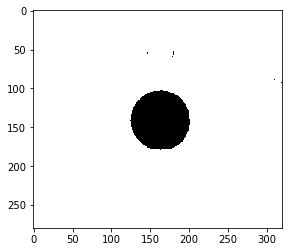

./CASIA Iris Image Database (version 1.0)/016/2/016_2_3.bmp


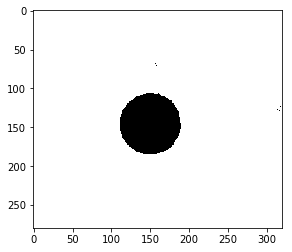

./CASIA Iris Image Database (version 1.0)/016/2/016_2_4.bmp


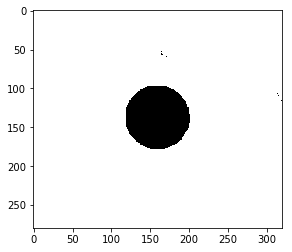

./CASIA Iris Image Database (version 1.0)/017/2/017_2_1.bmp


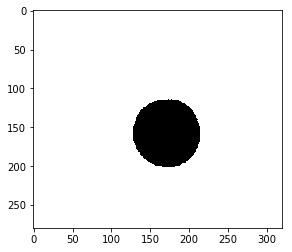

./CASIA Iris Image Database (version 1.0)/017/2/017_2_2.bmp


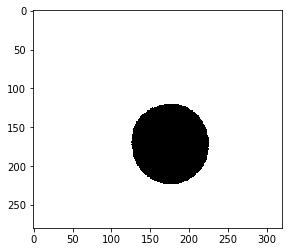

./CASIA Iris Image Database (version 1.0)/017/2/017_2_3.bmp


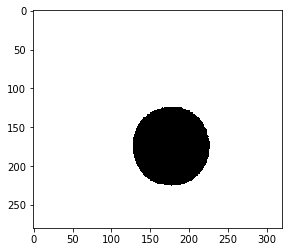

./CASIA Iris Image Database (version 1.0)/017/2/017_2_4.bmp


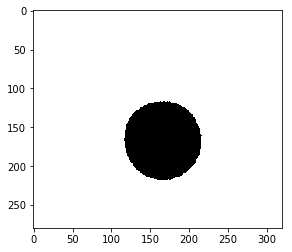

./CASIA Iris Image Database (version 1.0)/018/2/018_2_1.bmp


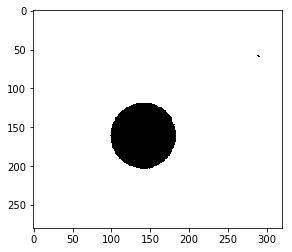

./CASIA Iris Image Database (version 1.0)/018/2/018_2_2.bmp


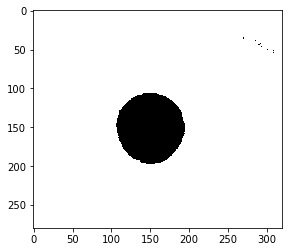

./CASIA Iris Image Database (version 1.0)/018/2/018_2_3.bmp


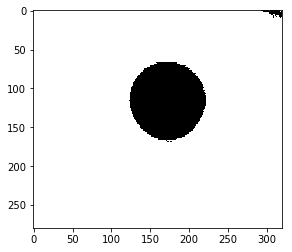

./CASIA Iris Image Database (version 1.0)/018/2/018_2_4.bmp


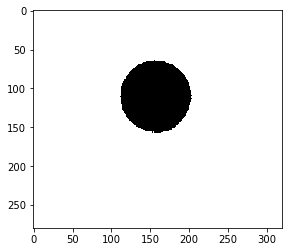

./CASIA Iris Image Database (version 1.0)/019/2/019_2_1.bmp


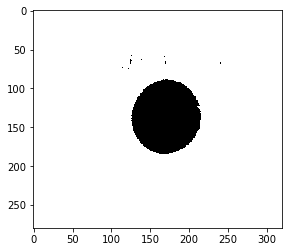

./CASIA Iris Image Database (version 1.0)/019/2/019_2_2.bmp


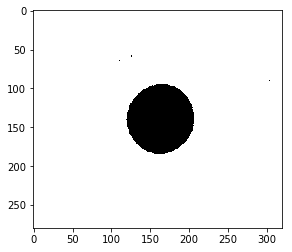

./CASIA Iris Image Database (version 1.0)/019/2/019_2_3.bmp


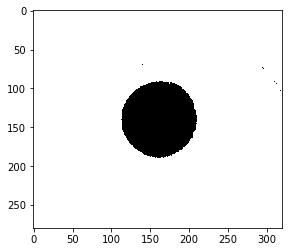

./CASIA Iris Image Database (version 1.0)/019/2/019_2_4.bmp


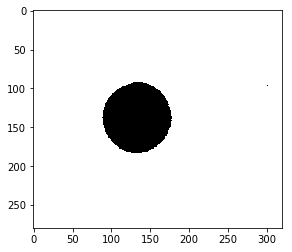

./CASIA Iris Image Database (version 1.0)/020/2/020_2_1.bmp


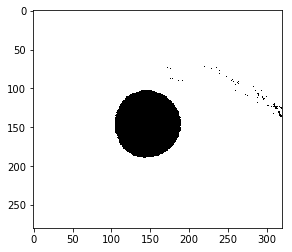

./CASIA Iris Image Database (version 1.0)/020/2/020_2_2.bmp


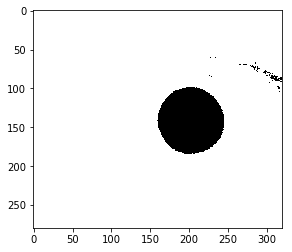

./CASIA Iris Image Database (version 1.0)/020/2/020_2_3.bmp


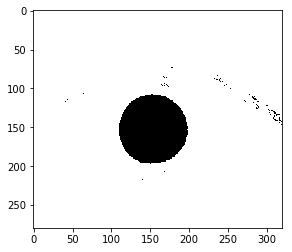

./CASIA Iris Image Database (version 1.0)/020/2/020_2_4.bmp


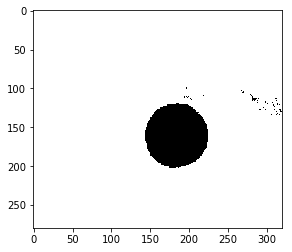

./CASIA Iris Image Database (version 1.0)/021/2/021_2_1.bmp


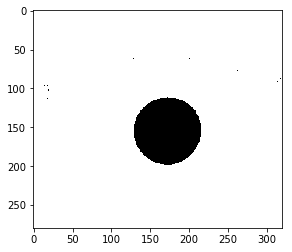

./CASIA Iris Image Database (version 1.0)/021/2/021_2_2.bmp


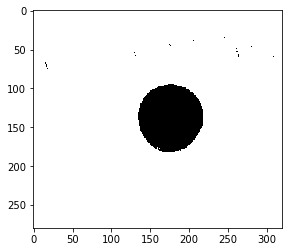

./CASIA Iris Image Database (version 1.0)/021/2/021_2_3.bmp


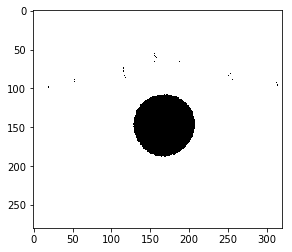

./CASIA Iris Image Database (version 1.0)/021/2/021_2_4.bmp


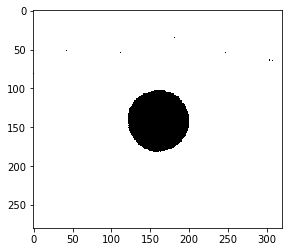

./CASIA Iris Image Database (version 1.0)/022/2/022_2_1.bmp


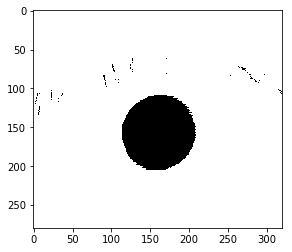

./CASIA Iris Image Database (version 1.0)/022/2/022_2_2.bmp


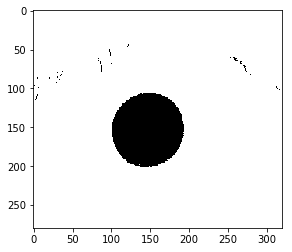

./CASIA Iris Image Database (version 1.0)/022/2/022_2_3.bmp


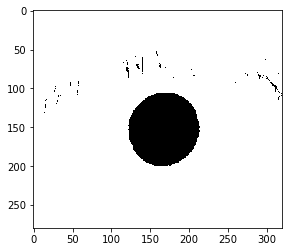

./CASIA Iris Image Database (version 1.0)/022/2/022_2_4.bmp


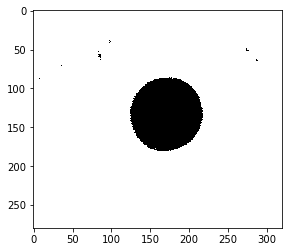

./CASIA Iris Image Database (version 1.0)/023/2/023_2_1.bmp


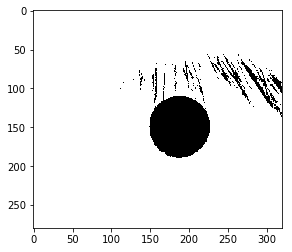

./CASIA Iris Image Database (version 1.0)/023/2/023_2_2.bmp


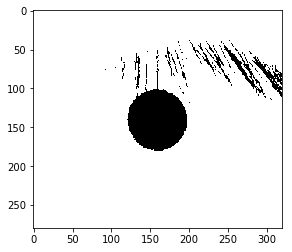

./CASIA Iris Image Database (version 1.0)/023/2/023_2_3.bmp


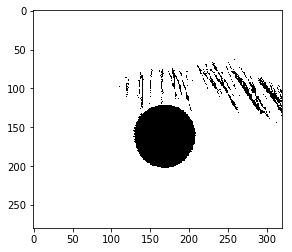

./CASIA Iris Image Database (version 1.0)/023/2/023_2_4.bmp


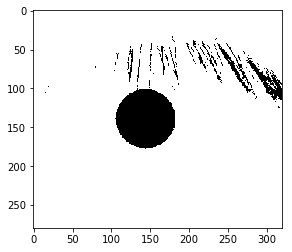

./CASIA Iris Image Database (version 1.0)/024/2/024_2_1.bmp


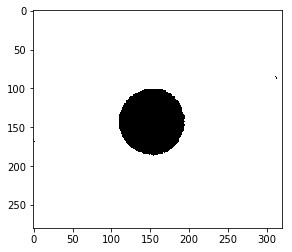

./CASIA Iris Image Database (version 1.0)/024/2/024_2_2.bmp


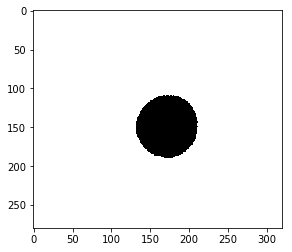

./CASIA Iris Image Database (version 1.0)/024/2/024_2_3.bmp


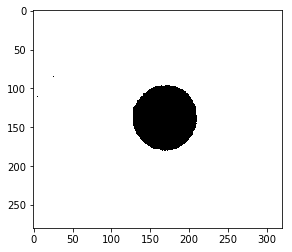

./CASIA Iris Image Database (version 1.0)/024/2/024_2_4.bmp


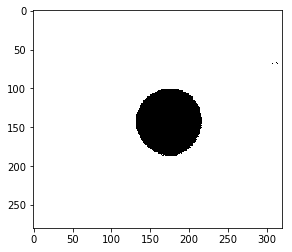

./CASIA Iris Image Database (version 1.0)/025/2/025_2_1.bmp


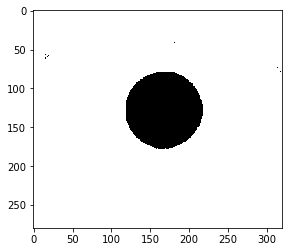

./CASIA Iris Image Database (version 1.0)/025/2/025_2_2.bmp


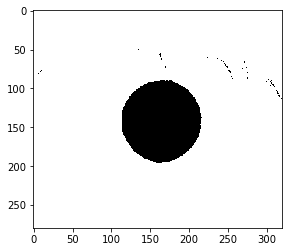

./CASIA Iris Image Database (version 1.0)/025/2/025_2_3.bmp


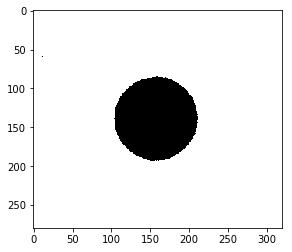

./CASIA Iris Image Database (version 1.0)/025/2/025_2_4.bmp


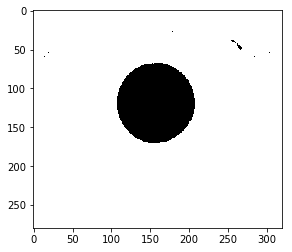

./CASIA Iris Image Database (version 1.0)/026/2/026_2_1.bmp


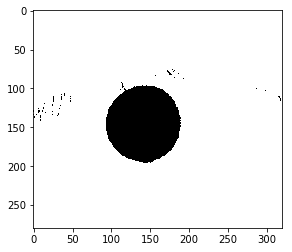

./CASIA Iris Image Database (version 1.0)/026/2/026_2_2.bmp


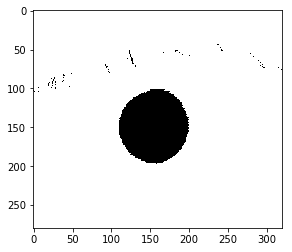

./CASIA Iris Image Database (version 1.0)/026/2/026_2_3.bmp


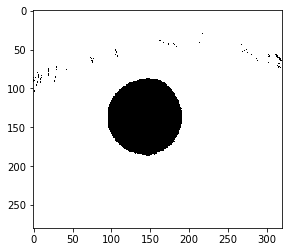

./CASIA Iris Image Database (version 1.0)/026/2/026_2_4.bmp


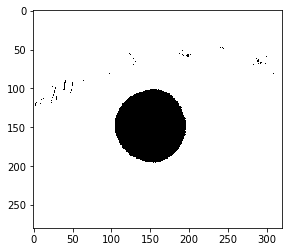

./CASIA Iris Image Database (version 1.0)/027/2/027_2_1.bmp


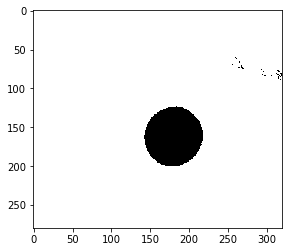

./CASIA Iris Image Database (version 1.0)/027/2/027_2_2.bmp


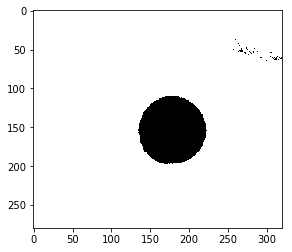

./CASIA Iris Image Database (version 1.0)/027/2/027_2_3.bmp


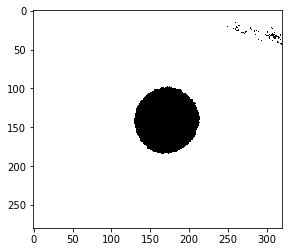

./CASIA Iris Image Database (version 1.0)/027/2/027_2_4.bmp


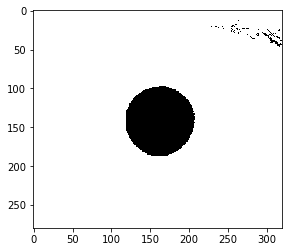

./CASIA Iris Image Database (version 1.0)/028/2/028_2_1.bmp


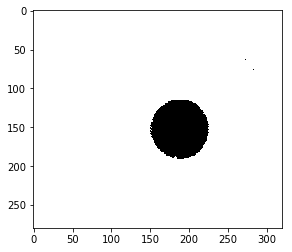

./CASIA Iris Image Database (version 1.0)/028/2/028_2_2.bmp


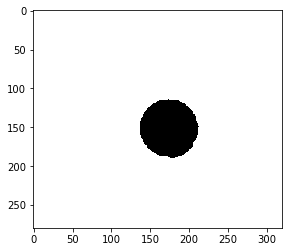

./CASIA Iris Image Database (version 1.0)/028/2/028_2_3.bmp


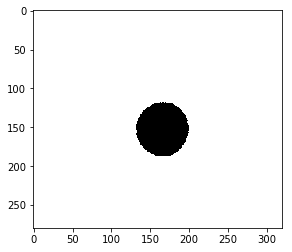

./CASIA Iris Image Database (version 1.0)/028/2/028_2_4.bmp


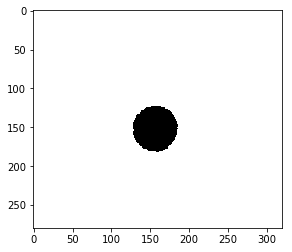

./CASIA Iris Image Database (version 1.0)/029/2/029_2_1.bmp


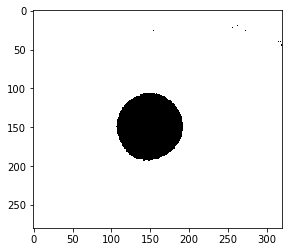

./CASIA Iris Image Database (version 1.0)/029/2/029_2_2.bmp


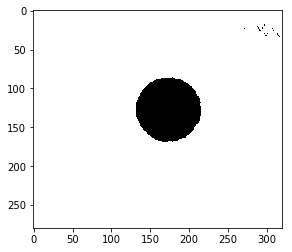

./CASIA Iris Image Database (version 1.0)/029/2/029_2_3.bmp


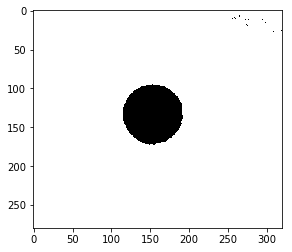

./CASIA Iris Image Database (version 1.0)/029/2/029_2_4.bmp


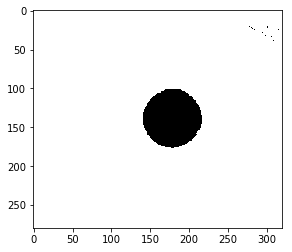

./CASIA Iris Image Database (version 1.0)/030/2/030_2_1.bmp


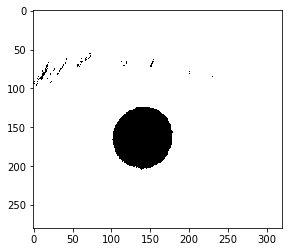

./CASIA Iris Image Database (version 1.0)/030/2/030_2_2.bmp


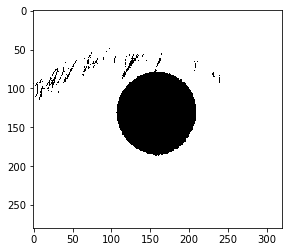

./CASIA Iris Image Database (version 1.0)/030/2/030_2_3.bmp


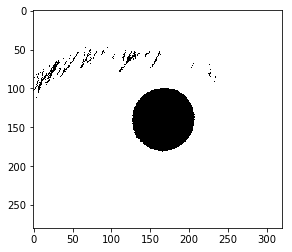

./CASIA Iris Image Database (version 1.0)/030/2/030_2_4.bmp


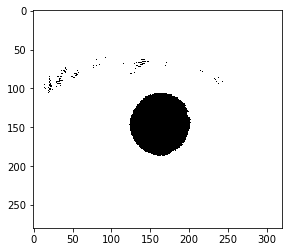

./CASIA Iris Image Database (version 1.0)/031/2/031_2_1.bmp


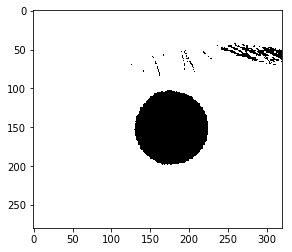

./CASIA Iris Image Database (version 1.0)/031/2/031_2_2.bmp


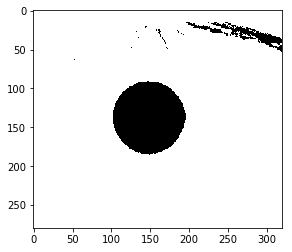

./CASIA Iris Image Database (version 1.0)/031/2/031_2_3.bmp


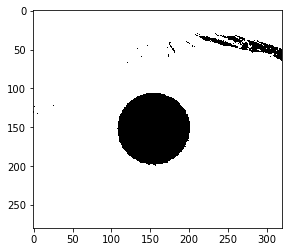

./CASIA Iris Image Database (version 1.0)/031/2/031_2_4.bmp


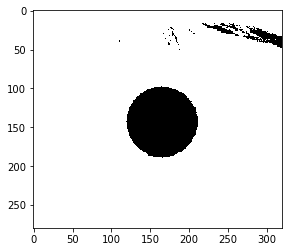

./CASIA Iris Image Database (version 1.0)/032/2/032_2_1.bmp


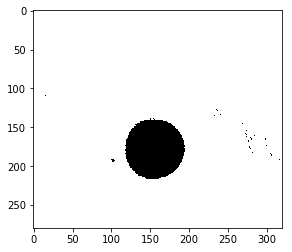

./CASIA Iris Image Database (version 1.0)/032/2/032_2_2.bmp


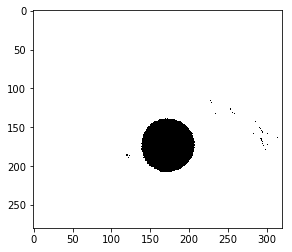

./CASIA Iris Image Database (version 1.0)/032/2/032_2_3.bmp


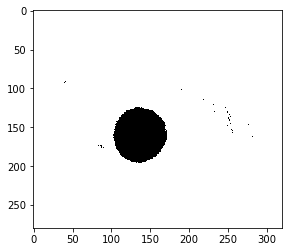

./CASIA Iris Image Database (version 1.0)/032/2/032_2_4.bmp


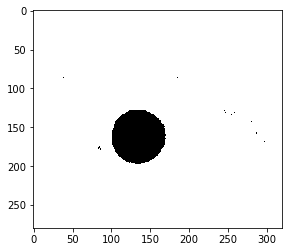

./CASIA Iris Image Database (version 1.0)/033/2/033_2_1.bmp


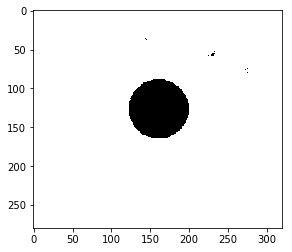

./CASIA Iris Image Database (version 1.0)/033/2/033_2_2.bmp


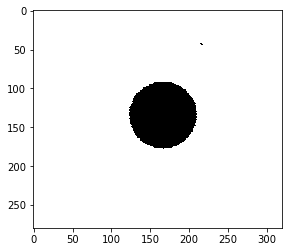

./CASIA Iris Image Database (version 1.0)/033/2/033_2_3.bmp


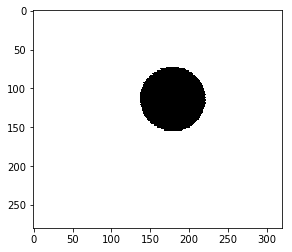

./CASIA Iris Image Database (version 1.0)/033/2/033_2_4.bmp


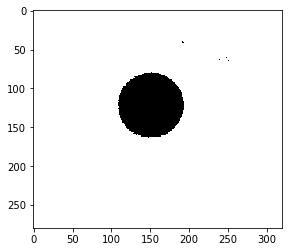

./CASIA Iris Image Database (version 1.0)/034/2/034_2_1.bmp


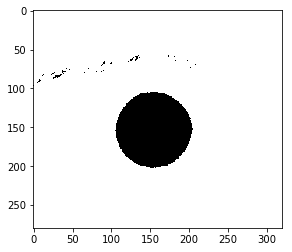

./CASIA Iris Image Database (version 1.0)/034/2/034_2_2.bmp


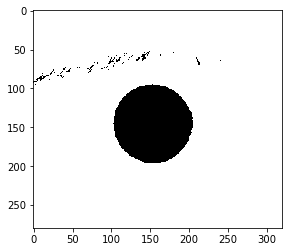

./CASIA Iris Image Database (version 1.0)/034/2/034_2_3.bmp


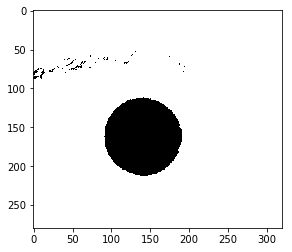

./CASIA Iris Image Database (version 1.0)/034/2/034_2_4.bmp


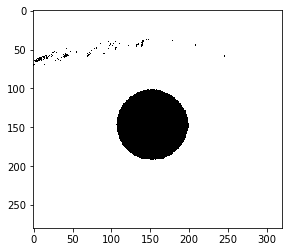

./CASIA Iris Image Database (version 1.0)/035/2/035_2_1.bmp


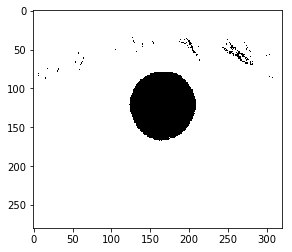

./CASIA Iris Image Database (version 1.0)/035/2/035_2_2.bmp


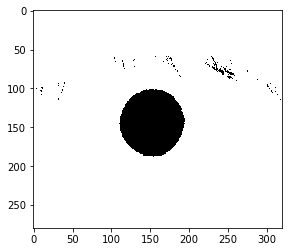

./CASIA Iris Image Database (version 1.0)/035/2/035_2_3.bmp


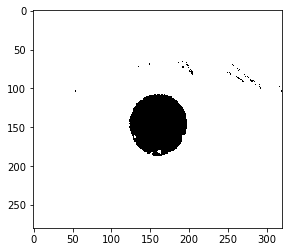

./CASIA Iris Image Database (version 1.0)/035/2/035_2_4.bmp


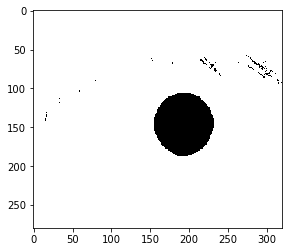

./CASIA Iris Image Database (version 1.0)/036/2/036_2_1.bmp


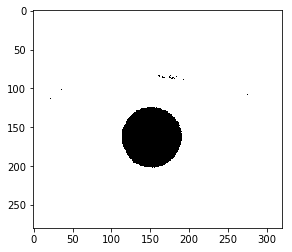

./CASIA Iris Image Database (version 1.0)/036/2/036_2_2.bmp


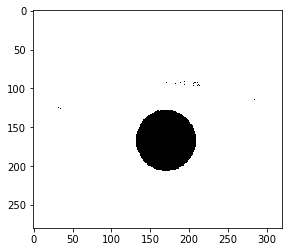

./CASIA Iris Image Database (version 1.0)/036/2/036_2_3.bmp


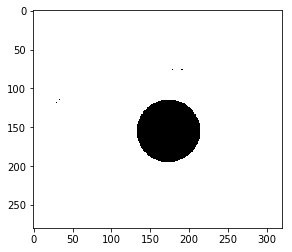

./CASIA Iris Image Database (version 1.0)/036/2/036_2_4.bmp


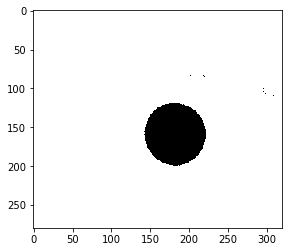

./CASIA Iris Image Database (version 1.0)/037/2/037_2_1.bmp


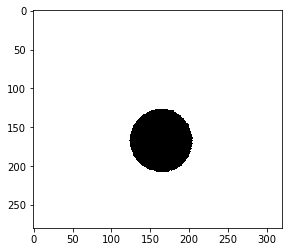

./CASIA Iris Image Database (version 1.0)/037/2/037_2_2.bmp


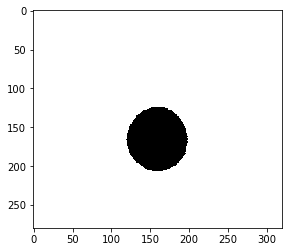

./CASIA Iris Image Database (version 1.0)/037/2/037_2_3.bmp


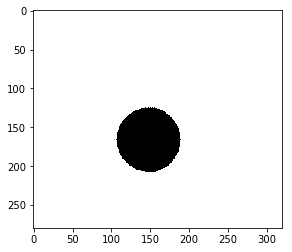

./CASIA Iris Image Database (version 1.0)/037/2/037_2_4.bmp


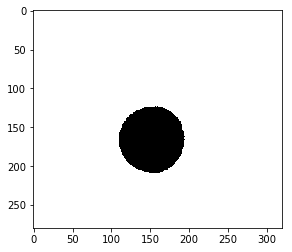

./CASIA Iris Image Database (version 1.0)/038/2/038_2_1.bmp


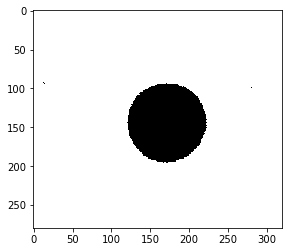

./CASIA Iris Image Database (version 1.0)/038/2/038_2_2.bmp


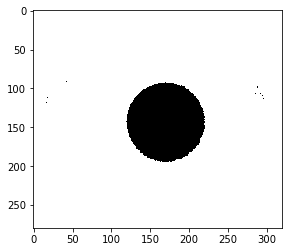

./CASIA Iris Image Database (version 1.0)/038/2/038_2_3.bmp


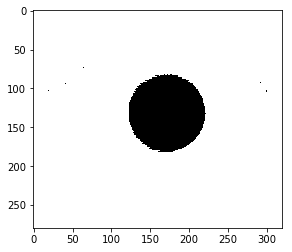

./CASIA Iris Image Database (version 1.0)/038/2/038_2_4.bmp


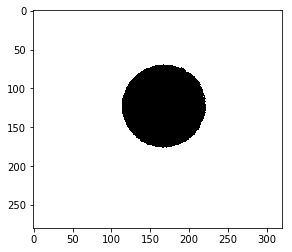

./CASIA Iris Image Database (version 1.0)/039/2/039_2_1.bmp


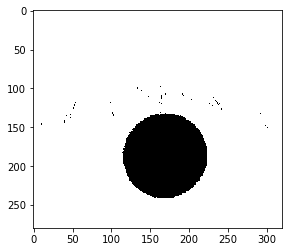

./CASIA Iris Image Database (version 1.0)/039/2/039_2_2.bmp


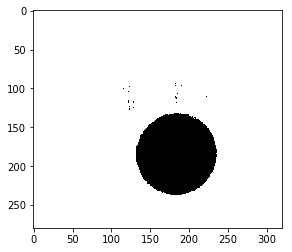

./CASIA Iris Image Database (version 1.0)/039/2/039_2_3.bmp


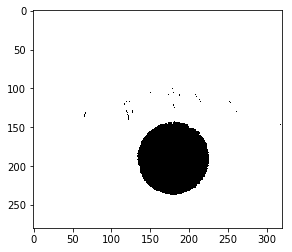

./CASIA Iris Image Database (version 1.0)/039/2/039_2_4.bmp


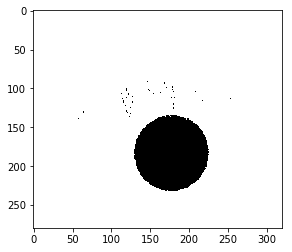

./CASIA Iris Image Database (version 1.0)/040/2/040_2_1.bmp


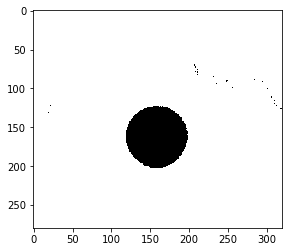

./CASIA Iris Image Database (version 1.0)/040/2/040_2_2.bmp


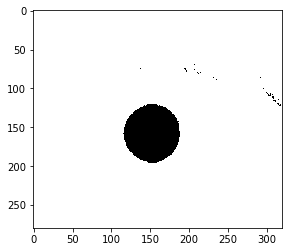

./CASIA Iris Image Database (version 1.0)/040/2/040_2_3.bmp


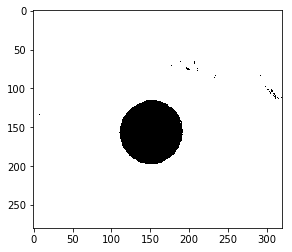

./CASIA Iris Image Database (version 1.0)/040/2/040_2_4.bmp


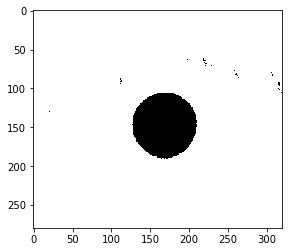

./CASIA Iris Image Database (version 1.0)/041/2/041_2_1.bmp


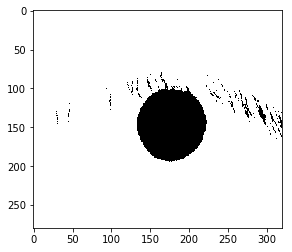

./CASIA Iris Image Database (version 1.0)/041/2/041_2_2.bmp


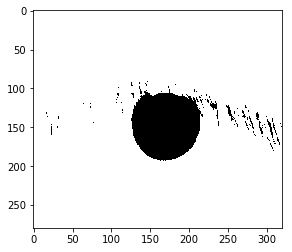

./CASIA Iris Image Database (version 1.0)/041/2/041_2_3.bmp


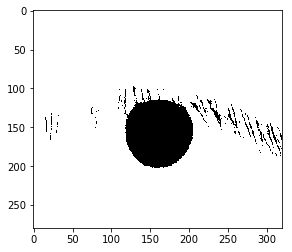

./CASIA Iris Image Database (version 1.0)/041/2/041_2_4.bmp


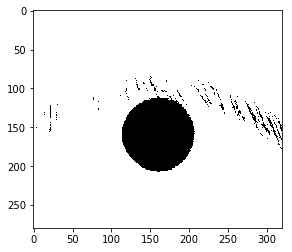

./CASIA Iris Image Database (version 1.0)/042/2/042_2_1.bmp


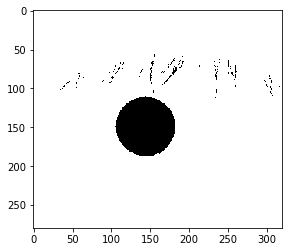

./CASIA Iris Image Database (version 1.0)/042/2/042_2_2.bmp


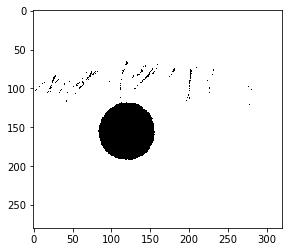

./CASIA Iris Image Database (version 1.0)/042/2/042_2_3.bmp


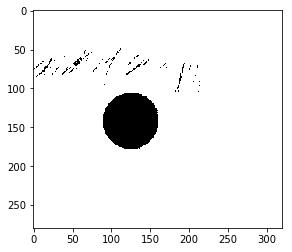

./CASIA Iris Image Database (version 1.0)/042/2/042_2_4.bmp


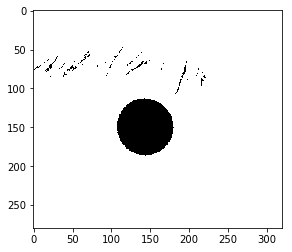

./CASIA Iris Image Database (version 1.0)/043/2/043_2_1.bmp


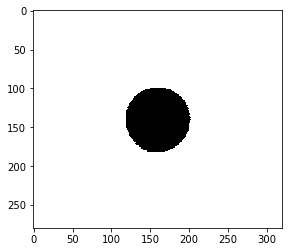

./CASIA Iris Image Database (version 1.0)/043/2/043_2_2.bmp


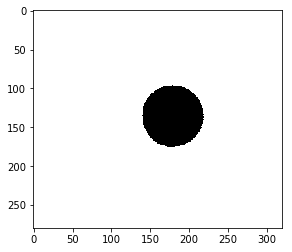

./CASIA Iris Image Database (version 1.0)/043/2/043_2_3.bmp


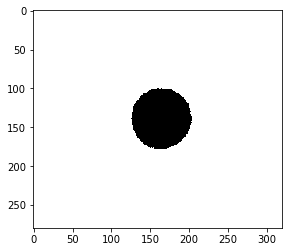

./CASIA Iris Image Database (version 1.0)/043/2/043_2_4.bmp


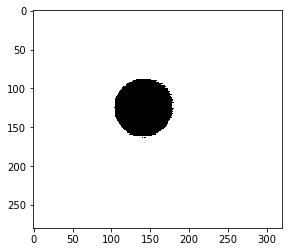

./CASIA Iris Image Database (version 1.0)/044/2/044_2_1.bmp


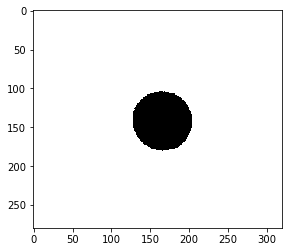

./CASIA Iris Image Database (version 1.0)/044/2/044_2_2.bmp


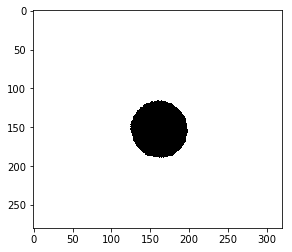

./CASIA Iris Image Database (version 1.0)/044/2/044_2_3.bmp


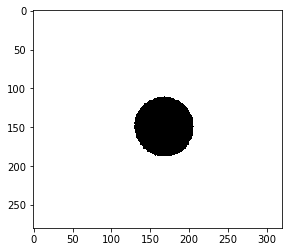

./CASIA Iris Image Database (version 1.0)/044/2/044_2_4.bmp


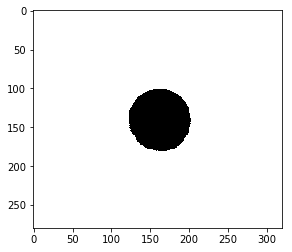

./CASIA Iris Image Database (version 1.0)/045/2/045_2_1.bmp


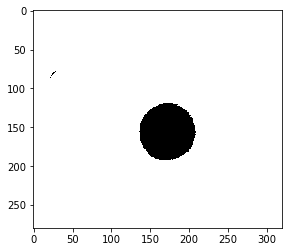

./CASIA Iris Image Database (version 1.0)/045/2/045_2_2.bmp


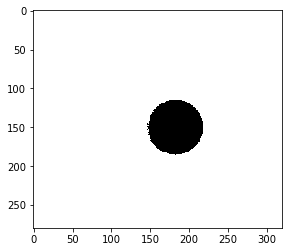

./CASIA Iris Image Database (version 1.0)/045/2/045_2_3.bmp


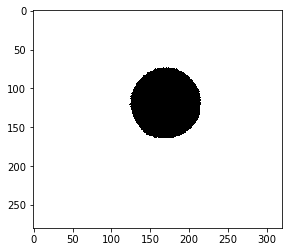

./CASIA Iris Image Database (version 1.0)/045/2/045_2_4.bmp


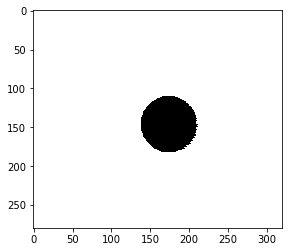

./CASIA Iris Image Database (version 1.0)/046/2/046_2_1.bmp


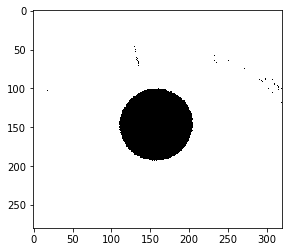

./CASIA Iris Image Database (version 1.0)/046/2/046_2_2.bmp


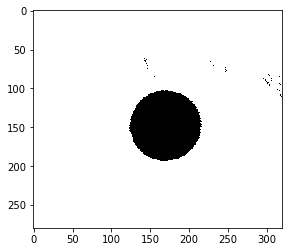

./CASIA Iris Image Database (version 1.0)/046/2/046_2_3.bmp


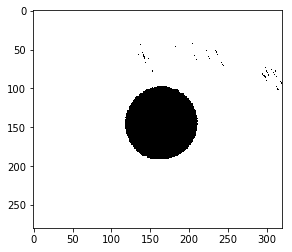

./CASIA Iris Image Database (version 1.0)/046/2/046_2_4.bmp


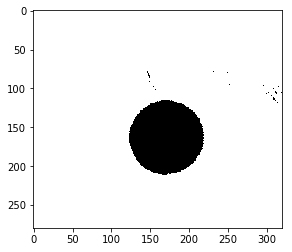

./CASIA Iris Image Database (version 1.0)/047/2/047_2_1.bmp


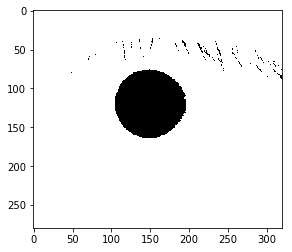

./CASIA Iris Image Database (version 1.0)/047/2/047_2_2.bmp


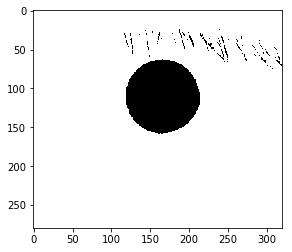

./CASIA Iris Image Database (version 1.0)/047/2/047_2_3.bmp


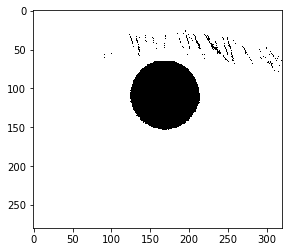

./CASIA Iris Image Database (version 1.0)/047/2/047_2_4.bmp


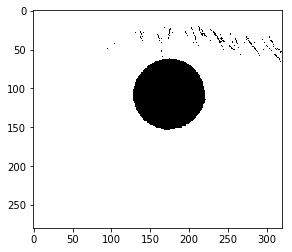

./CASIA Iris Image Database (version 1.0)/048/2/048_2_1.bmp


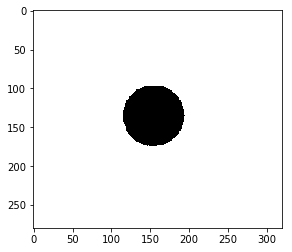

./CASIA Iris Image Database (version 1.0)/048/2/048_2_2.bmp


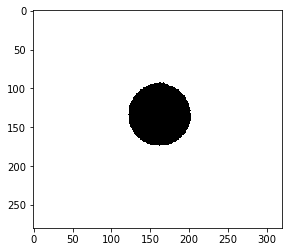

./CASIA Iris Image Database (version 1.0)/048/2/048_2_3.bmp


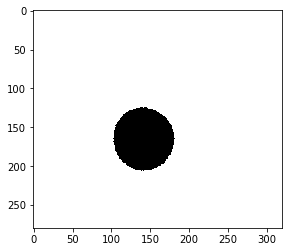

./CASIA Iris Image Database (version 1.0)/048/2/048_2_4.bmp


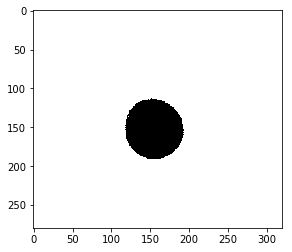

./CASIA Iris Image Database (version 1.0)/049/2/049_2_1.bmp


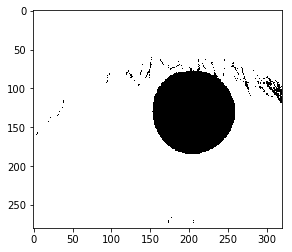

./CASIA Iris Image Database (version 1.0)/049/2/049_2_2.bmp


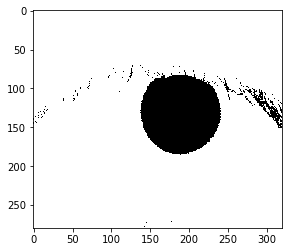

./CASIA Iris Image Database (version 1.0)/049/2/049_2_3.bmp


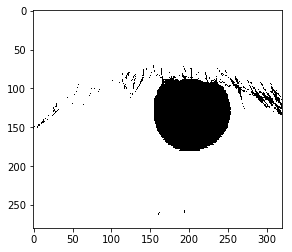

./CASIA Iris Image Database (version 1.0)/049/2/049_2_4.bmp


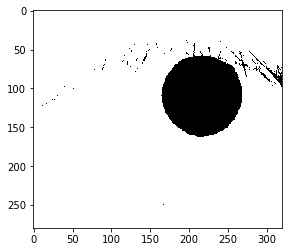

./CASIA Iris Image Database (version 1.0)/050/2/050_2_1.bmp


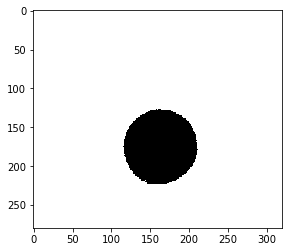

./CASIA Iris Image Database (version 1.0)/050/2/050_2_2.bmp


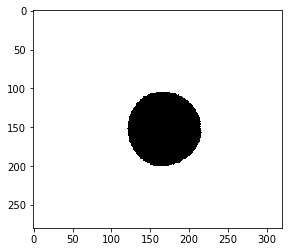

./CASIA Iris Image Database (version 1.0)/050/2/050_2_3.bmp


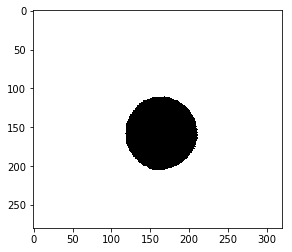

./CASIA Iris Image Database (version 1.0)/050/2/050_2_4.bmp


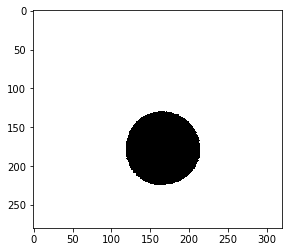

./CASIA Iris Image Database (version 1.0)/051/2/051_2_1.bmp


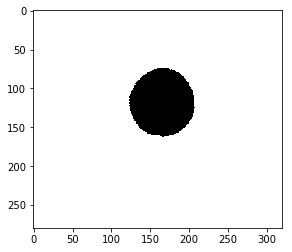

./CASIA Iris Image Database (version 1.0)/051/2/051_2_2.bmp


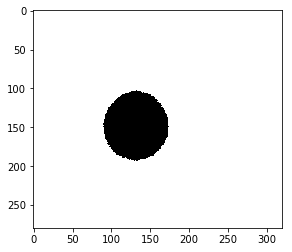

./CASIA Iris Image Database (version 1.0)/051/2/051_2_3.bmp


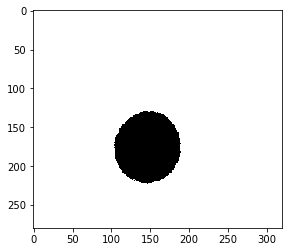

./CASIA Iris Image Database (version 1.0)/051/2/051_2_4.bmp


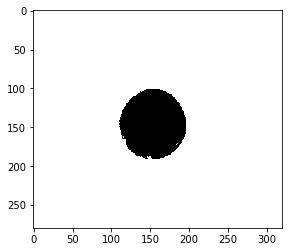

./CASIA Iris Image Database (version 1.0)/052/2/052_2_1.bmp


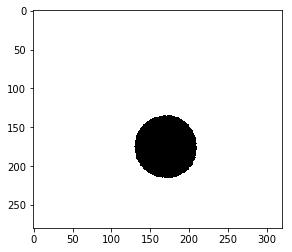

./CASIA Iris Image Database (version 1.0)/052/2/052_2_2.bmp


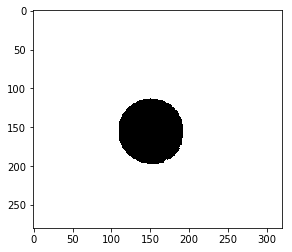

./CASIA Iris Image Database (version 1.0)/052/2/052_2_3.bmp


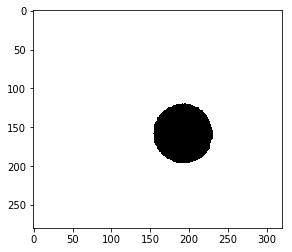

./CASIA Iris Image Database (version 1.0)/052/2/052_2_4.bmp


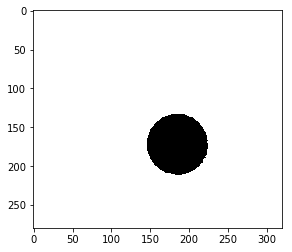

./CASIA Iris Image Database (version 1.0)/053/2/053_2_1.bmp


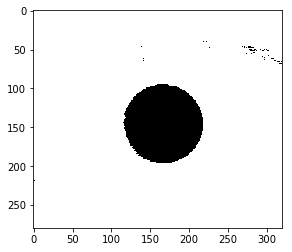

./CASIA Iris Image Database (version 1.0)/053/2/053_2_2.bmp


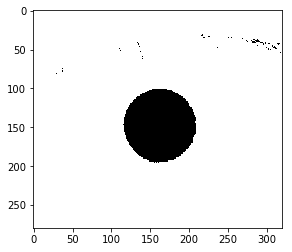

./CASIA Iris Image Database (version 1.0)/053/2/053_2_3.bmp


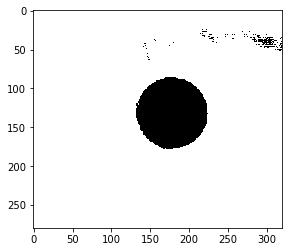

./CASIA Iris Image Database (version 1.0)/053/2/053_2_4.bmp


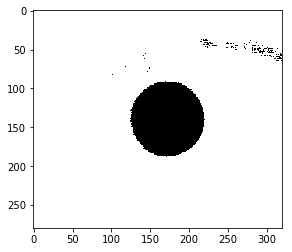

./CASIA Iris Image Database (version 1.0)/054/2/054_2_1.bmp


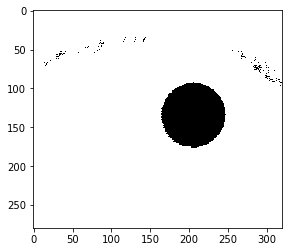

./CASIA Iris Image Database (version 1.0)/054/2/054_2_2.bmp


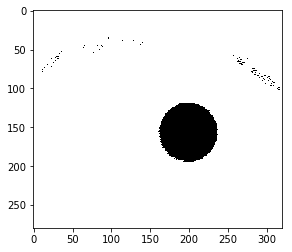

./CASIA Iris Image Database (version 1.0)/054/2/054_2_3.bmp


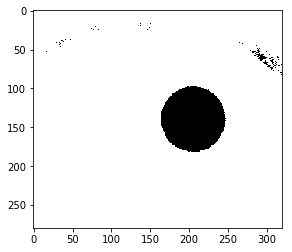

./CASIA Iris Image Database (version 1.0)/054/2/054_2_4.bmp


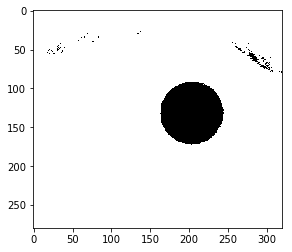

./CASIA Iris Image Database (version 1.0)/055/2/055_2_1.bmp


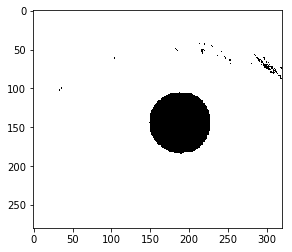

./CASIA Iris Image Database (version 1.0)/055/2/055_2_2.bmp


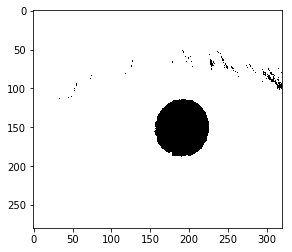

./CASIA Iris Image Database (version 1.0)/055/2/055_2_3.bmp


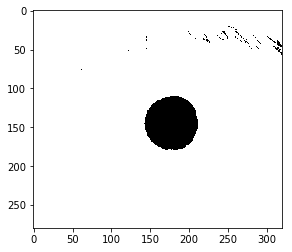

./CASIA Iris Image Database (version 1.0)/055/2/055_2_4.bmp


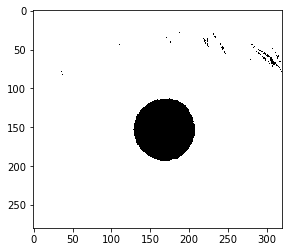

./CASIA Iris Image Database (version 1.0)/056/2/056_2_1.bmp


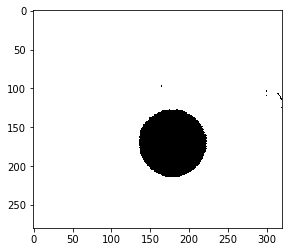

./CASIA Iris Image Database (version 1.0)/056/2/056_2_2.bmp


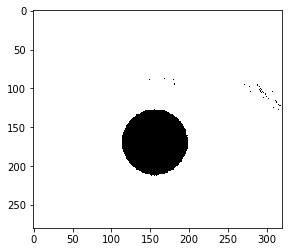

./CASIA Iris Image Database (version 1.0)/056/2/056_2_3.bmp


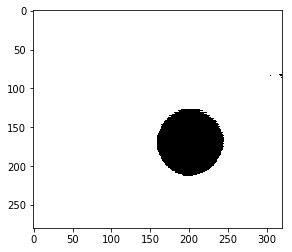

./CASIA Iris Image Database (version 1.0)/056/2/056_2_4.bmp


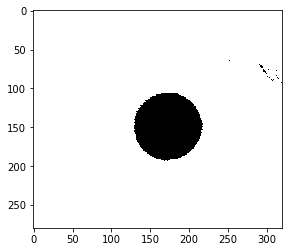

./CASIA Iris Image Database (version 1.0)/057/2/057_2_1.bmp


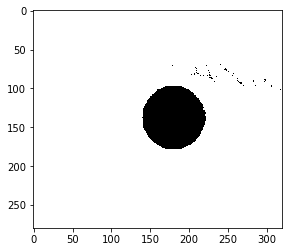

./CASIA Iris Image Database (version 1.0)/057/2/057_2_2.bmp


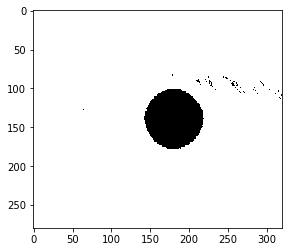

./CASIA Iris Image Database (version 1.0)/057/2/057_2_3.bmp


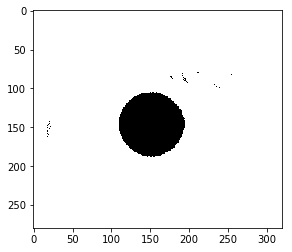

./CASIA Iris Image Database (version 1.0)/057/2/057_2_4.bmp


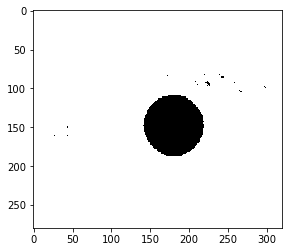

./CASIA Iris Image Database (version 1.0)/058/2/058_2_1.bmp


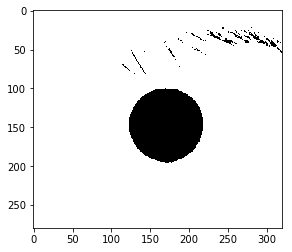

./CASIA Iris Image Database (version 1.0)/058/2/058_2_2.bmp


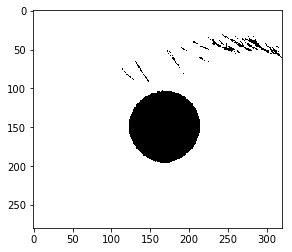

./CASIA Iris Image Database (version 1.0)/058/2/058_2_3.bmp


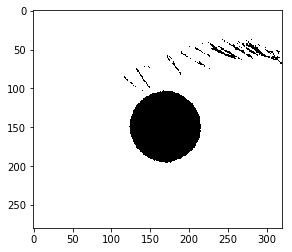

./CASIA Iris Image Database (version 1.0)/058/2/058_2_4.bmp


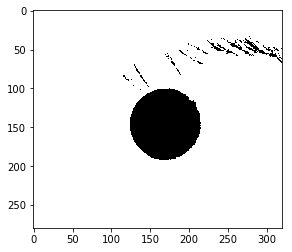

./CASIA Iris Image Database (version 1.0)/059/2/059_2_1.bmp


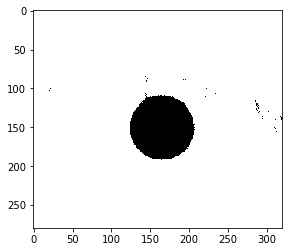

./CASIA Iris Image Database (version 1.0)/059/2/059_2_2.bmp


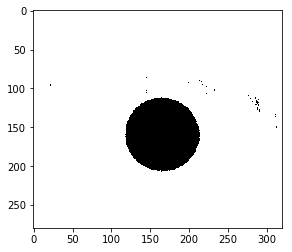

./CASIA Iris Image Database (version 1.0)/059/2/059_2_3.bmp


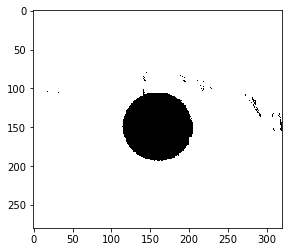

./CASIA Iris Image Database (version 1.0)/059/2/059_2_4.bmp


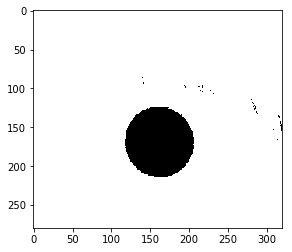

./CASIA Iris Image Database (version 1.0)/060/2/060_2_1.bmp


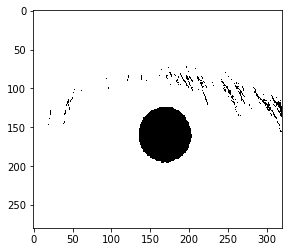

./CASIA Iris Image Database (version 1.0)/060/2/060_2_2.bmp


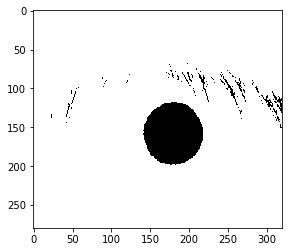

./CASIA Iris Image Database (version 1.0)/060/2/060_2_3.bmp


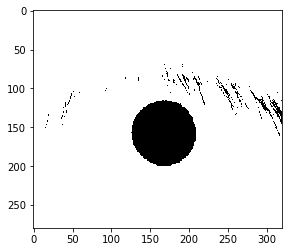

./CASIA Iris Image Database (version 1.0)/060/2/060_2_4.bmp


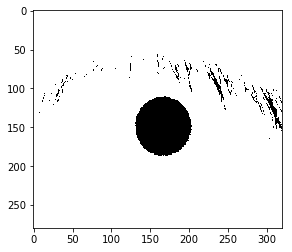

./CASIA Iris Image Database (version 1.0)/061/2/061_2_1.bmp


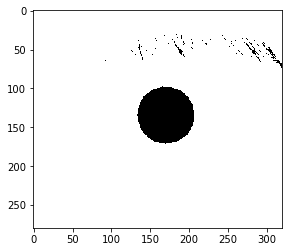

./CASIA Iris Image Database (version 1.0)/061/2/061_2_2.bmp


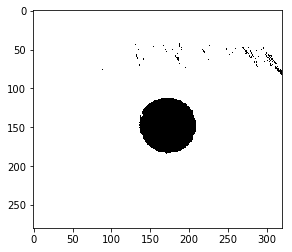

./CASIA Iris Image Database (version 1.0)/061/2/061_2_3.bmp


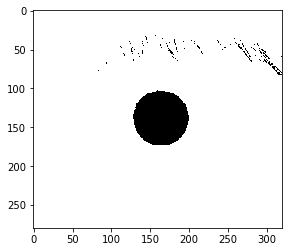

./CASIA Iris Image Database (version 1.0)/061/2/061_2_4.bmp


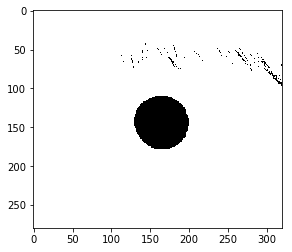

./CASIA Iris Image Database (version 1.0)/062/2/062_2_1.bmp


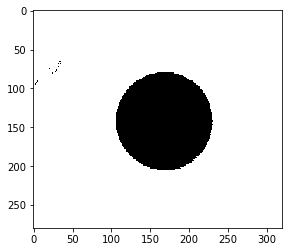

./CASIA Iris Image Database (version 1.0)/062/2/062_2_2.bmp


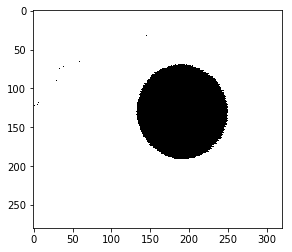

./CASIA Iris Image Database (version 1.0)/062/2/062_2_3.bmp


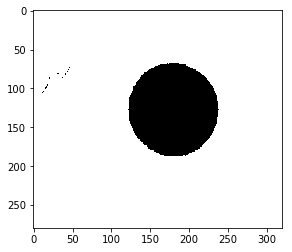

./CASIA Iris Image Database (version 1.0)/062/2/062_2_4.bmp


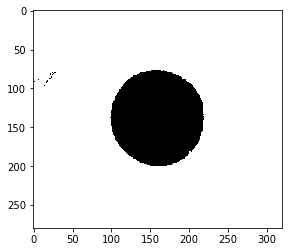

./CASIA Iris Image Database (version 1.0)/063/2/063_2_1.bmp


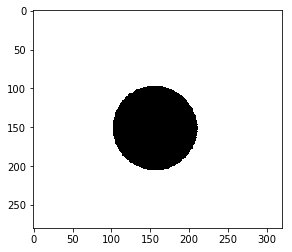

./CASIA Iris Image Database (version 1.0)/063/2/063_2_2.bmp


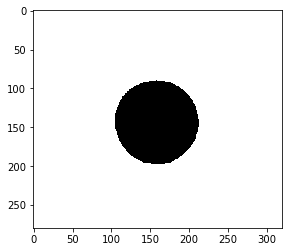

./CASIA Iris Image Database (version 1.0)/063/2/063_2_3.bmp


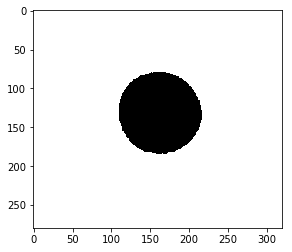

./CASIA Iris Image Database (version 1.0)/063/2/063_2_4.bmp


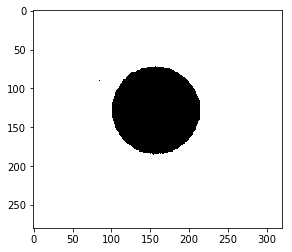

./CASIA Iris Image Database (version 1.0)/064/2/064_2_1.bmp


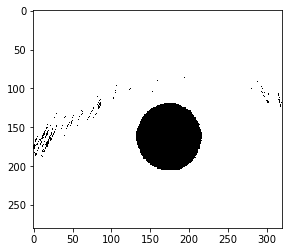

./CASIA Iris Image Database (version 1.0)/064/2/064_2_2.bmp


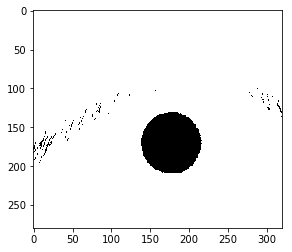

./CASIA Iris Image Database (version 1.0)/064/2/064_2_3.bmp


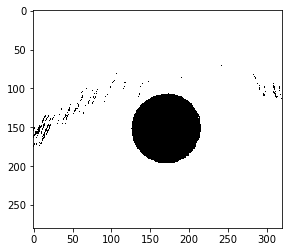

./CASIA Iris Image Database (version 1.0)/064/2/064_2_4.bmp


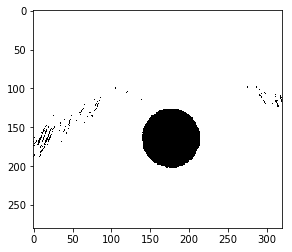

./CASIA Iris Image Database (version 1.0)/065/2/065_2_1.bmp


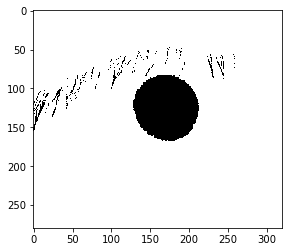

./CASIA Iris Image Database (version 1.0)/065/2/065_2_2.bmp


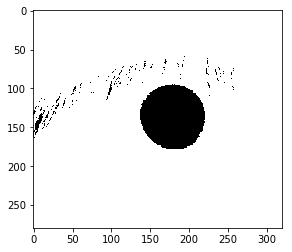

./CASIA Iris Image Database (version 1.0)/065/2/065_2_3.bmp


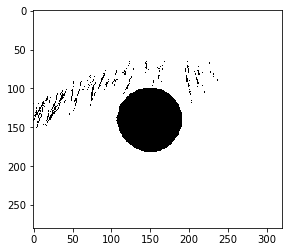

./CASIA Iris Image Database (version 1.0)/065/2/065_2_4.bmp


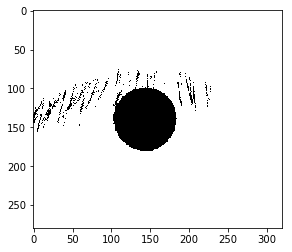

./CASIA Iris Image Database (version 1.0)/066/2/066_2_1.bmp


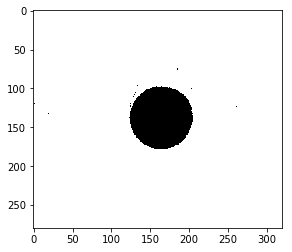

./CASIA Iris Image Database (version 1.0)/066/2/066_2_2.bmp


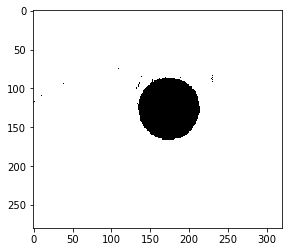

./CASIA Iris Image Database (version 1.0)/066/2/066_2_3.bmp


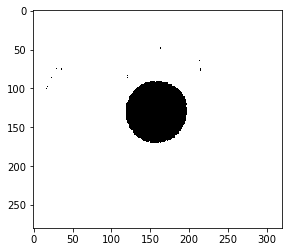

./CASIA Iris Image Database (version 1.0)/066/2/066_2_4.bmp


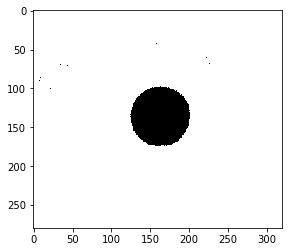

./CASIA Iris Image Database (version 1.0)/067/2/067_2_1.bmp


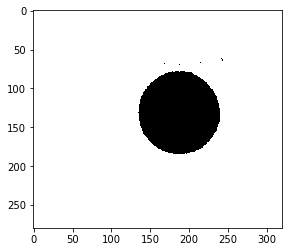

./CASIA Iris Image Database (version 1.0)/067/2/067_2_2.bmp


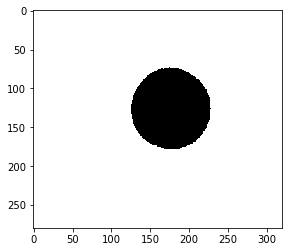

./CASIA Iris Image Database (version 1.0)/067/2/067_2_3.bmp


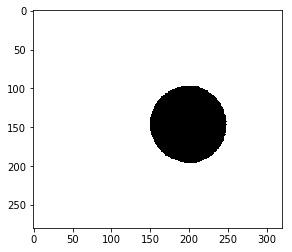

./CASIA Iris Image Database (version 1.0)/067/2/067_2_4.bmp


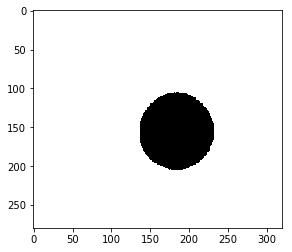

./CASIA Iris Image Database (version 1.0)/068/2/068_2_1.bmp


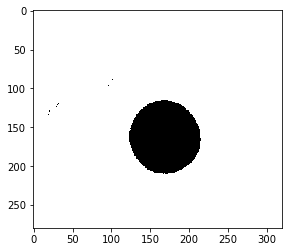

./CASIA Iris Image Database (version 1.0)/068/2/068_2_2.bmp


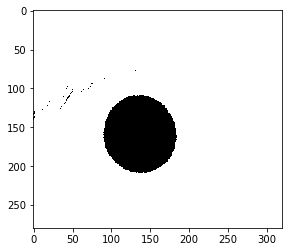

./CASIA Iris Image Database (version 1.0)/068/2/068_2_3.bmp


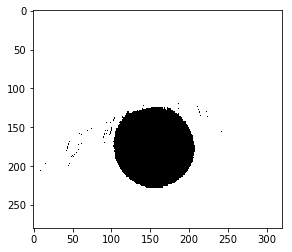

./CASIA Iris Image Database (version 1.0)/068/2/068_2_4.bmp


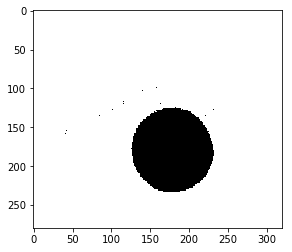

./CASIA Iris Image Database (version 1.0)/069/2/069_2_1.bmp


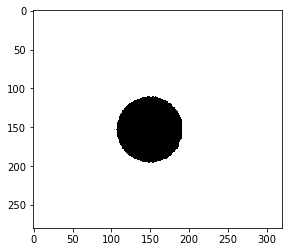

./CASIA Iris Image Database (version 1.0)/069/2/069_2_2.bmp


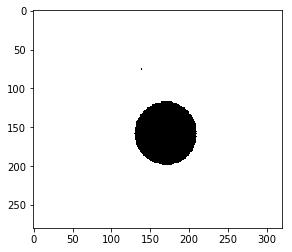

./CASIA Iris Image Database (version 1.0)/069/2/069_2_3.bmp


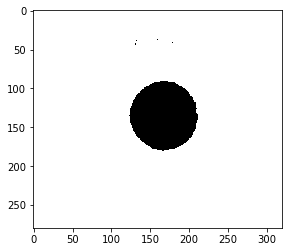

./CASIA Iris Image Database (version 1.0)/069/2/069_2_4.bmp


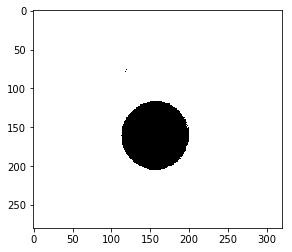

./CASIA Iris Image Database (version 1.0)/070/2/070_2_1.bmp


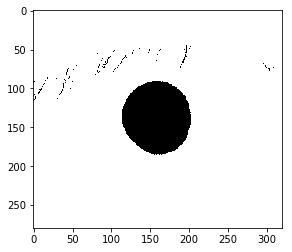

./CASIA Iris Image Database (version 1.0)/070/2/070_2_2.bmp


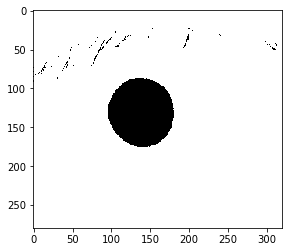

./CASIA Iris Image Database (version 1.0)/070/2/070_2_3.bmp


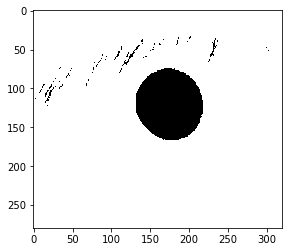

./CASIA Iris Image Database (version 1.0)/070/2/070_2_4.bmp


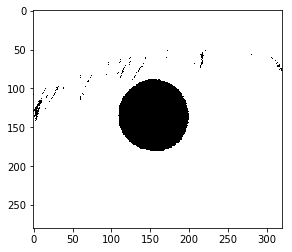

./CASIA Iris Image Database (version 1.0)/071/2/071_2_1.bmp


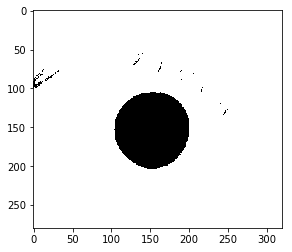

./CASIA Iris Image Database (version 1.0)/071/2/071_2_2.bmp


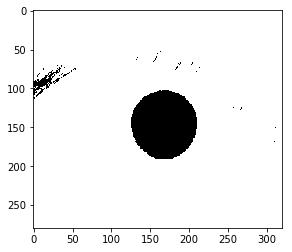

./CASIA Iris Image Database (version 1.0)/071/2/071_2_3.bmp


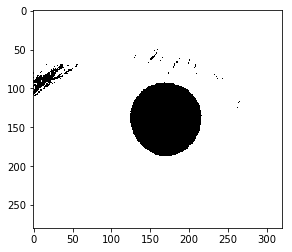

./CASIA Iris Image Database (version 1.0)/071/2/071_2_4.bmp


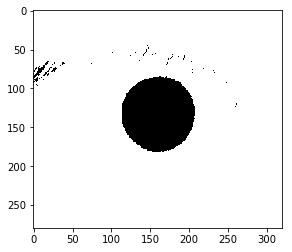

./CASIA Iris Image Database (version 1.0)/072/2/072_2_1.bmp


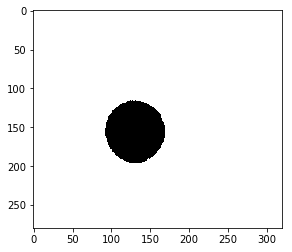

./CASIA Iris Image Database (version 1.0)/072/2/072_2_2.bmp


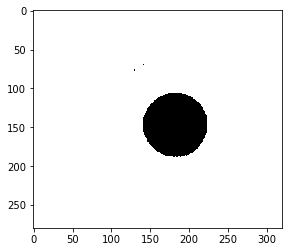

./CASIA Iris Image Database (version 1.0)/072/2/072_2_3.bmp


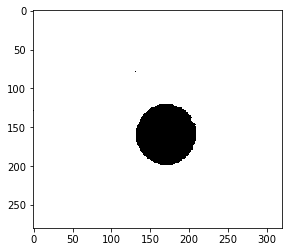

./CASIA Iris Image Database (version 1.0)/072/2/072_2_4.bmp


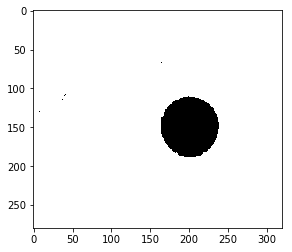

./CASIA Iris Image Database (version 1.0)/073/2/073_2_1.bmp


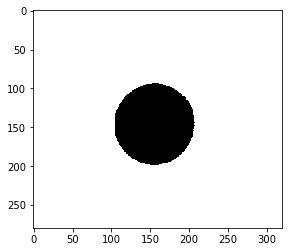

./CASIA Iris Image Database (version 1.0)/073/2/073_2_2.bmp


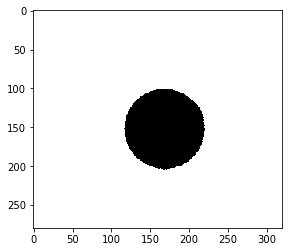

./CASIA Iris Image Database (version 1.0)/073/2/073_2_3.bmp


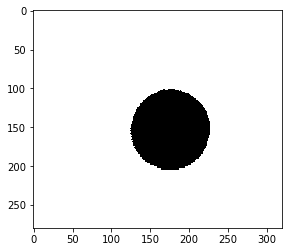

./CASIA Iris Image Database (version 1.0)/073/2/073_2_4.bmp


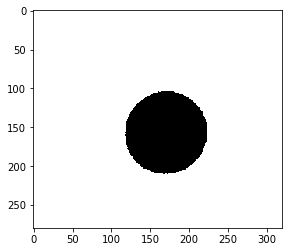

./CASIA Iris Image Database (version 1.0)/074/2/074_2_1.bmp


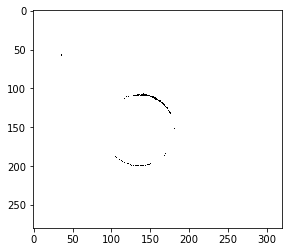

./CASIA Iris Image Database (version 1.0)/074/2/074_2_2.bmp


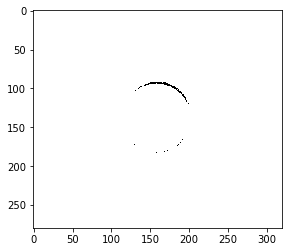

./CASIA Iris Image Database (version 1.0)/074/2/074_2_3.bmp


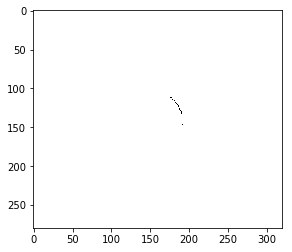

./CASIA Iris Image Database (version 1.0)/074/2/074_2_4.bmp


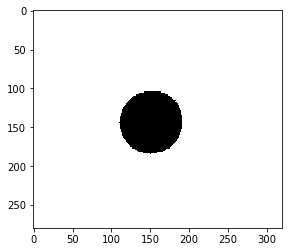

./CASIA Iris Image Database (version 1.0)/075/2/075_2_1.bmp


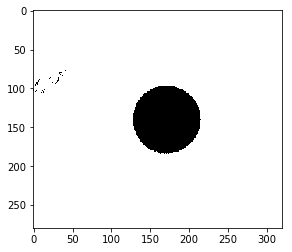

./CASIA Iris Image Database (version 1.0)/075/2/075_2_2.bmp


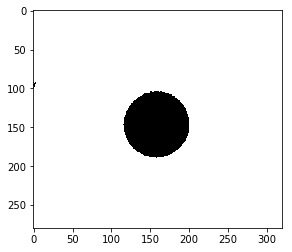

./CASIA Iris Image Database (version 1.0)/075/2/075_2_3.bmp


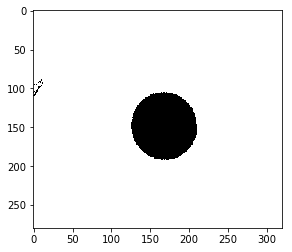

./CASIA Iris Image Database (version 1.0)/075/2/075_2_4.bmp


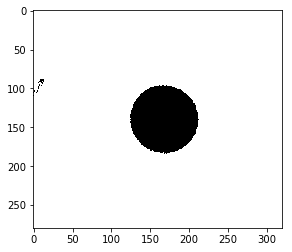

./CASIA Iris Image Database (version 1.0)/076/2/076_2_1.bmp


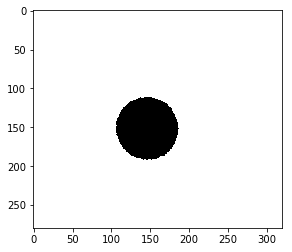

./CASIA Iris Image Database (version 1.0)/076/2/076_2_2.bmp


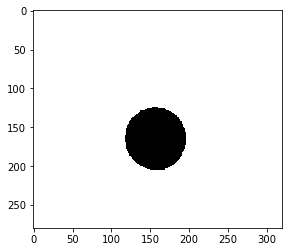

./CASIA Iris Image Database (version 1.0)/076/2/076_2_3.bmp


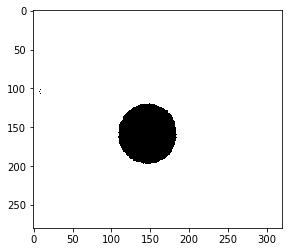

./CASIA Iris Image Database (version 1.0)/076/2/076_2_4.bmp


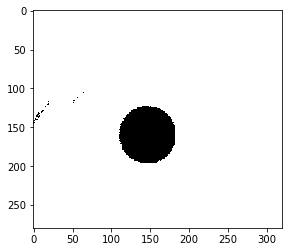

./CASIA Iris Image Database (version 1.0)/077/2/077_2_1.bmp


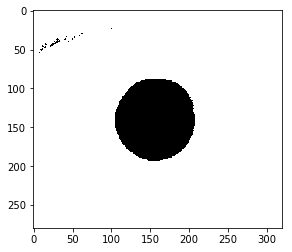

./CASIA Iris Image Database (version 1.0)/077/2/077_2_2.bmp


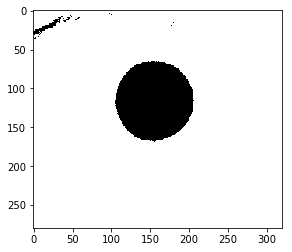

./CASIA Iris Image Database (version 1.0)/077/2/077_2_3.bmp


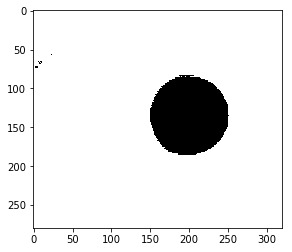

./CASIA Iris Image Database (version 1.0)/077/2/077_2_4.bmp


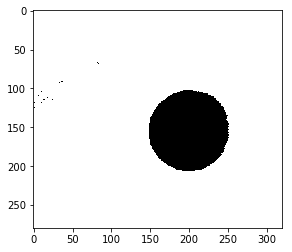

./CASIA Iris Image Database (version 1.0)/078/2/078_2_1.bmp


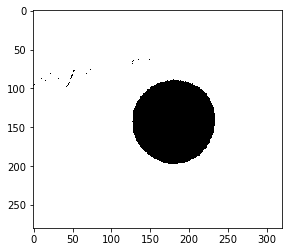

./CASIA Iris Image Database (version 1.0)/078/2/078_2_2.bmp


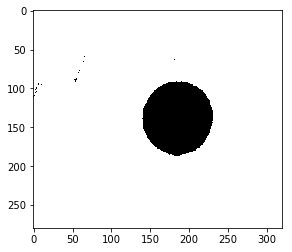

./CASIA Iris Image Database (version 1.0)/078/2/078_2_3.bmp


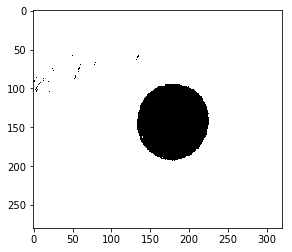

./CASIA Iris Image Database (version 1.0)/078/2/078_2_4.bmp


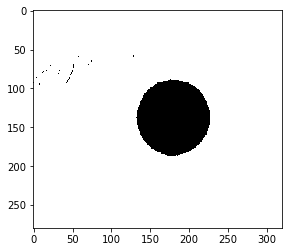

./CASIA Iris Image Database (version 1.0)/079/2/079_2_1.bmp


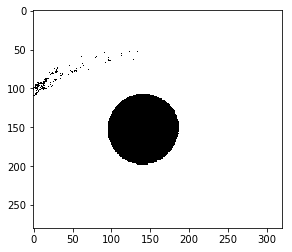

./CASIA Iris Image Database (version 1.0)/079/2/079_2_2.bmp


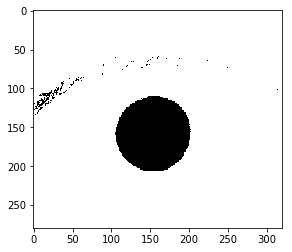

./CASIA Iris Image Database (version 1.0)/079/2/079_2_3.bmp


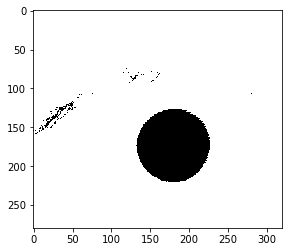

./CASIA Iris Image Database (version 1.0)/079/2/079_2_4.bmp


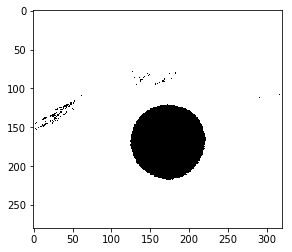

./CASIA Iris Image Database (version 1.0)/080/2/080_2_1.bmp


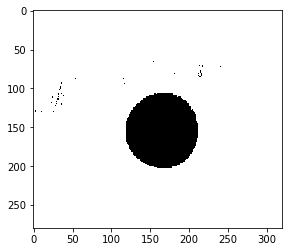

./CASIA Iris Image Database (version 1.0)/080/2/080_2_2.bmp


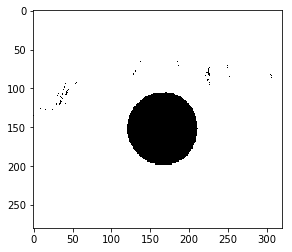

./CASIA Iris Image Database (version 1.0)/080/2/080_2_3.bmp


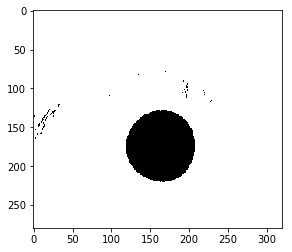

./CASIA Iris Image Database (version 1.0)/080/2/080_2_4.bmp


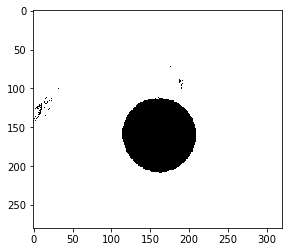

./CASIA Iris Image Database (version 1.0)/081/2/081_2_1.bmp


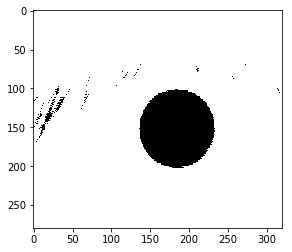

./CASIA Iris Image Database (version 1.0)/081/2/081_2_2.bmp


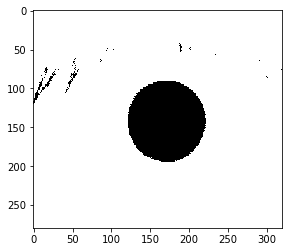

./CASIA Iris Image Database (version 1.0)/081/2/081_2_3.bmp


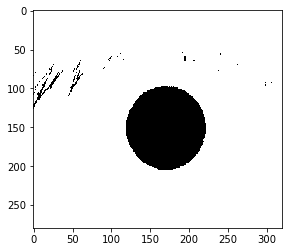

./CASIA Iris Image Database (version 1.0)/081/2/081_2_4.bmp


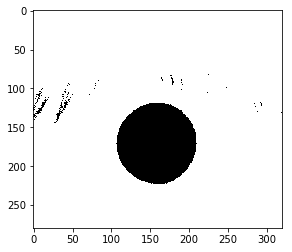

./CASIA Iris Image Database (version 1.0)/082/2/082_2_1.bmp


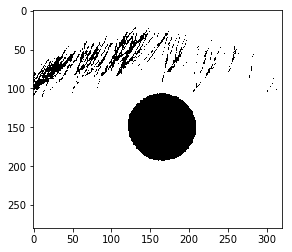

./CASIA Iris Image Database (version 1.0)/082/2/082_2_2.bmp


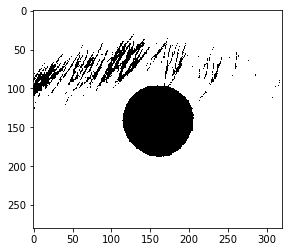

./CASIA Iris Image Database (version 1.0)/082/2/082_2_3.bmp


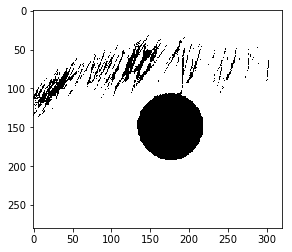

./CASIA Iris Image Database (version 1.0)/082/2/082_2_4.bmp


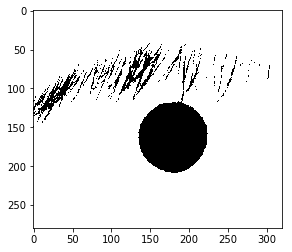

./CASIA Iris Image Database (version 1.0)/083/2/083_2_1.bmp


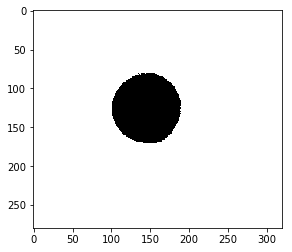

./CASIA Iris Image Database (version 1.0)/083/2/083_2_2.bmp


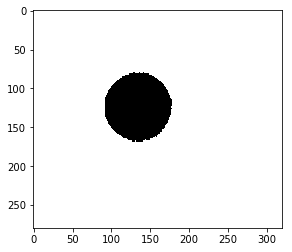

./CASIA Iris Image Database (version 1.0)/083/2/083_2_3.bmp


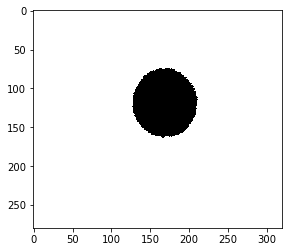

./CASIA Iris Image Database (version 1.0)/083/2/083_2_4.bmp


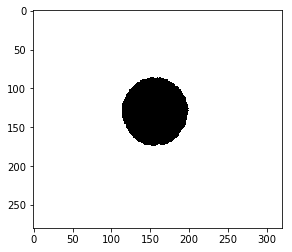

./CASIA Iris Image Database (version 1.0)/084/2/084_2_1.bmp


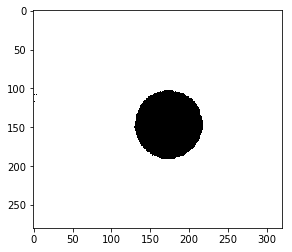

./CASIA Iris Image Database (version 1.0)/084/2/084_2_2.bmp


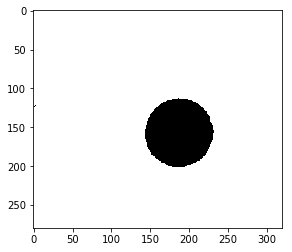

./CASIA Iris Image Database (version 1.0)/084/2/084_2_3.bmp


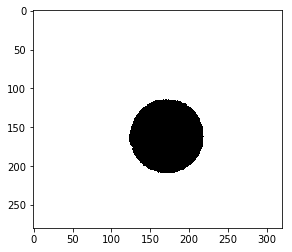

./CASIA Iris Image Database (version 1.0)/084/2/084_2_4.bmp


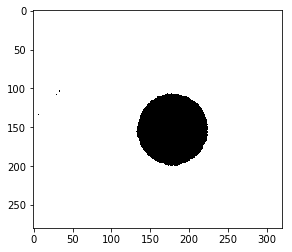

./CASIA Iris Image Database (version 1.0)/085/2/085_2_1.bmp


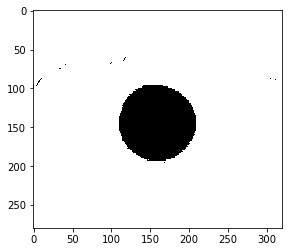

./CASIA Iris Image Database (version 1.0)/085/2/085_2_2.bmp


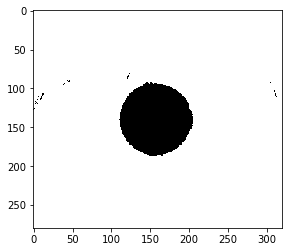

./CASIA Iris Image Database (version 1.0)/085/2/085_2_3.bmp


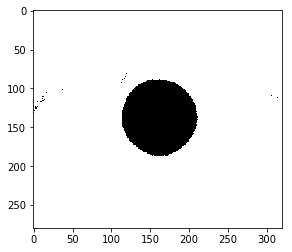

./CASIA Iris Image Database (version 1.0)/085/2/085_2_4.bmp


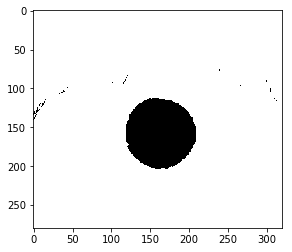

./CASIA Iris Image Database (version 1.0)/086/2/086_2_1.bmp


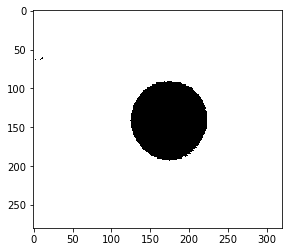

./CASIA Iris Image Database (version 1.0)/086/2/086_2_2.bmp


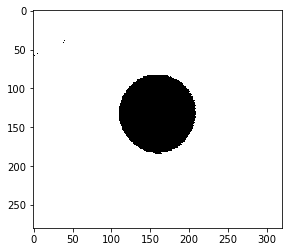

./CASIA Iris Image Database (version 1.0)/086/2/086_2_3.bmp


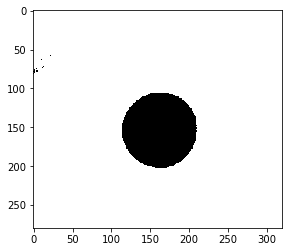

./CASIA Iris Image Database (version 1.0)/086/2/086_2_4.bmp


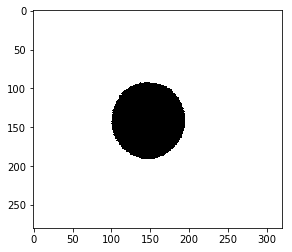

./CASIA Iris Image Database (version 1.0)/087/2/087_2_1.bmp


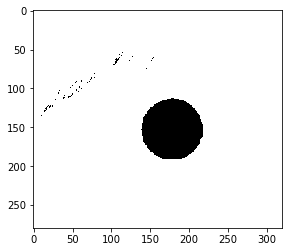

./CASIA Iris Image Database (version 1.0)/087/2/087_2_2.bmp


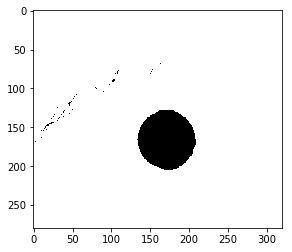

./CASIA Iris Image Database (version 1.0)/087/2/087_2_3.bmp


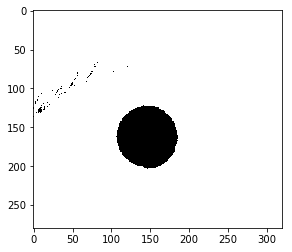

./CASIA Iris Image Database (version 1.0)/087/2/087_2_4.bmp


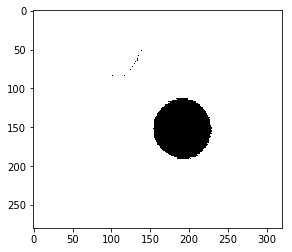

./CASIA Iris Image Database (version 1.0)/088/2/088_2_1.bmp


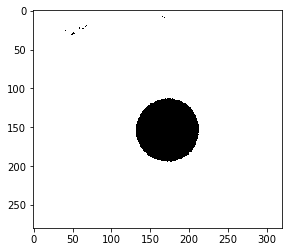

./CASIA Iris Image Database (version 1.0)/088/2/088_2_2.bmp


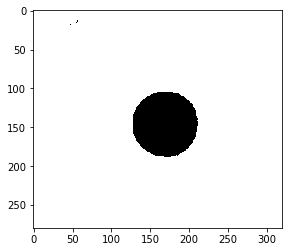

./CASIA Iris Image Database (version 1.0)/088/2/088_2_3.bmp


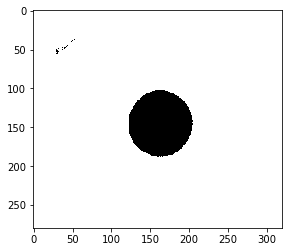

./CASIA Iris Image Database (version 1.0)/088/2/088_2_4.bmp


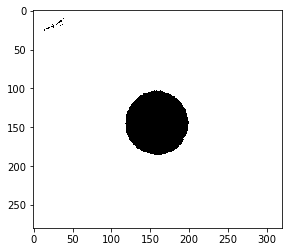

./CASIA Iris Image Database (version 1.0)/089/2/089_2_1.bmp


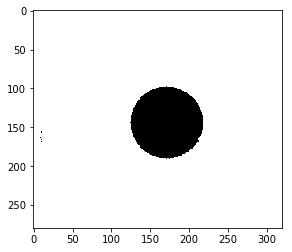

./CASIA Iris Image Database (version 1.0)/089/2/089_2_2.bmp


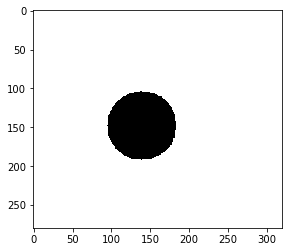

./CASIA Iris Image Database (version 1.0)/089/2/089_2_3.bmp


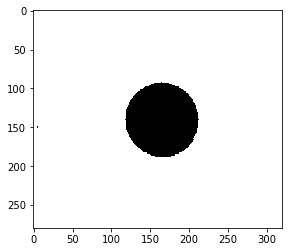

./CASIA Iris Image Database (version 1.0)/089/2/089_2_4.bmp


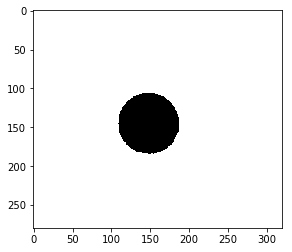

./CASIA Iris Image Database (version 1.0)/090/2/090_2_1.bmp


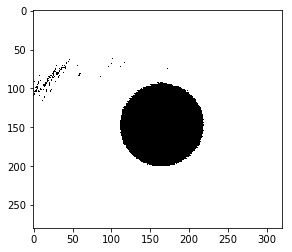

./CASIA Iris Image Database (version 1.0)/090/2/090_2_2.bmp


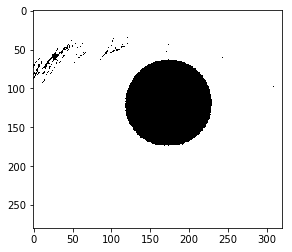

./CASIA Iris Image Database (version 1.0)/090/2/090_2_3.bmp


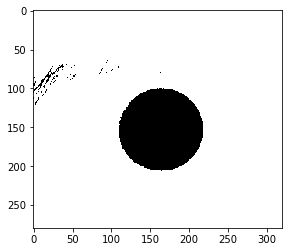

./CASIA Iris Image Database (version 1.0)/090/2/090_2_4.bmp


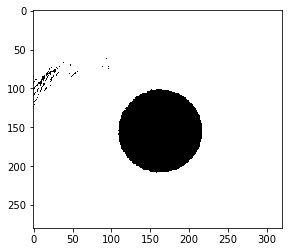

./CASIA Iris Image Database (version 1.0)/091/2/091_2_1.bmp


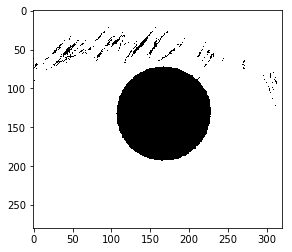

./CASIA Iris Image Database (version 1.0)/091/2/091_2_2.bmp


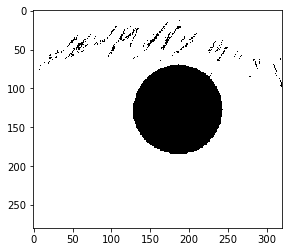

./CASIA Iris Image Database (version 1.0)/091/2/091_2_3.bmp


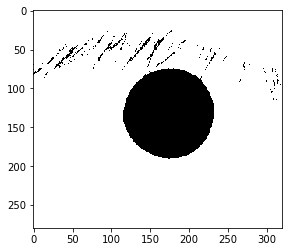

./CASIA Iris Image Database (version 1.0)/091/2/091_2_4.bmp


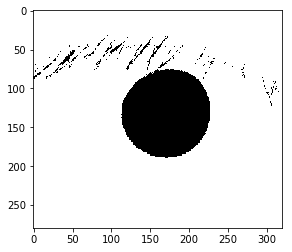

./CASIA Iris Image Database (version 1.0)/092/2/092_2_1.bmp


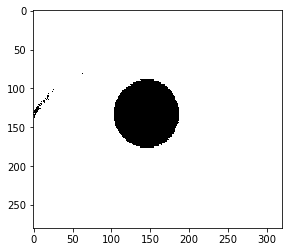

./CASIA Iris Image Database (version 1.0)/092/2/092_2_2.bmp


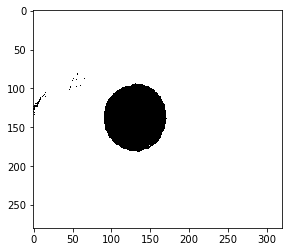

./CASIA Iris Image Database (version 1.0)/092/2/092_2_3.bmp


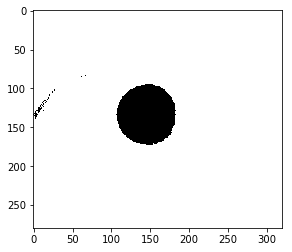

./CASIA Iris Image Database (version 1.0)/092/2/092_2_4.bmp


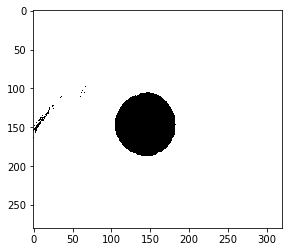

./CASIA Iris Image Database (version 1.0)/093/2/093_2_1.bmp


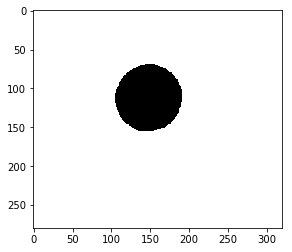

./CASIA Iris Image Database (version 1.0)/093/2/093_2_2.bmp


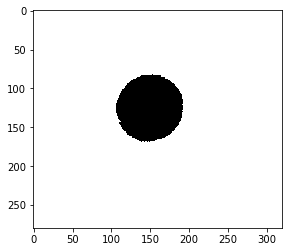

./CASIA Iris Image Database (version 1.0)/093/2/093_2_3.bmp


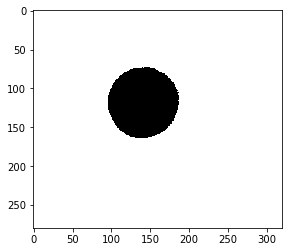

./CASIA Iris Image Database (version 1.0)/093/2/093_2_4.bmp


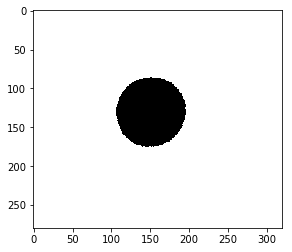

./CASIA Iris Image Database (version 1.0)/094/2/094_2_1.bmp


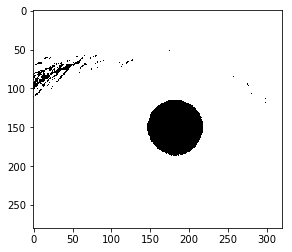

./CASIA Iris Image Database (version 1.0)/094/2/094_2_2.bmp


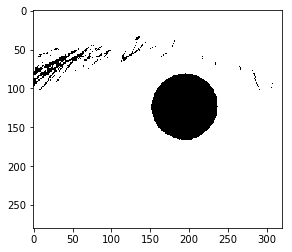

./CASIA Iris Image Database (version 1.0)/094/2/094_2_3.bmp


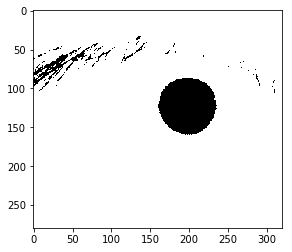

./CASIA Iris Image Database (version 1.0)/094/2/094_2_4.bmp


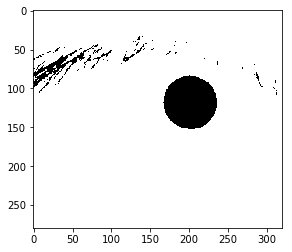

./CASIA Iris Image Database (version 1.0)/095/2/095_2_1.bmp


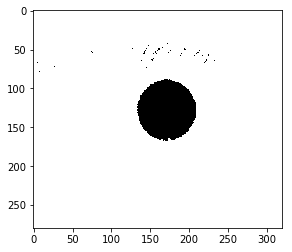

./CASIA Iris Image Database (version 1.0)/095/2/095_2_2.bmp


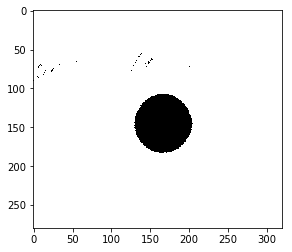

./CASIA Iris Image Database (version 1.0)/095/2/095_2_3.bmp


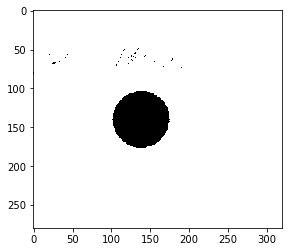

./CASIA Iris Image Database (version 1.0)/095/2/095_2_4.bmp


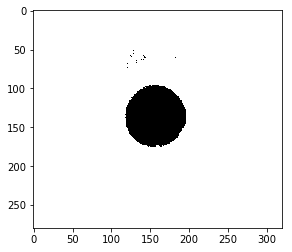

./CASIA Iris Image Database (version 1.0)/096/2/096_2_1.bmp


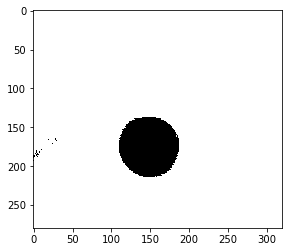

./CASIA Iris Image Database (version 1.0)/096/2/096_2_2.bmp


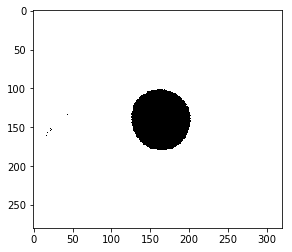

./CASIA Iris Image Database (version 1.0)/096/2/096_2_3.bmp


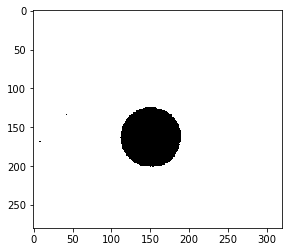

./CASIA Iris Image Database (version 1.0)/096/2/096_2_4.bmp


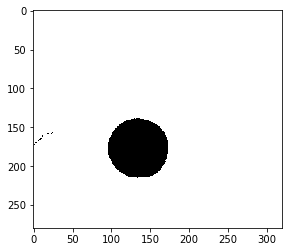

./CASIA Iris Image Database (version 1.0)/097/2/097_2_1.bmp


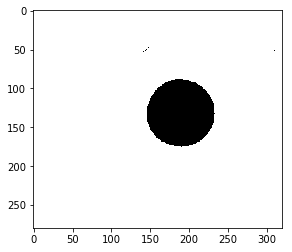

./CASIA Iris Image Database (version 1.0)/097/2/097_2_2.bmp


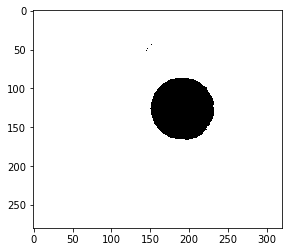

./CASIA Iris Image Database (version 1.0)/097/2/097_2_3.bmp


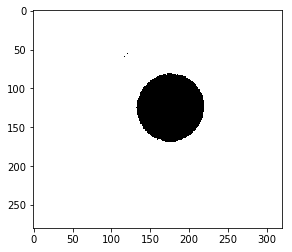

./CASIA Iris Image Database (version 1.0)/097/2/097_2_4.bmp


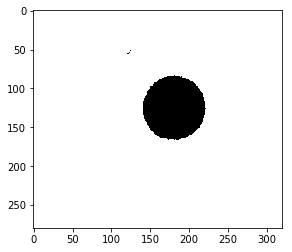

./CASIA Iris Image Database (version 1.0)/098/2/098_2_1.bmp


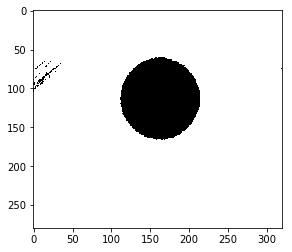

./CASIA Iris Image Database (version 1.0)/098/2/098_2_2.bmp


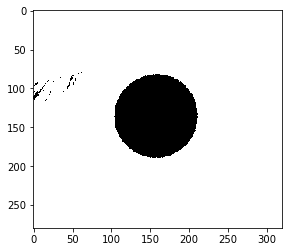

./CASIA Iris Image Database (version 1.0)/098/2/098_2_3.bmp


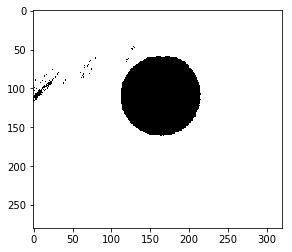

./CASIA Iris Image Database (version 1.0)/098/2/098_2_4.bmp


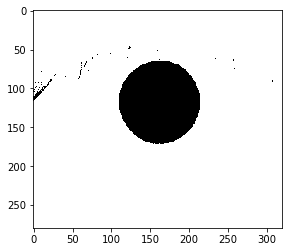

./CASIA Iris Image Database (version 1.0)/099/2/099_2_1.bmp


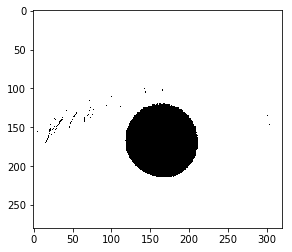

./CASIA Iris Image Database (version 1.0)/099/2/099_2_2.bmp


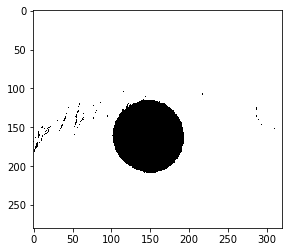

./CASIA Iris Image Database (version 1.0)/099/2/099_2_3.bmp


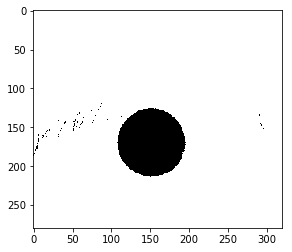

./CASIA Iris Image Database (version 1.0)/099/2/099_2_4.bmp


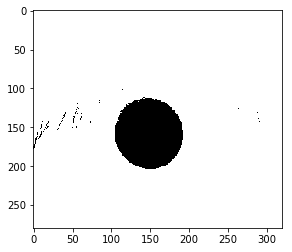

./CASIA Iris Image Database (version 1.0)/100/2/100_2_1.bmp


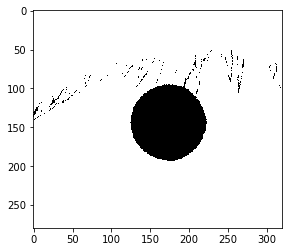

./CASIA Iris Image Database (version 1.0)/100/2/100_2_2.bmp


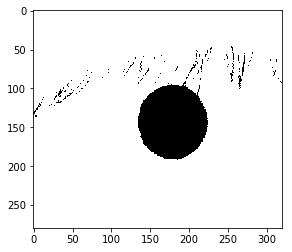

./CASIA Iris Image Database (version 1.0)/100/2/100_2_3.bmp


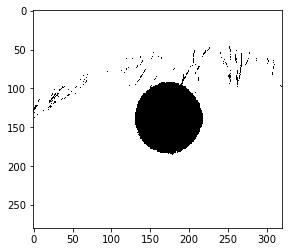

./CASIA Iris Image Database (version 1.0)/100/2/100_2_4.bmp


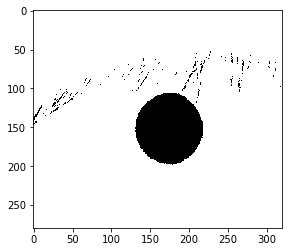

./CASIA Iris Image Database (version 1.0)/101/2/101_2_1.bmp


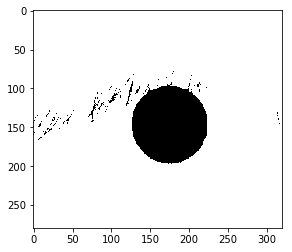

./CASIA Iris Image Database (version 1.0)/101/2/101_2_2.bmp


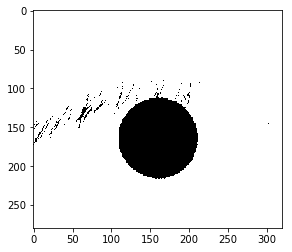

./CASIA Iris Image Database (version 1.0)/101/2/101_2_3.bmp


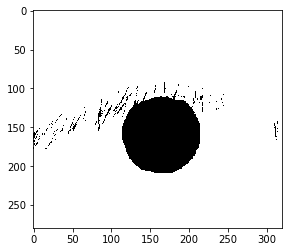

./CASIA Iris Image Database (version 1.0)/101/2/101_2_4.bmp


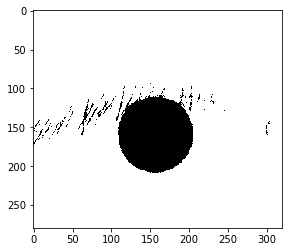

./CASIA Iris Image Database (version 1.0)/102/2/102_2_1.bmp


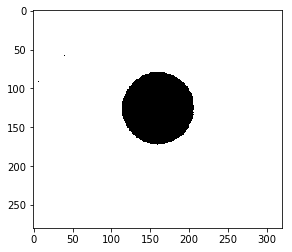

./CASIA Iris Image Database (version 1.0)/102/2/102_2_2.bmp


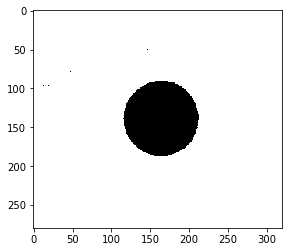

./CASIA Iris Image Database (version 1.0)/102/2/102_2_3.bmp


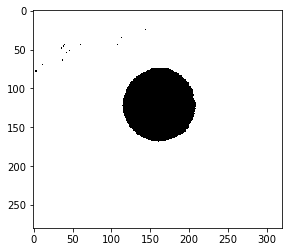

./CASIA Iris Image Database (version 1.0)/102/2/102_2_4.bmp


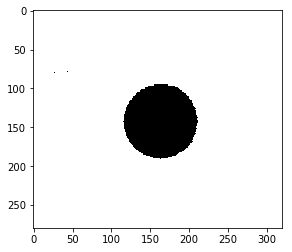

./CASIA Iris Image Database (version 1.0)/103/2/103_2_1.bmp


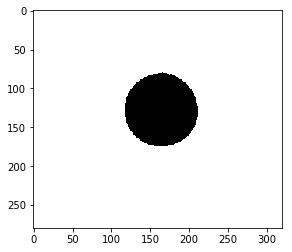

./CASIA Iris Image Database (version 1.0)/103/2/103_2_2.bmp


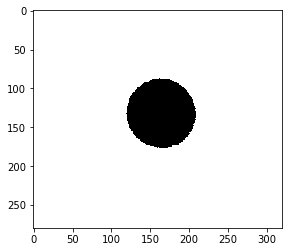

./CASIA Iris Image Database (version 1.0)/103/2/103_2_3.bmp


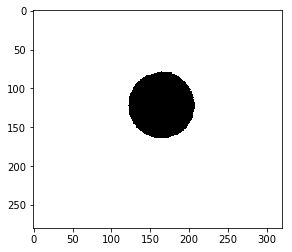

./CASIA Iris Image Database (version 1.0)/103/2/103_2_4.bmp


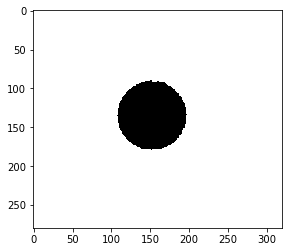

./CASIA Iris Image Database (version 1.0)/104/2/104_2_1.bmp


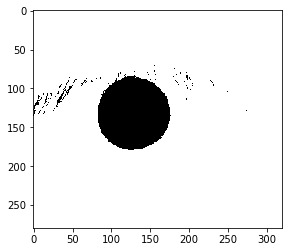

./CASIA Iris Image Database (version 1.0)/104/2/104_2_2.bmp


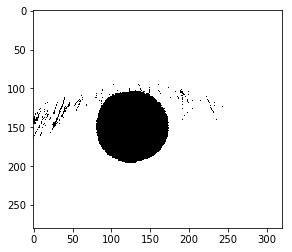

./CASIA Iris Image Database (version 1.0)/104/2/104_2_3.bmp


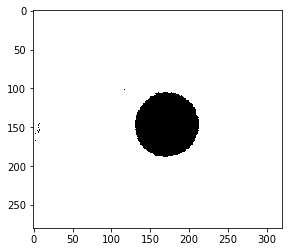

./CASIA Iris Image Database (version 1.0)/104/2/104_2_4.bmp


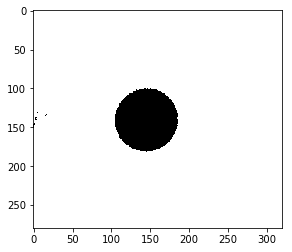

./CASIA Iris Image Database (version 1.0)/105/2/105_2_1.bmp


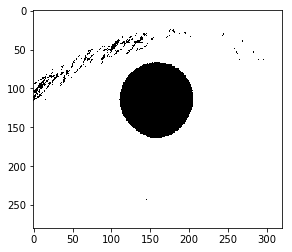

./CASIA Iris Image Database (version 1.0)/105/2/105_2_2.bmp


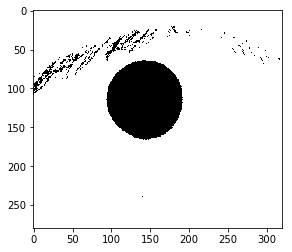

./CASIA Iris Image Database (version 1.0)/105/2/105_2_3.bmp


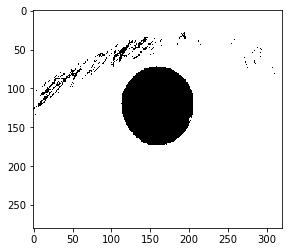

./CASIA Iris Image Database (version 1.0)/105/2/105_2_4.bmp


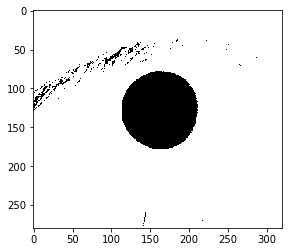

./CASIA Iris Image Database (version 1.0)/106/2/106_2_1.bmp


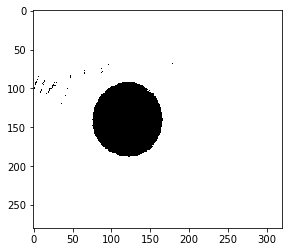

./CASIA Iris Image Database (version 1.0)/106/2/106_2_2.bmp


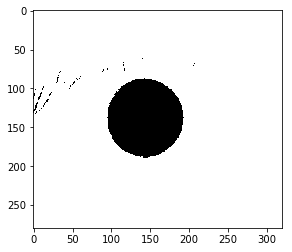

./CASIA Iris Image Database (version 1.0)/106/2/106_2_3.bmp


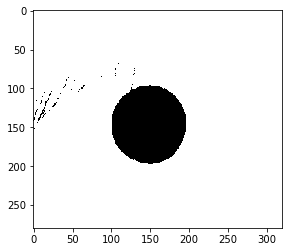

./CASIA Iris Image Database (version 1.0)/106/2/106_2_4.bmp


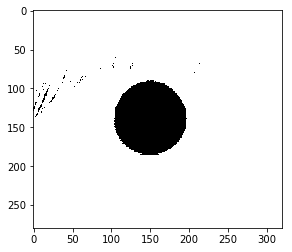

./CASIA Iris Image Database (version 1.0)/107/2/107_2_1.bmp


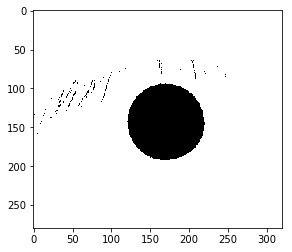

./CASIA Iris Image Database (version 1.0)/107/2/107_2_2.bmp


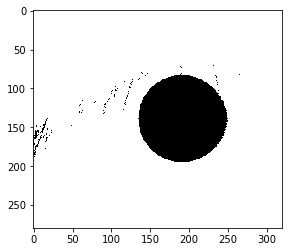

./CASIA Iris Image Database (version 1.0)/107/2/107_2_3.bmp


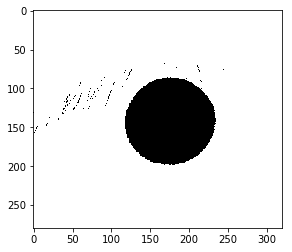

./CASIA Iris Image Database (version 1.0)/107/2/107_2_4.bmp


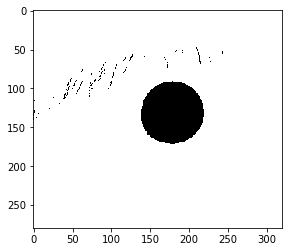

./CASIA Iris Image Database (version 1.0)/108/2/108_2_1.bmp


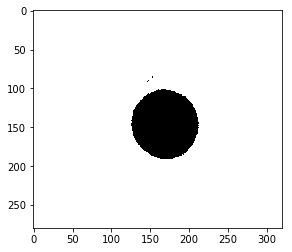

./CASIA Iris Image Database (version 1.0)/108/2/108_2_2.bmp


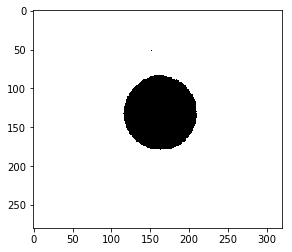

./CASIA Iris Image Database (version 1.0)/108/2/108_2_3.bmp


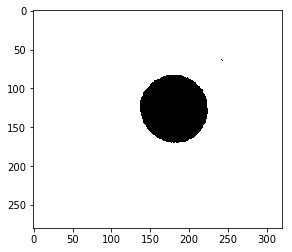

./CASIA Iris Image Database (version 1.0)/108/2/108_2_4.bmp


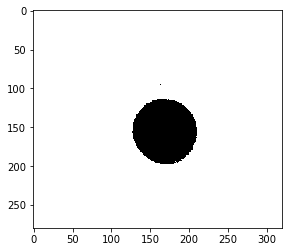

In [197]:
for i in range(0, len(fnames)):
    name = fnames[i]
    img0 = cv2.imread(name,0)
    ret, thresh = cv2.threshold(img0,62,65,cv2.THRESH_BINARY)
    print(name)
    plt.imshow(thresh, cmap = 'gray')
    plt.show()
    
    

./CASIA Iris Image Database (version 1.0)/001/1/001_1_1.bmp


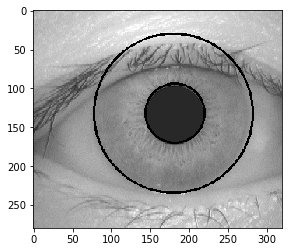

./CASIA Iris Image Database (version 1.0)/001/1/001_1_2.bmp


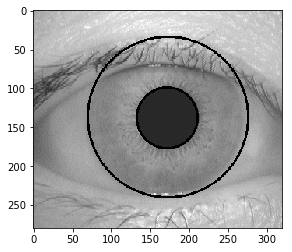

./CASIA Iris Image Database (version 1.0)/001/1/001_1_3.bmp


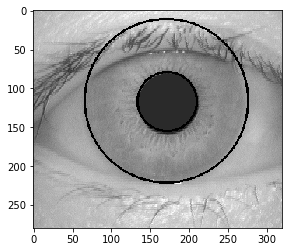

./CASIA Iris Image Database (version 1.0)/002/1/002_1_1.bmp


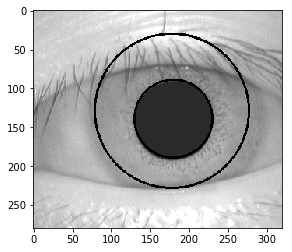

./CASIA Iris Image Database (version 1.0)/002/1/002_1_2.bmp


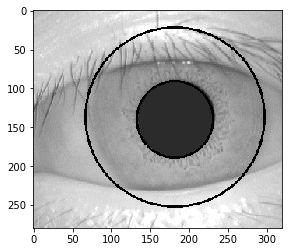

./CASIA Iris Image Database (version 1.0)/002/1/002_1_3.bmp


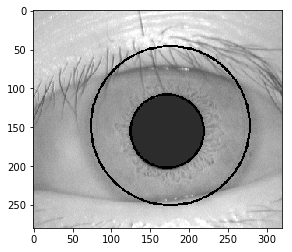

./CASIA Iris Image Database (version 1.0)/003/1/003_1_1.bmp


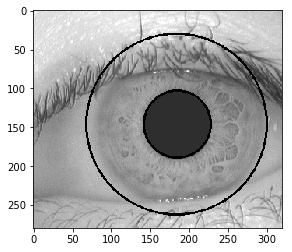

./CASIA Iris Image Database (version 1.0)/003/1/003_1_2.bmp


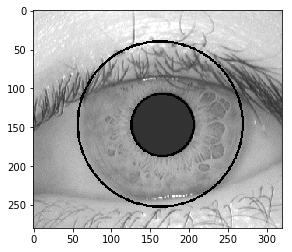

./CASIA Iris Image Database (version 1.0)/003/1/003_1_3.bmp


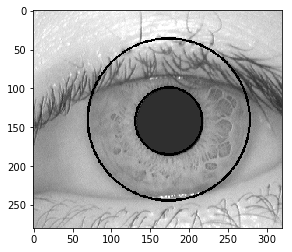

./CASIA Iris Image Database (version 1.0)/004/1/004_1_1.bmp


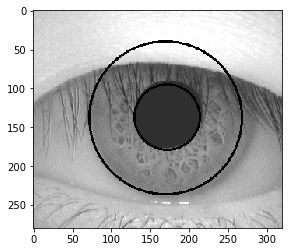

./CASIA Iris Image Database (version 1.0)/004/1/004_1_2.bmp


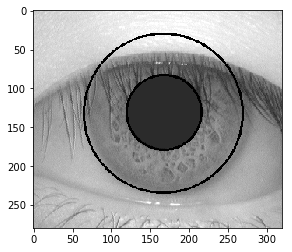

./CASIA Iris Image Database (version 1.0)/004/1/004_1_3.bmp


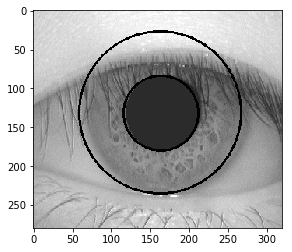

./CASIA Iris Image Database (version 1.0)/005/1/005_1_1.bmp


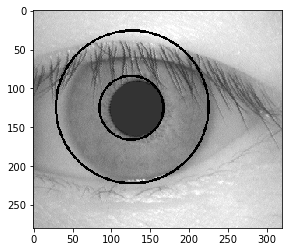

./CASIA Iris Image Database (version 1.0)/005/1/005_1_2.bmp


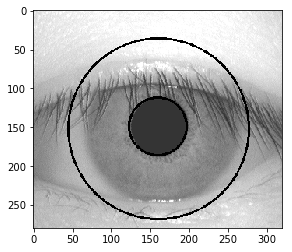

./CASIA Iris Image Database (version 1.0)/005/1/005_1_3.bmp


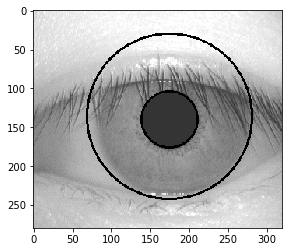

./CASIA Iris Image Database (version 1.0)/006/1/006_1_1.bmp


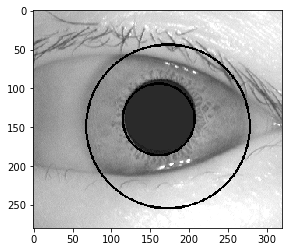

./CASIA Iris Image Database (version 1.0)/006/1/006_1_2.bmp


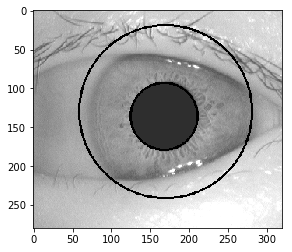

./CASIA Iris Image Database (version 1.0)/006/1/006_1_3.bmp


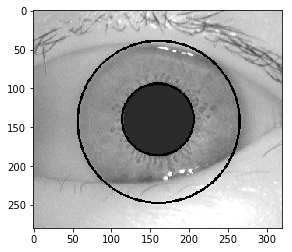

./CASIA Iris Image Database (version 1.0)/007/1/007_1_1.bmp


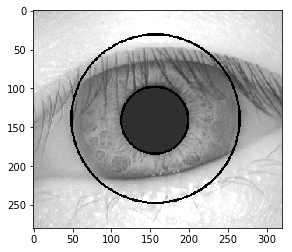

./CASIA Iris Image Database (version 1.0)/007/1/007_1_2.bmp


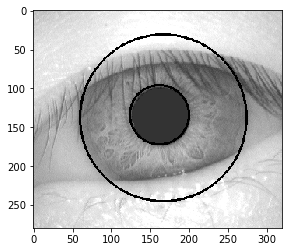

./CASIA Iris Image Database (version 1.0)/007/1/007_1_3.bmp


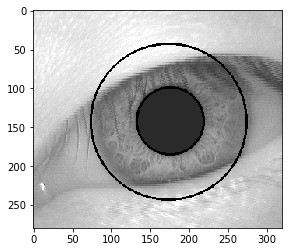

./CASIA Iris Image Database (version 1.0)/008/1/008_1_1.bmp


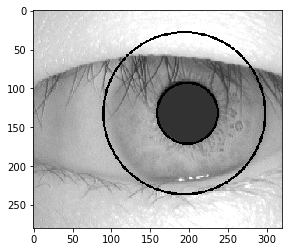

./CASIA Iris Image Database (version 1.0)/008/1/008_1_2.bmp


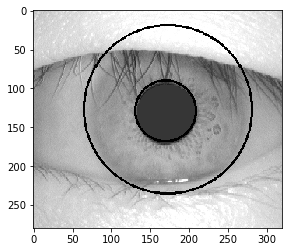

./CASIA Iris Image Database (version 1.0)/008/1/008_1_3.bmp


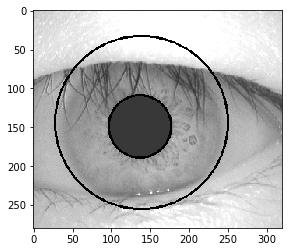

./CASIA Iris Image Database (version 1.0)/009/1/009_1_1.bmp


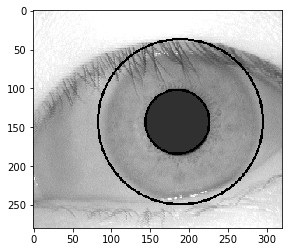

./CASIA Iris Image Database (version 1.0)/009/1/009_1_2.bmp


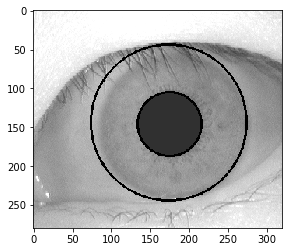

./CASIA Iris Image Database (version 1.0)/009/1/009_1_3.bmp


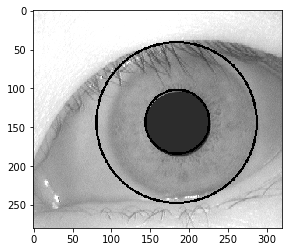

./CASIA Iris Image Database (version 1.0)/010/1/010_1_1.bmp


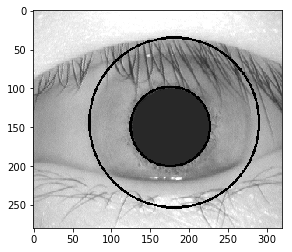

./CASIA Iris Image Database (version 1.0)/010/1/010_1_2.bmp


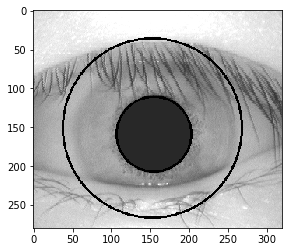

./CASIA Iris Image Database (version 1.0)/010/1/010_1_3.bmp


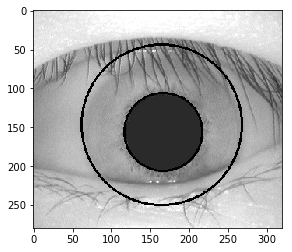

./CASIA Iris Image Database (version 1.0)/011/1/011_1_1.bmp


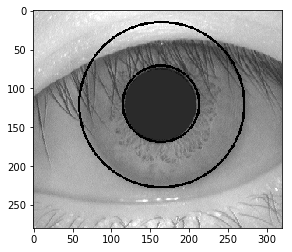

./CASIA Iris Image Database (version 1.0)/011/1/011_1_2.bmp


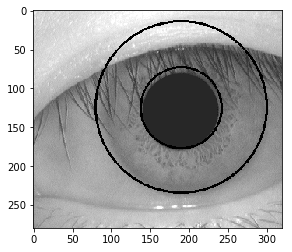

./CASIA Iris Image Database (version 1.0)/011/1/011_1_3.bmp


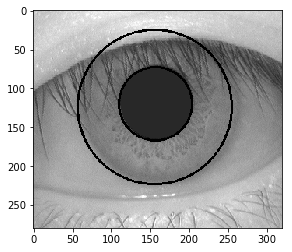

./CASIA Iris Image Database (version 1.0)/012/1/012_1_1.bmp


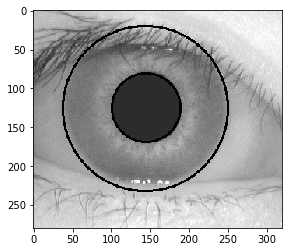

./CASIA Iris Image Database (version 1.0)/012/1/012_1_2.bmp


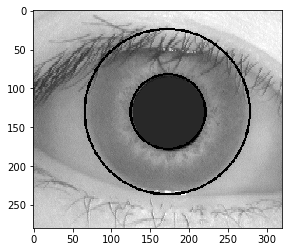

./CASIA Iris Image Database (version 1.0)/012/1/012_1_3.bmp


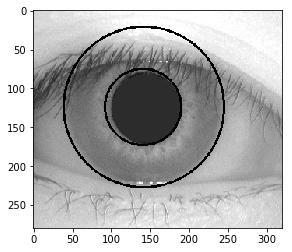

./CASIA Iris Image Database (version 1.0)/013/1/013_1_1.bmp


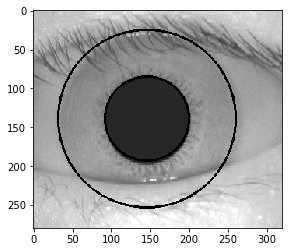

./CASIA Iris Image Database (version 1.0)/013/1/013_1_2.bmp


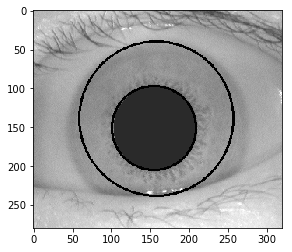

./CASIA Iris Image Database (version 1.0)/013/1/013_1_3.bmp


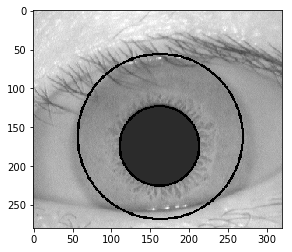

./CASIA Iris Image Database (version 1.0)/014/1/014_1_1.bmp


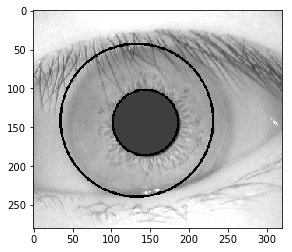

./CASIA Iris Image Database (version 1.0)/014/1/014_1_2.bmp


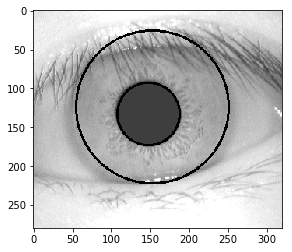

./CASIA Iris Image Database (version 1.0)/014/1/014_1_3.bmp


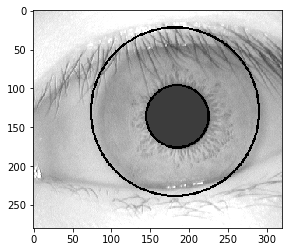

./CASIA Iris Image Database (version 1.0)/015/1/015_1_1.bmp


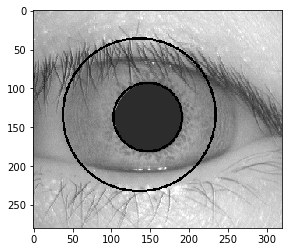

./CASIA Iris Image Database (version 1.0)/015/1/015_1_2.bmp


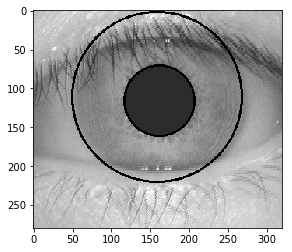

./CASIA Iris Image Database (version 1.0)/015/1/015_1_3.bmp


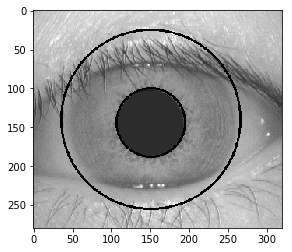

./CASIA Iris Image Database (version 1.0)/016/1/016_1_1.bmp


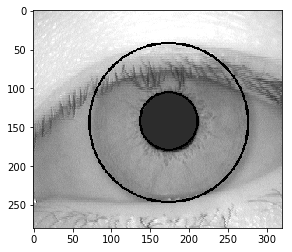

./CASIA Iris Image Database (version 1.0)/016/1/016_1_2.bmp


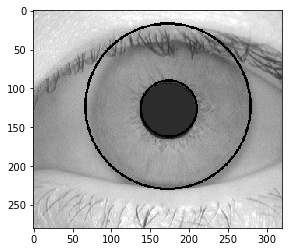

./CASIA Iris Image Database (version 1.0)/016/1/016_1_3.bmp


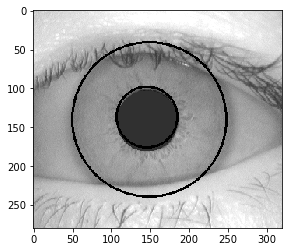

./CASIA Iris Image Database (version 1.0)/017/1/017_1_1.bmp


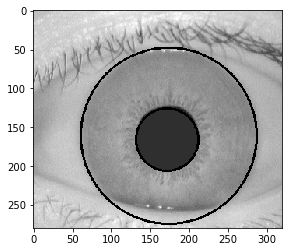

./CASIA Iris Image Database (version 1.0)/017/1/017_1_2.bmp


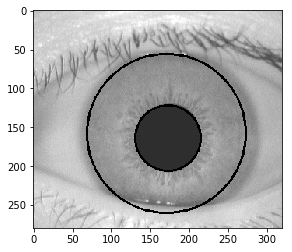

./CASIA Iris Image Database (version 1.0)/017/1/017_1_3.bmp


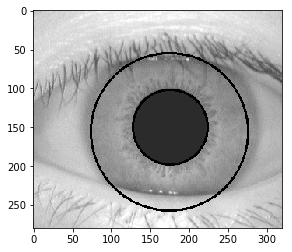

./CASIA Iris Image Database (version 1.0)/018/1/018_1_1.bmp


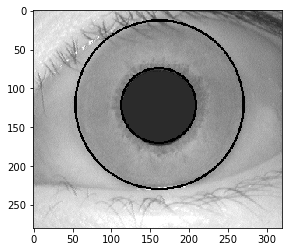

./CASIA Iris Image Database (version 1.0)/018/1/018_1_2.bmp


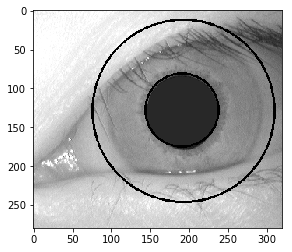

./CASIA Iris Image Database (version 1.0)/018/1/018_1_3.bmp


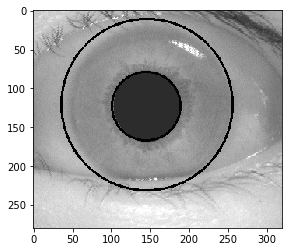

./CASIA Iris Image Database (version 1.0)/019/1/019_1_1.bmp


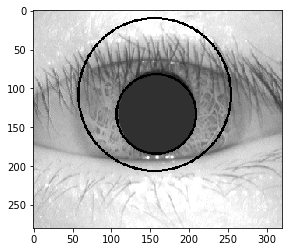

./CASIA Iris Image Database (version 1.0)/019/1/019_1_2.bmp


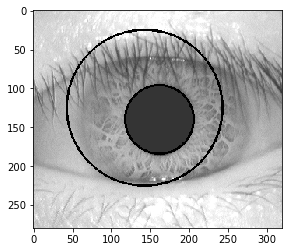

./CASIA Iris Image Database (version 1.0)/019/1/019_1_3.bmp


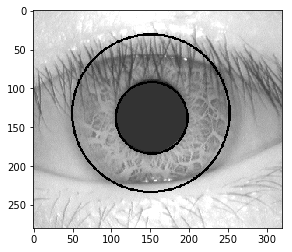

./CASIA Iris Image Database (version 1.0)/020/1/020_1_1.bmp


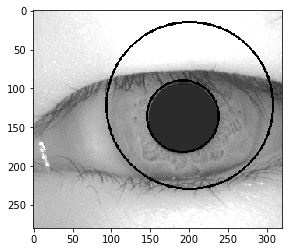

./CASIA Iris Image Database (version 1.0)/020/1/020_1_2.bmp


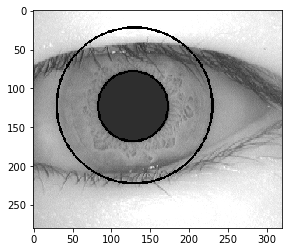

./CASIA Iris Image Database (version 1.0)/020/1/020_1_3.bmp


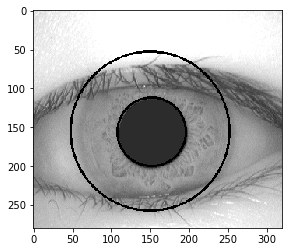

./CASIA Iris Image Database (version 1.0)/021/1/021_1_1.bmp


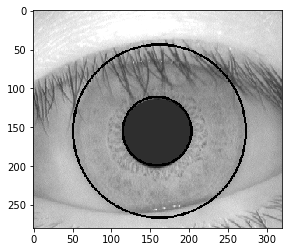

./CASIA Iris Image Database (version 1.0)/021/1/021_1_2.bmp


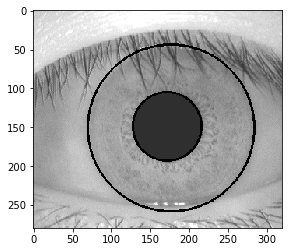

./CASIA Iris Image Database (version 1.0)/021/1/021_1_3.bmp


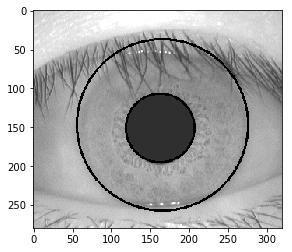

./CASIA Iris Image Database (version 1.0)/022/1/022_1_1.bmp


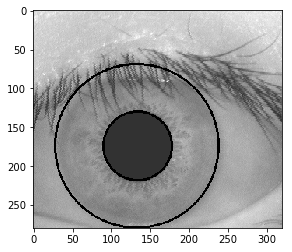

./CASIA Iris Image Database (version 1.0)/022/1/022_1_2.bmp


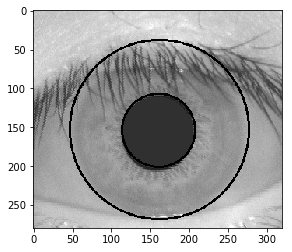

./CASIA Iris Image Database (version 1.0)/022/1/022_1_3.bmp


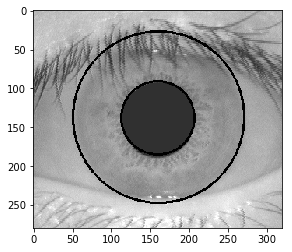

./CASIA Iris Image Database (version 1.0)/023/1/023_1_1.bmp


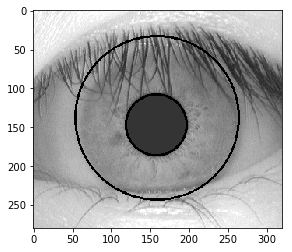

./CASIA Iris Image Database (version 1.0)/023/1/023_1_2.bmp


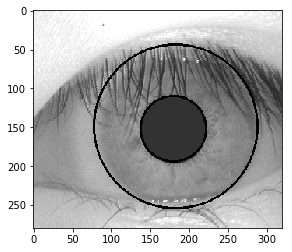

./CASIA Iris Image Database (version 1.0)/023/1/023_1_3.bmp


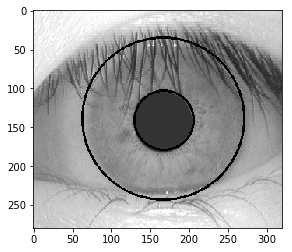

./CASIA Iris Image Database (version 1.0)/024/1/024_1_1.bmp


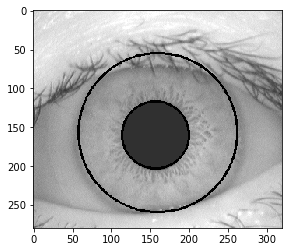

./CASIA Iris Image Database (version 1.0)/024/1/024_1_2.bmp


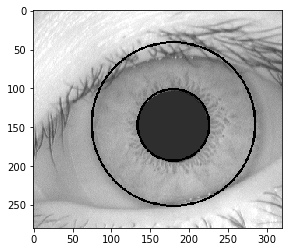

./CASIA Iris Image Database (version 1.0)/024/1/024_1_3.bmp


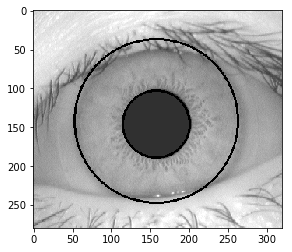

./CASIA Iris Image Database (version 1.0)/025/1/025_1_1.bmp


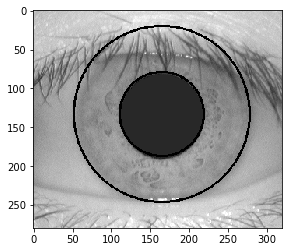

./CASIA Iris Image Database (version 1.0)/025/1/025_1_2.bmp


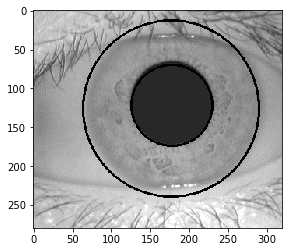

./CASIA Iris Image Database (version 1.0)/025/1/025_1_3.bmp


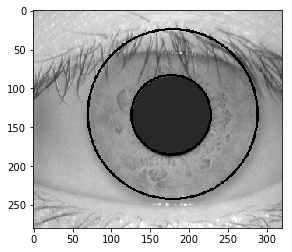

./CASIA Iris Image Database (version 1.0)/026/1/026_1_1.bmp


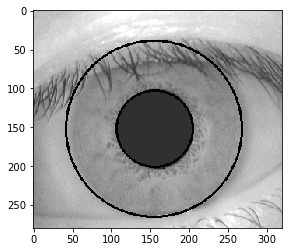

./CASIA Iris Image Database (version 1.0)/026/1/026_1_2.bmp


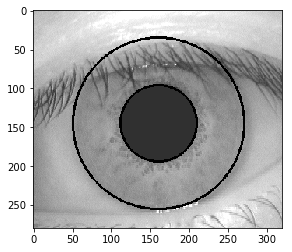

./CASIA Iris Image Database (version 1.0)/026/1/026_1_3.bmp


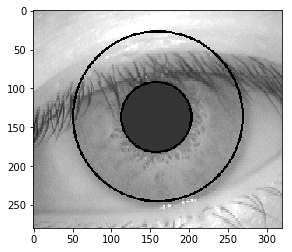

./CASIA Iris Image Database (version 1.0)/027/1/027_1_1.bmp


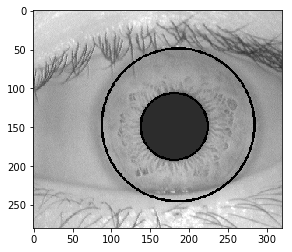

./CASIA Iris Image Database (version 1.0)/027/1/027_1_2.bmp


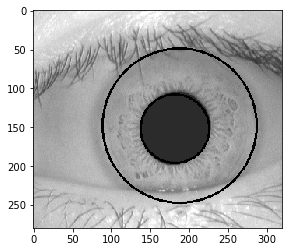

./CASIA Iris Image Database (version 1.0)/027/1/027_1_3.bmp


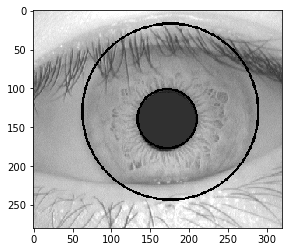

./CASIA Iris Image Database (version 1.0)/028/1/028_1_1.bmp


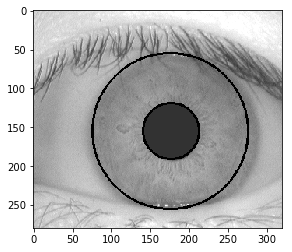

./CASIA Iris Image Database (version 1.0)/028/1/028_1_2.bmp


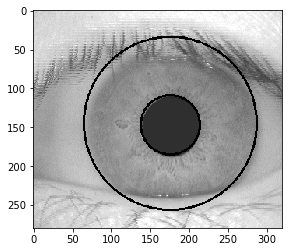

./CASIA Iris Image Database (version 1.0)/028/1/028_1_3.bmp


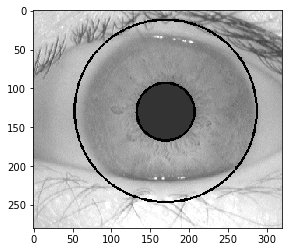

./CASIA Iris Image Database (version 1.0)/029/1/029_1_1.bmp


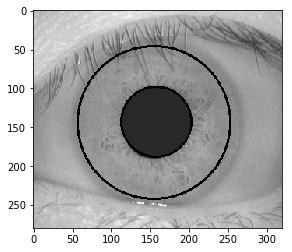

./CASIA Iris Image Database (version 1.0)/029/1/029_1_2.bmp


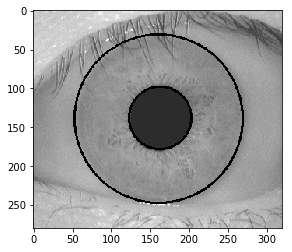

./CASIA Iris Image Database (version 1.0)/029/1/029_1_3.bmp


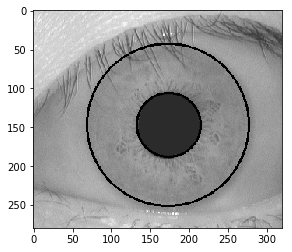

./CASIA Iris Image Database (version 1.0)/030/1/030_1_1.bmp


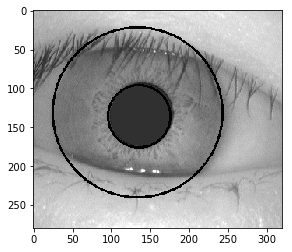

./CASIA Iris Image Database (version 1.0)/030/1/030_1_2.bmp


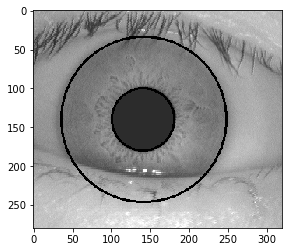

./CASIA Iris Image Database (version 1.0)/030/1/030_1_3.bmp


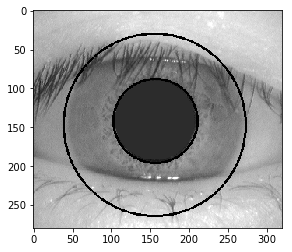

./CASIA Iris Image Database (version 1.0)/031/1/031_1_1.bmp


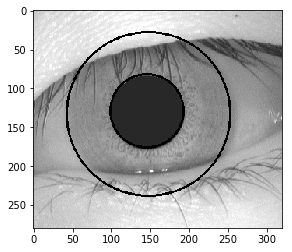

./CASIA Iris Image Database (version 1.0)/031/1/031_1_2.bmp


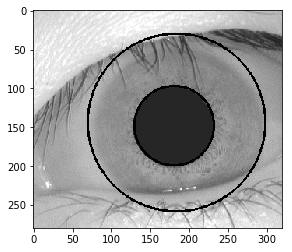

./CASIA Iris Image Database (version 1.0)/031/1/031_1_3.bmp


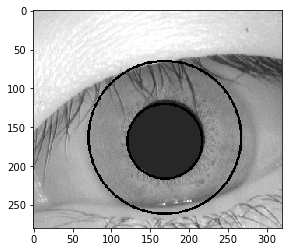

./CASIA Iris Image Database (version 1.0)/032/1/032_1_1.bmp


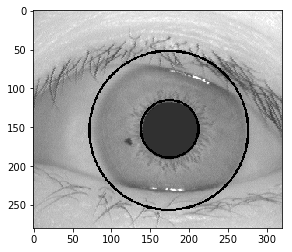

./CASIA Iris Image Database (version 1.0)/032/1/032_1_2.bmp


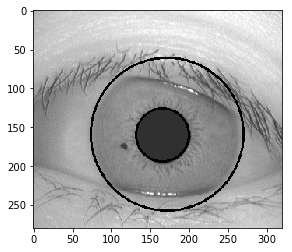

./CASIA Iris Image Database (version 1.0)/032/1/032_1_3.bmp


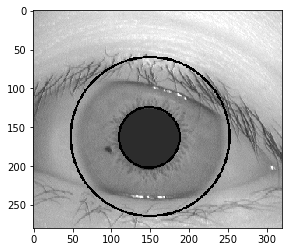

./CASIA Iris Image Database (version 1.0)/033/1/033_1_1.bmp


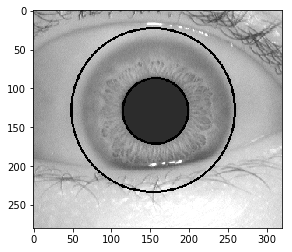

./CASIA Iris Image Database (version 1.0)/033/1/033_1_2.bmp


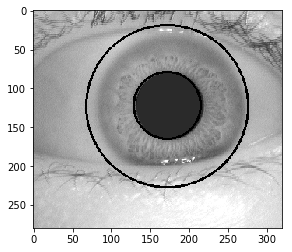

./CASIA Iris Image Database (version 1.0)/033/1/033_1_3.bmp


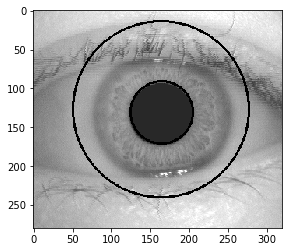

./CASIA Iris Image Database (version 1.0)/034/1/034_1_1.bmp


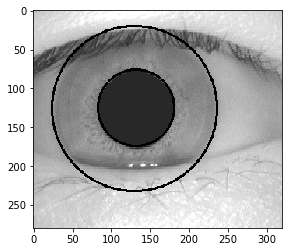

./CASIA Iris Image Database (version 1.0)/034/1/034_1_2.bmp


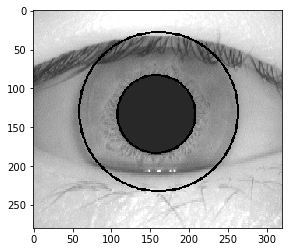

./CASIA Iris Image Database (version 1.0)/034/1/034_1_3.bmp


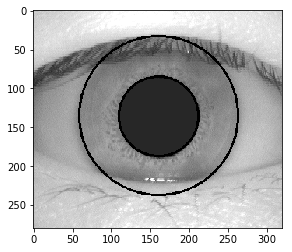

./CASIA Iris Image Database (version 1.0)/035/1/035_1_1.bmp


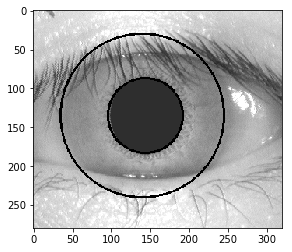

./CASIA Iris Image Database (version 1.0)/035/1/035_1_2.bmp


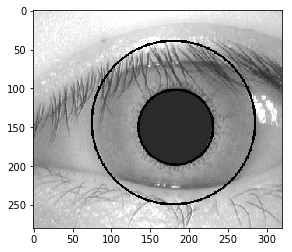

./CASIA Iris Image Database (version 1.0)/035/1/035_1_3.bmp


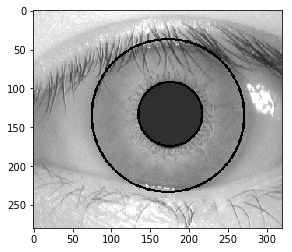

./CASIA Iris Image Database (version 1.0)/036/1/036_1_1.bmp


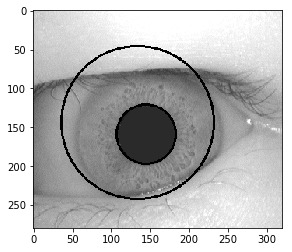

./CASIA Iris Image Database (version 1.0)/036/1/036_1_2.bmp


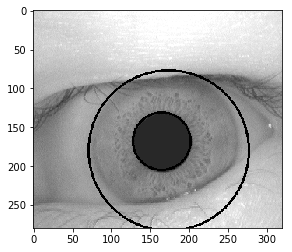

./CASIA Iris Image Database (version 1.0)/036/1/036_1_3.bmp


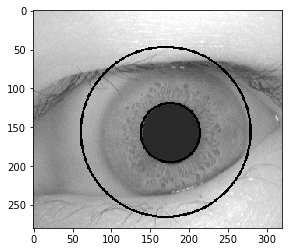

./CASIA Iris Image Database (version 1.0)/037/1/037_1_1.bmp


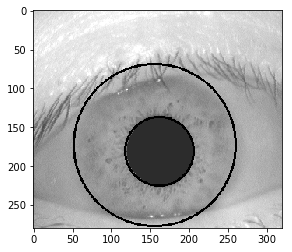

./CASIA Iris Image Database (version 1.0)/037/1/037_1_2.bmp


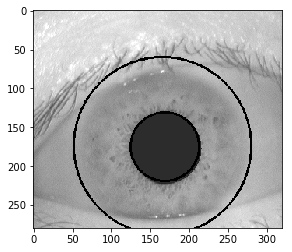

./CASIA Iris Image Database (version 1.0)/037/1/037_1_3.bmp


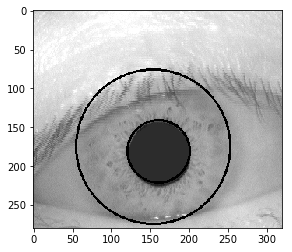

./CASIA Iris Image Database (version 1.0)/038/1/038_1_1.bmp


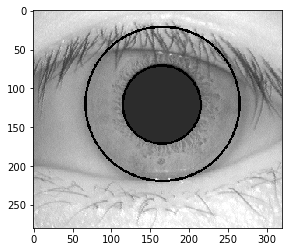

./CASIA Iris Image Database (version 1.0)/038/1/038_1_2.bmp


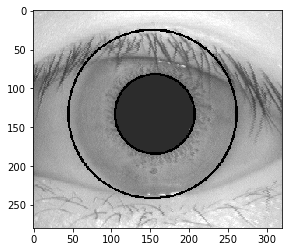

./CASIA Iris Image Database (version 1.0)/038/1/038_1_3.bmp


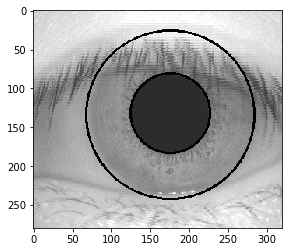

./CASIA Iris Image Database (version 1.0)/039/1/039_1_1.bmp


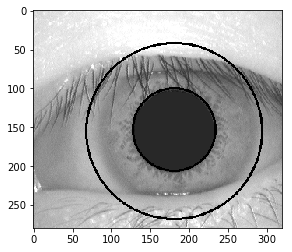

./CASIA Iris Image Database (version 1.0)/039/1/039_1_2.bmp


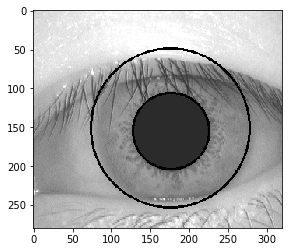

./CASIA Iris Image Database (version 1.0)/039/1/039_1_3.bmp


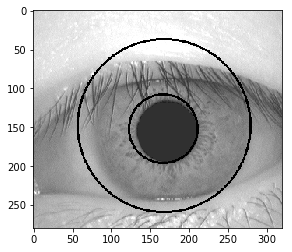

./CASIA Iris Image Database (version 1.0)/040/1/040_1_1.bmp


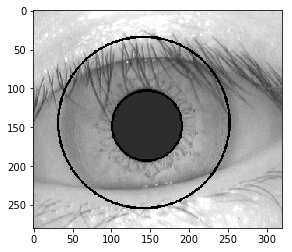

./CASIA Iris Image Database (version 1.0)/040/1/040_1_2.bmp


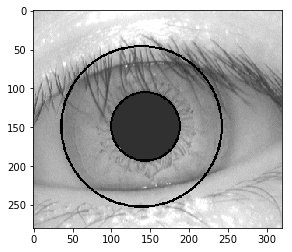

./CASIA Iris Image Database (version 1.0)/040/1/040_1_3.bmp


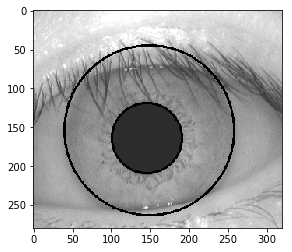

./CASIA Iris Image Database (version 1.0)/041/1/041_1_1.bmp


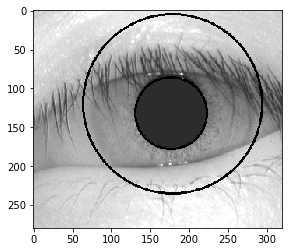

./CASIA Iris Image Database (version 1.0)/041/1/041_1_2.bmp


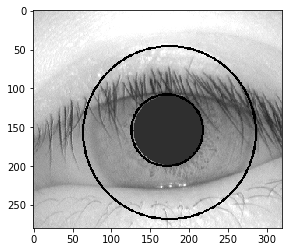

./CASIA Iris Image Database (version 1.0)/041/1/041_1_3.bmp


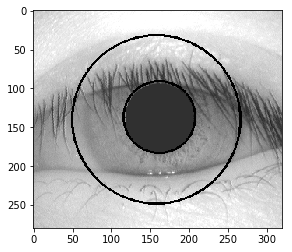

./CASIA Iris Image Database (version 1.0)/042/1/042_1_1.bmp


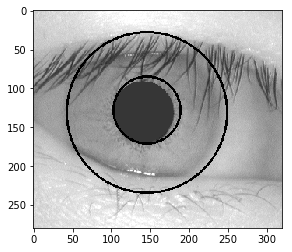

./CASIA Iris Image Database (version 1.0)/042/1/042_1_2.bmp


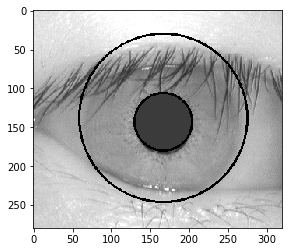

./CASIA Iris Image Database (version 1.0)/042/1/042_1_3.bmp


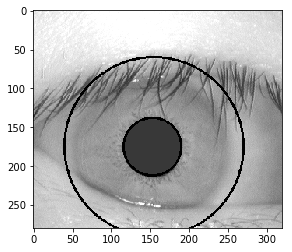

./CASIA Iris Image Database (version 1.0)/043/1/043_1_1.bmp


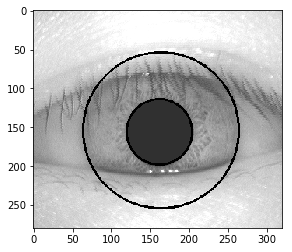

./CASIA Iris Image Database (version 1.0)/043/1/043_1_2.bmp


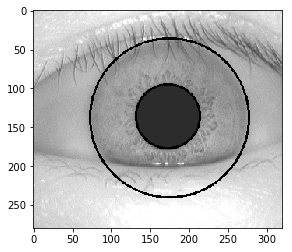

./CASIA Iris Image Database (version 1.0)/043/1/043_1_3.bmp


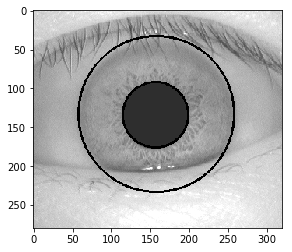

./CASIA Iris Image Database (version 1.0)/044/1/044_1_1.bmp


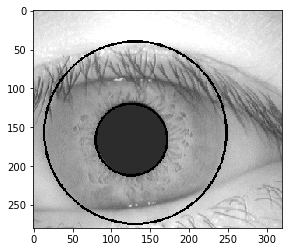

./CASIA Iris Image Database (version 1.0)/044/1/044_1_2.bmp


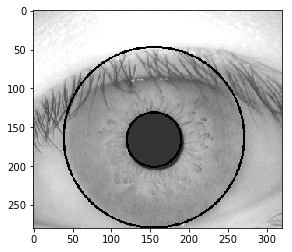

./CASIA Iris Image Database (version 1.0)/044/1/044_1_3.bmp


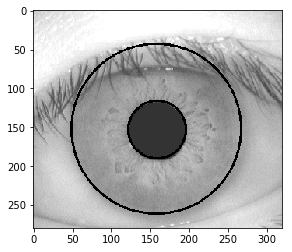

./CASIA Iris Image Database (version 1.0)/045/1/045_1_1.bmp


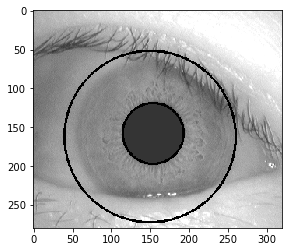

./CASIA Iris Image Database (version 1.0)/045/1/045_1_2.bmp


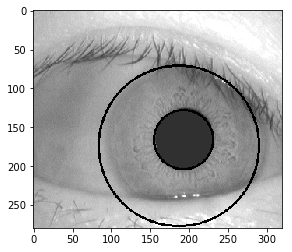

./CASIA Iris Image Database (version 1.0)/045/1/045_1_3.bmp


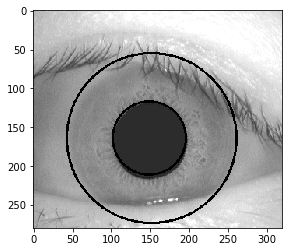

./CASIA Iris Image Database (version 1.0)/046/1/046_1_1.bmp


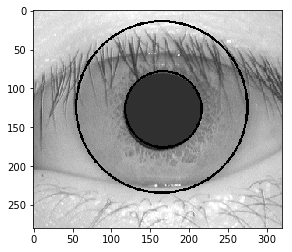

./CASIA Iris Image Database (version 1.0)/046/1/046_1_2.bmp


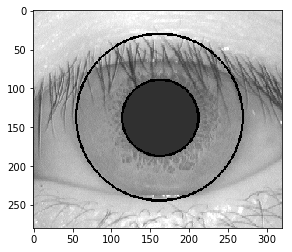

./CASIA Iris Image Database (version 1.0)/046/1/046_1_3.bmp


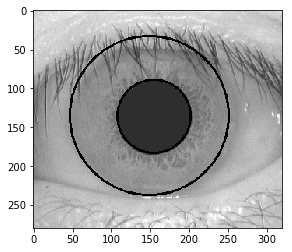

./CASIA Iris Image Database (version 1.0)/047/1/047_1_1.bmp


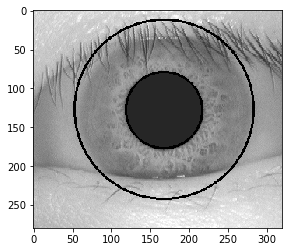

./CASIA Iris Image Database (version 1.0)/047/1/047_1_2.bmp


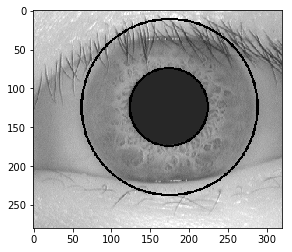

./CASIA Iris Image Database (version 1.0)/047/1/047_1_3.bmp


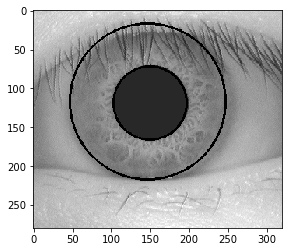

./CASIA Iris Image Database (version 1.0)/048/1/048_1_1.bmp


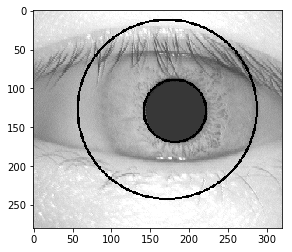

./CASIA Iris Image Database (version 1.0)/048/1/048_1_2.bmp


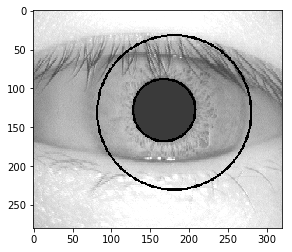

./CASIA Iris Image Database (version 1.0)/048/1/048_1_3.bmp


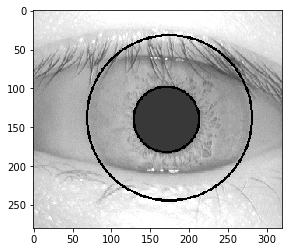

./CASIA Iris Image Database (version 1.0)/049/1/049_1_1.bmp


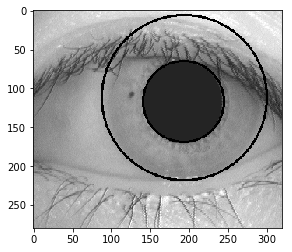

./CASIA Iris Image Database (version 1.0)/049/1/049_1_2.bmp


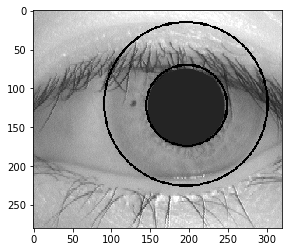

./CASIA Iris Image Database (version 1.0)/049/1/049_1_3.bmp


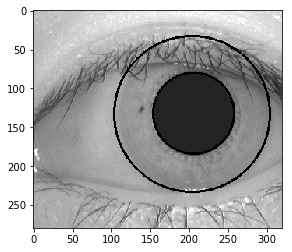

./CASIA Iris Image Database (version 1.0)/050/1/050_1_1.bmp


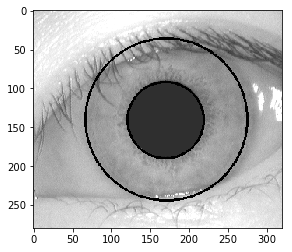

./CASIA Iris Image Database (version 1.0)/050/1/050_1_2.bmp


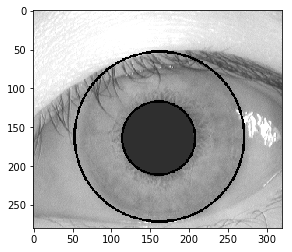

./CASIA Iris Image Database (version 1.0)/050/1/050_1_3.bmp


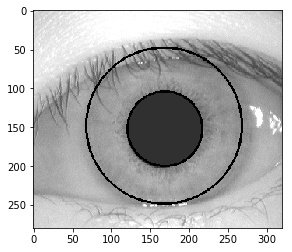

./CASIA Iris Image Database (version 1.0)/051/1/051_1_1.bmp


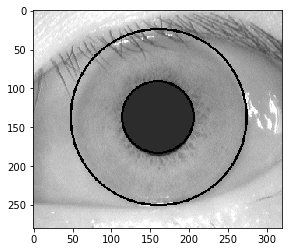

./CASIA Iris Image Database (version 1.0)/051/1/051_1_2.bmp


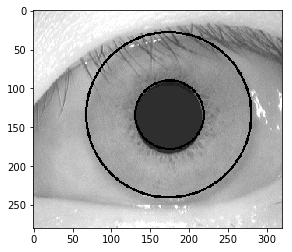

./CASIA Iris Image Database (version 1.0)/051/1/051_1_3.bmp


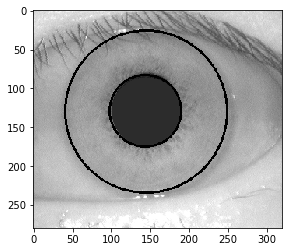

./CASIA Iris Image Database (version 1.0)/052/1/052_1_1.bmp


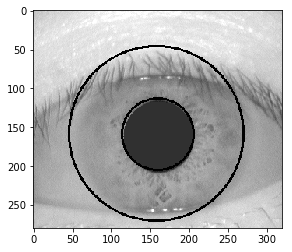

./CASIA Iris Image Database (version 1.0)/052/1/052_1_2.bmp


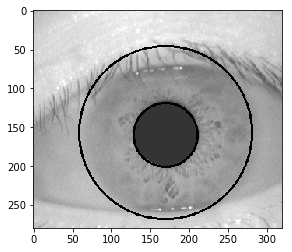

./CASIA Iris Image Database (version 1.0)/052/1/052_1_3.bmp


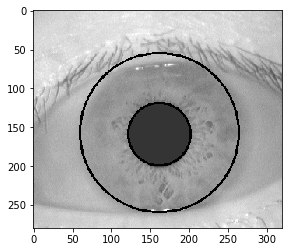

./CASIA Iris Image Database (version 1.0)/053/1/053_1_1.bmp


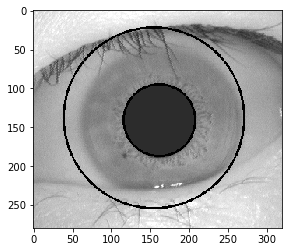

./CASIA Iris Image Database (version 1.0)/053/1/053_1_2.bmp


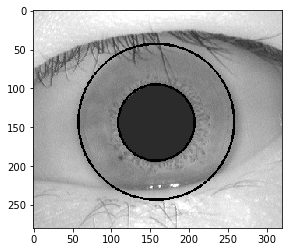

./CASIA Iris Image Database (version 1.0)/053/1/053_1_3.bmp


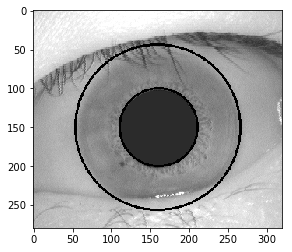

./CASIA Iris Image Database (version 1.0)/054/1/054_1_1.bmp


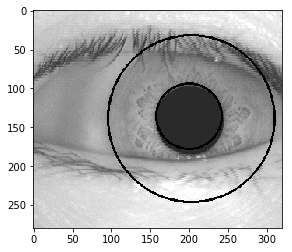

./CASIA Iris Image Database (version 1.0)/054/1/054_1_2.bmp


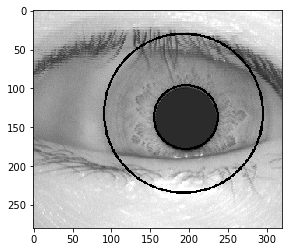

./CASIA Iris Image Database (version 1.0)/054/1/054_1_3.bmp


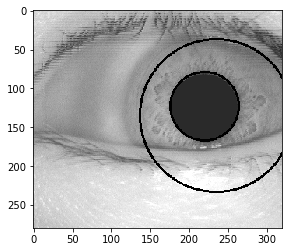

./CASIA Iris Image Database (version 1.0)/055/1/055_1_1.bmp


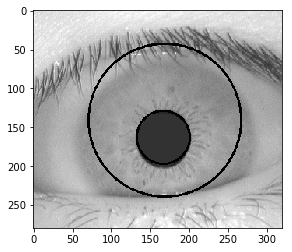

./CASIA Iris Image Database (version 1.0)/055/1/055_1_2.bmp


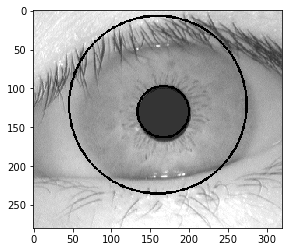

./CASIA Iris Image Database (version 1.0)/055/1/055_1_3.bmp


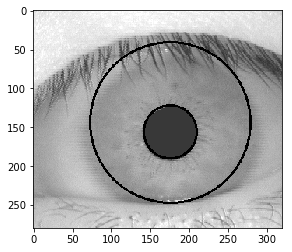

./CASIA Iris Image Database (version 1.0)/056/1/056_1_1.bmp


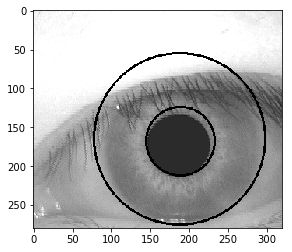

./CASIA Iris Image Database (version 1.0)/056/1/056_1_2.bmp


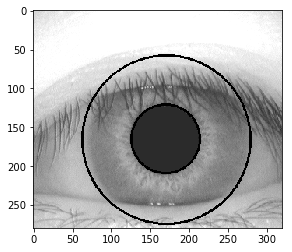

./CASIA Iris Image Database (version 1.0)/056/1/056_1_3.bmp


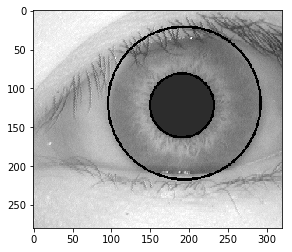

./CASIA Iris Image Database (version 1.0)/057/1/057_1_1.bmp


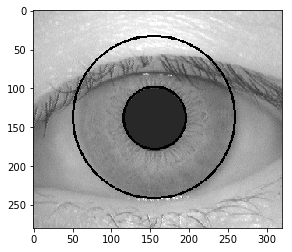

./CASIA Iris Image Database (version 1.0)/057/1/057_1_2.bmp


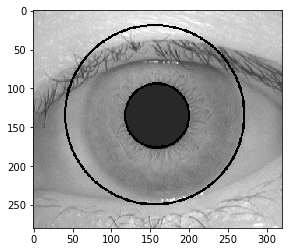

./CASIA Iris Image Database (version 1.0)/057/1/057_1_3.bmp


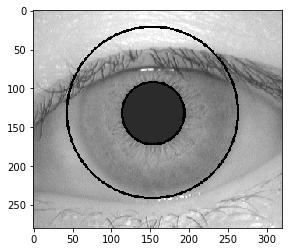

./CASIA Iris Image Database (version 1.0)/058/1/058_1_1.bmp


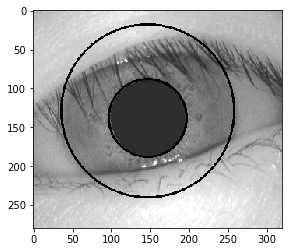

./CASIA Iris Image Database (version 1.0)/058/1/058_1_2.bmp


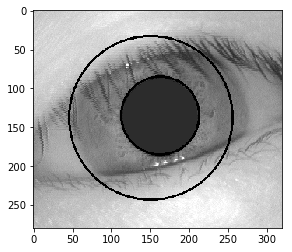

./CASIA Iris Image Database (version 1.0)/058/1/058_1_3.bmp


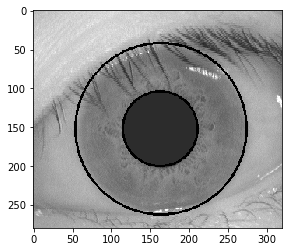

./CASIA Iris Image Database (version 1.0)/059/1/059_1_1.bmp


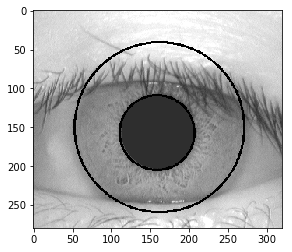

./CASIA Iris Image Database (version 1.0)/059/1/059_1_2.bmp


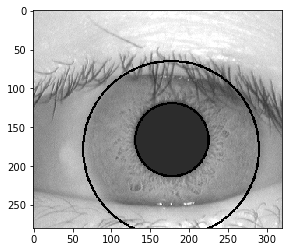

./CASIA Iris Image Database (version 1.0)/059/1/059_1_3.bmp


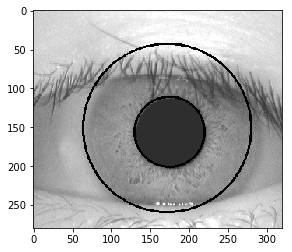

./CASIA Iris Image Database (version 1.0)/060/1/060_1_1.bmp


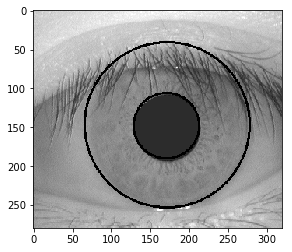

./CASIA Iris Image Database (version 1.0)/060/1/060_1_2.bmp


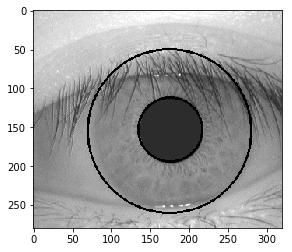

./CASIA Iris Image Database (version 1.0)/060/1/060_1_3.bmp


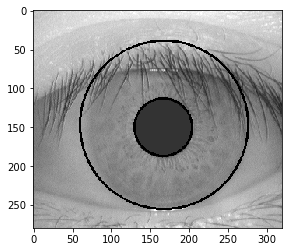

./CASIA Iris Image Database (version 1.0)/061/1/061_1_1.bmp


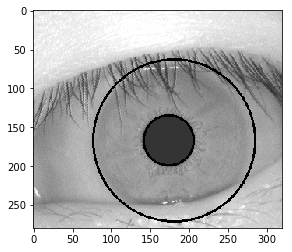

./CASIA Iris Image Database (version 1.0)/061/1/061_1_2.bmp


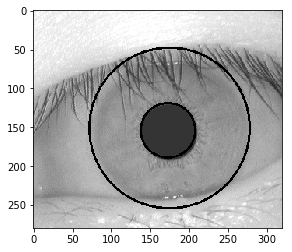

./CASIA Iris Image Database (version 1.0)/061/1/061_1_3.bmp


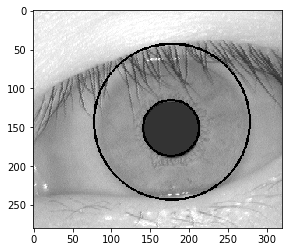

./CASIA Iris Image Database (version 1.0)/062/1/062_1_1.bmp


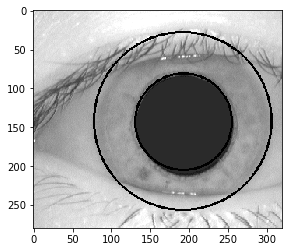

./CASIA Iris Image Database (version 1.0)/062/1/062_1_2.bmp


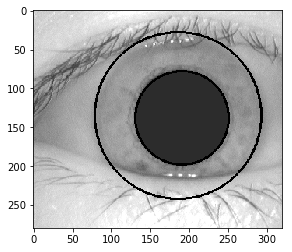

./CASIA Iris Image Database (version 1.0)/062/1/062_1_3.bmp


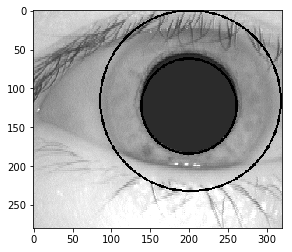

./CASIA Iris Image Database (version 1.0)/063/1/063_1_1.bmp


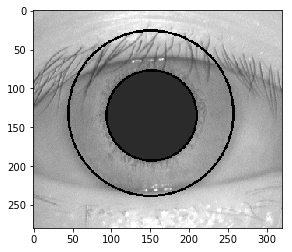

./CASIA Iris Image Database (version 1.0)/063/1/063_1_2.bmp


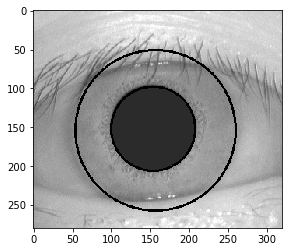

./CASIA Iris Image Database (version 1.0)/063/1/063_1_3.bmp


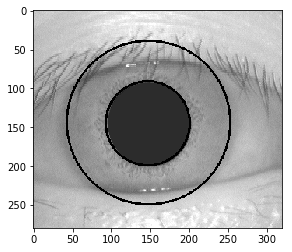

./CASIA Iris Image Database (version 1.0)/064/1/064_1_1.bmp


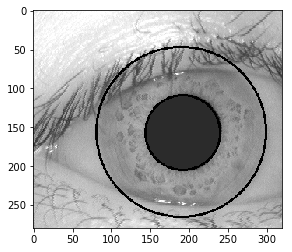

./CASIA Iris Image Database (version 1.0)/064/1/064_1_2.bmp


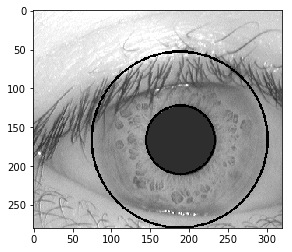

./CASIA Iris Image Database (version 1.0)/064/1/064_1_3.bmp


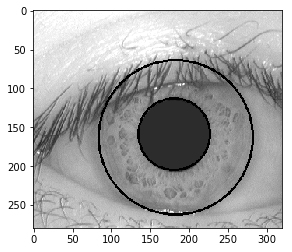

./CASIA Iris Image Database (version 1.0)/065/1/065_1_1.bmp


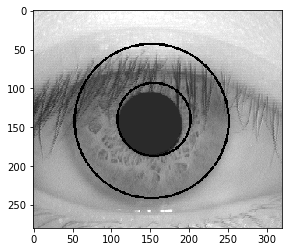

./CASIA Iris Image Database (version 1.0)/065/1/065_1_2.bmp


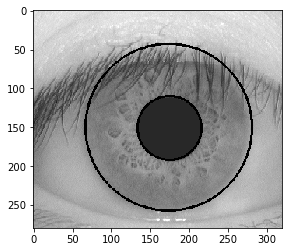

./CASIA Iris Image Database (version 1.0)/065/1/065_1_3.bmp


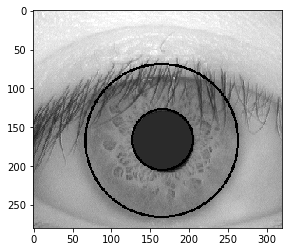

./CASIA Iris Image Database (version 1.0)/066/1/066_1_1.bmp


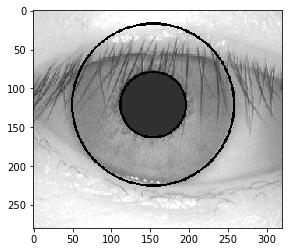

./CASIA Iris Image Database (version 1.0)/066/1/066_1_2.bmp


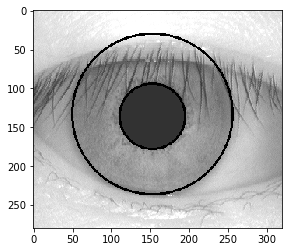

./CASIA Iris Image Database (version 1.0)/066/1/066_1_3.bmp


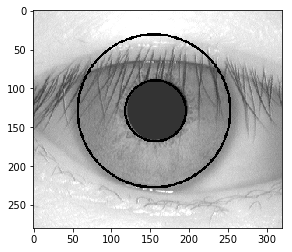

./CASIA Iris Image Database (version 1.0)/067/1/067_1_1.bmp


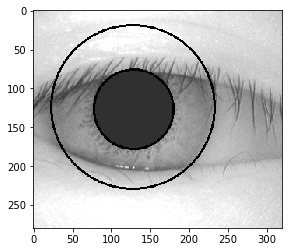

./CASIA Iris Image Database (version 1.0)/067/1/067_1_2.bmp


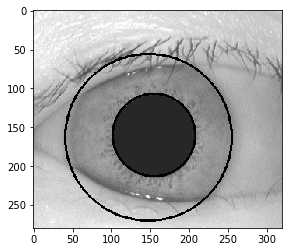

./CASIA Iris Image Database (version 1.0)/067/1/067_1_3.bmp


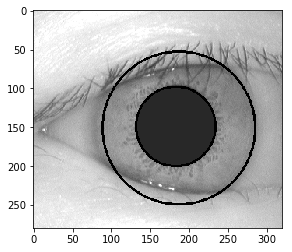

./CASIA Iris Image Database (version 1.0)/068/1/068_1_1.bmp


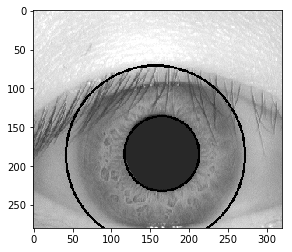

./CASIA Iris Image Database (version 1.0)/068/1/068_1_2.bmp


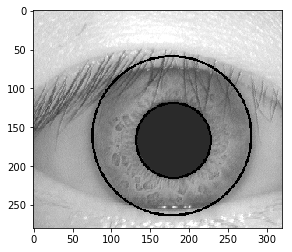

./CASIA Iris Image Database (version 1.0)/068/1/068_1_3.bmp


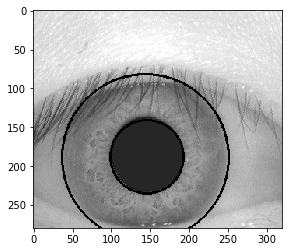

./CASIA Iris Image Database (version 1.0)/069/1/069_1_1.bmp


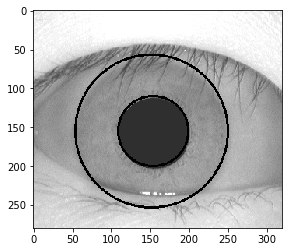

./CASIA Iris Image Database (version 1.0)/069/1/069_1_2.bmp


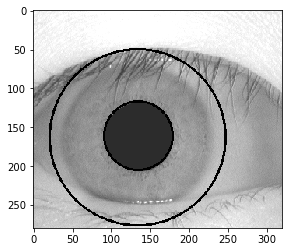

./CASIA Iris Image Database (version 1.0)/069/1/069_1_3.bmp


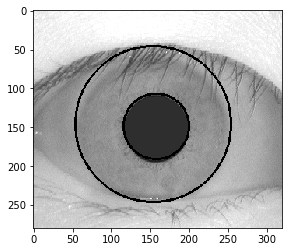

./CASIA Iris Image Database (version 1.0)/070/1/070_1_1.bmp


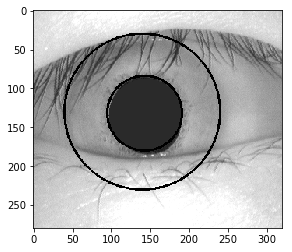

./CASIA Iris Image Database (version 1.0)/070/1/070_1_2.bmp


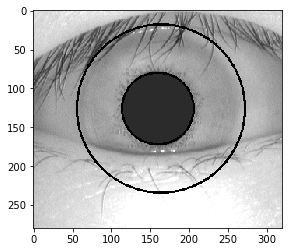

./CASIA Iris Image Database (version 1.0)/070/1/070_1_3.bmp


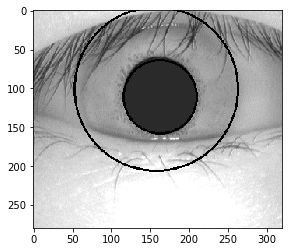

./CASIA Iris Image Database (version 1.0)/071/1/071_1_1.bmp


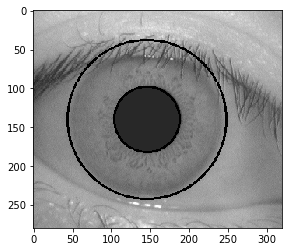

./CASIA Iris Image Database (version 1.0)/071/1/071_1_2.bmp


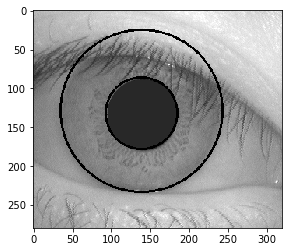

./CASIA Iris Image Database (version 1.0)/071/1/071_1_3.bmp


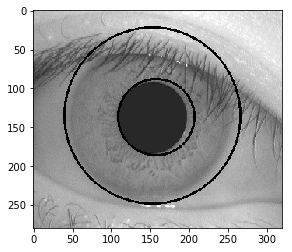

./CASIA Iris Image Database (version 1.0)/072/1/072_1_1.bmp


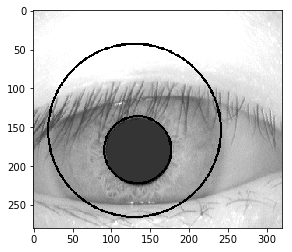

./CASIA Iris Image Database (version 1.0)/072/1/072_1_2.bmp


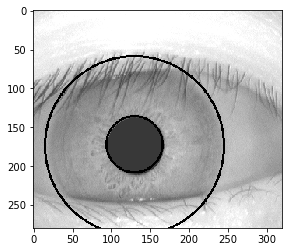

./CASIA Iris Image Database (version 1.0)/072/1/072_1_3.bmp


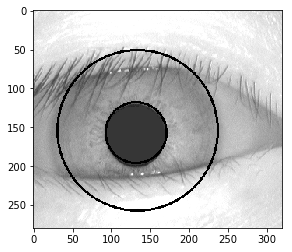

./CASIA Iris Image Database (version 1.0)/073/1/073_1_1.bmp


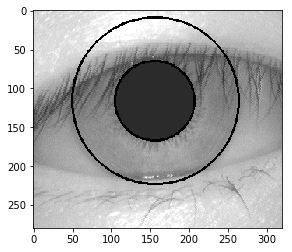

./CASIA Iris Image Database (version 1.0)/073/1/073_1_2.bmp


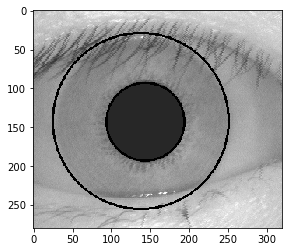

./CASIA Iris Image Database (version 1.0)/073/1/073_1_3.bmp


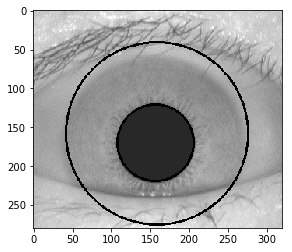

./CASIA Iris Image Database (version 1.0)/074/1/074_1_1.bmp


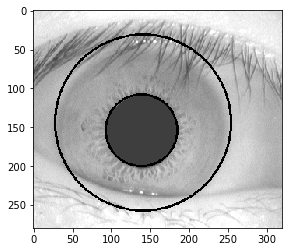

./CASIA Iris Image Database (version 1.0)/074/1/074_1_2.bmp


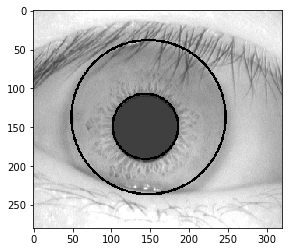

./CASIA Iris Image Database (version 1.0)/074/1/074_1_3.bmp


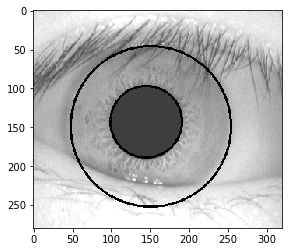

./CASIA Iris Image Database (version 1.0)/075/1/075_1_1.bmp


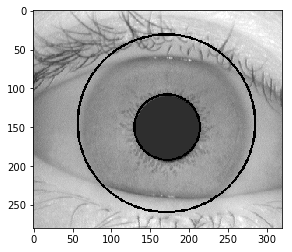

./CASIA Iris Image Database (version 1.0)/075/1/075_1_2.bmp


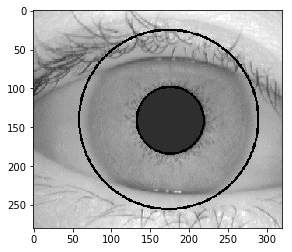

./CASIA Iris Image Database (version 1.0)/075/1/075_1_3.bmp


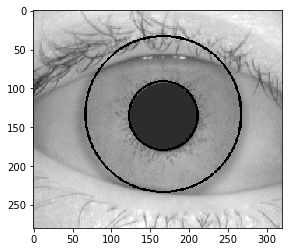

./CASIA Iris Image Database (version 1.0)/076/1/076_1_1.bmp


In [ ]:
fnames, label = getFilenames( train = True) 

for i in range(0, len(fnames)):
    name = fnames[i]
    img0 = cv2.imread(name,0)
    print(name)
    drawIris(img0)

In [15]:
def CircularMask(h, w, center, radius):
    Y, X = np.ogrid[:h, :w]
    dist_from_center = np.sqrt((X - center[0])**2 + (Y-center[1])**2)
    mask = dist_from_center <= radius
    return mask

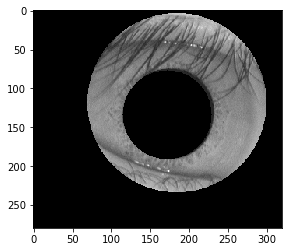

In [11]:
[X_iris, Y_iris,r_iris] = irisBoundary(img)
[X_pupil,Y_pupil,r] = pupilBoundary(img)
[h,w] = img.shape
outCirMask = CircularMask(h, w, center = [X_iris, Y_iris], radius = r_iris)
inCirMask = CircularMask(h, w, center = [X_pupil,Y_pupil], radius = r)

masked_img = img.copy()

# for any pixel outside the  outer Iris boundary
# or inside the pupil boundary would be zero
masked_img[(~outCirMask) | inCirMask ] = 0    
plt.imshow(masked_img, cmap = 'gray')
plt.show()

# Iris Normalization

- 

In [12]:
def Lima_Normalization(oriImg, Xi, Yi, ri, Xp, Yp, rp, rot = 0, M = 64, N = 512):
    In = np.zeros((M,N))
    
    #l is the distance of two centers
    l = np.sqrt((Xi - Xp)**2 + (Yi - Yp)**2)
    
    if l == 0: 
        alpha = 0
    else:
        alpha = np.arcsin(np.abs(Yi - Yp)/l)
    
    for X in range(0, N):
        theta = 2*np.pi*X/(N-1)
        beta = np.pi - theta - alpha
        #if theta <= (np.pi - alpha) and theta > ( - alpha):
        #    beta = np.pi - theta - alpha
        #elif theta > (np.pi - alpha) and theta <= (2*np.pi - alpha):
        #    beta = theta + alpha - np.pi

        r3 = l*np.cos(beta) + np.sqrt((np.cos(beta)**2 - 1)*l**2 + ri**2)
        Xp_theta = Xp + np.cos(theta)*rp
        Yp_theta = Yp - np.sin(theta)*rp
    
        Xi_theta = Xp + np.cos(theta)*r3
        Yi_theta = Yp - np.sin(theta)*r3

        for Y in range(0,M):
            x = np.int0(Xp_theta + (Xi_theta - Xp_theta)*Y/(M-1))
            y = np.int0(Yp_theta + (Yi_theta - Yp_theta)*Y/(M-1))
            
            # Additional Conditions
            x = min(x, 319) or max(0,x)
            y = min(y, 279) or max(0,y)
            
            In[Y, X] = oriImg[y,x]
    
    In1 = np.zeros((M,N))
    X0 = np.int0((N-1)*rot/(360))
    print(X0)
    
    if X0 > 0 :
        In1[:,0:(N-X0)] = In[:,X0:N]
        In1[:,(N-X0):N] = In[:,0:X0]
    else:
        In1[:, 0:-X0] = In[:,(N+X0):N]
        In1[:, -X0:N] = In[:,0:(N+X0)]

    return(In1.astype(np.uint8))
        

0


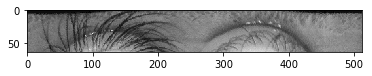

In [13]:
normImg = Lima_Normalization(img, X_iris, Y_iris, r_iris, X_pupil,Y_pupil,r)
plt.imshow(normImg, cmap = 'gray')
plt.show()

0


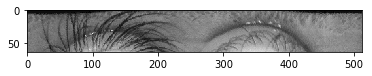

In [14]:
normImg0 = Lima_Normalization(img, X_iris, Y_iris, r_iris, X_pupil,Y_pupil,r,rot = 0)
plt.imshow(normImg0, cmap = 'gray')
plt.show()

127


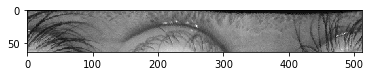

In [20]:
normImg90 = Lima_Normalization(img, X_iris, Y_iris, r_iris, X_pupil,Y_pupil,r, rot = 90)
plt.imshow(normImg90, cmap = 'gray')
plt.show()

12


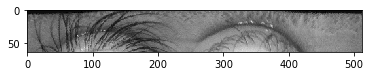

In [21]:
normImg9 = Lima_Normalization(img, X_iris, Y_iris, r_iris, X_pupil,Y_pupil,r, rot = 9)
plt.imshow(normImg9, cmap = 'gray')
plt.show()

# Iris Enhancement

- 

In [15]:
def bgIllumination(normImg):
    background = np.zeros((4,32))
    for y in range(0, 4):
        for x in range(0,32):
            background[y,x] = np.mean(normImg[16*y:16*(1+y),16*x:16*(x+1)])
    
    bg_resize = cv2.resize(background,(512,64), interpolation = cv2.INTER_CUBIC).astype(np.uint8)
    return(bg_resize)
    

0


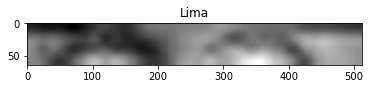

array([[ 88,  88,  88, ...,  95,  95,  95],
       [ 87,  87,  88, ...,  95,  95,  95],
       [ 87,  87,  87, ...,  95,  95,  95],
       ..., 
       [135, 135, 135, ..., 142, 142, 142],
       [135, 135, 135, ..., 142, 142, 142],
       [135, 135, 135, ..., 142, 142, 142]], dtype=uint8)

In [16]:
normImg = Lima_Normalization(img, X_iris, Y_iris, r_iris, X_pupil,Y_pupil,r)
bg_resize = bgIllumination(normImg)
plt.imshow( bg_resize, cmap = 'gray'),plt.title('Lima')
plt.show()
bg_resize

[[0 0 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]
 ..., 
 [0 3 0 ..., 2 0 0]
 [0 3 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]]


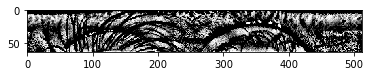

In [17]:
def hisEqulization(normImg, bg_Subtract = True):
    equalImage = np.zeros((64,512))
    
    if bg_Subtract == True:
        bg_resize = bgIllumination(normImg)
        normImg_bg  = cv2.subtract(normImg,bg_resize)
        print(normImg_bg )
    else:
        normImg_bg = normImg
        
    for y in range(0, 2):
        for x in range(0,16):
            img_slice = normImg_bg[y*32:(1+y)*32,x*32:(x+1)*32]
            equalImage[y*32:(1+y)*32,x*32:(x+1)*32] = cv2.equalizeHist(img_slice)
    return(equalImage)

plt.imshow(hisEqulization(normImg), cmap = 'gray')
plt.show()


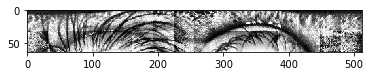

In [18]:
plt.imshow(hisEqulization(normImg, bg_Subtract = False), cmap = 'gray')
plt.show()

# Feature Extraction


In [27]:
# Spacial Filter
def G_filter(x, y, channel):
    x = np.int0(x)
    y = np.int0(y)
    if channel == 1:
        sig_x = 3
        sig_y = 1.5
    
    if channel == 2:
        sig_x = 4.5
        sig_y = 1.5
        
    f = 1/sig_y
    M1 = np.cos(2*np.pi*f*(np.sqrt(x**2 + y**2)))
    
    G = (1/(2*np.pi*sig_x*sig_y))*(np.exp(-(x**2/sig_x**2 + y**2/sig_y**2)/2)) * M1
    return(G)


In [28]:
def getGKernel(channel, size = 9):
    mask = np.zeros((size,size))
    
    for k_x in range(0,size):
        for k_y in range(0,size):
            mask[k_y, k_x] = G_filter(- size/2 + k_x,  - size/2 + k_y, channel)
    return(mask)

In [36]:
getGKernel(channel = 1, size = 8)

array([[  5.52556207e-05,  -3.06388333e-04,   8.03479289e-04,
         -7.58353774e-06,  -5.05148961e-04,  -7.58353774e-06,
          8.03479289e-04,  -3.06388333e-04],
       [ -9.83895828e-04,   1.37339942e-03,  -3.15228983e-03,
          3.52144575e-03,   4.78650651e-03,   3.52144575e-03,
         -3.15228983e-03,   1.37339942e-03],
       [  5.93695354e-03,  -7.25334290e-03,   8.76324382e-03,
         -1.37309520e-02,  -7.27006147e-03,  -1.37309520e-02,
          8.76324382e-03,  -7.25334290e-03],
       [ -9.23864027e-05,   1.33591957e-02,  -2.26385127e-02,
          2.50787445e-02,  -1.41601462e-02,   2.50787445e-02,
         -2.26385127e-02,   1.33591957e-02],
       [ -7.27006147e-03,   2.14516339e-02,  -1.41601462e-02,
         -1.67282362e-02,   3.53677651e-02,  -1.67282362e-02,
         -1.41601462e-02,   2.14516339e-02],
       [ -9.23864027e-05,   1.33591957e-02,  -2.26385127e-02,
          2.50787445e-02,  -1.41601462e-02,   2.50787445e-02,
         -2.26385127e-02,   1.3

In [ ]:
#def filterImage(eqImg, channel):
#    ROI = eqImg[0:48,]
#    Fi = np.zeros(np.shape(ROI))
    
#    for y in range(0, np.shape(ROI)[0]):
#        for x in range(0,np.shape(ROI)[1]):
#            mask = getGKernel(x, y, channel)
#            Fi[y, x] = cv2.filter2D(ROI, -1, mask)[y,x]
#    return(Fi)

In [22]:
def filterImage(eqImg, channel):
    ROI = eqImg[0:48,]
    mask = getGKernel(channel)
    mask = np.asanyarray(mask, np.float32)
    Fi = cv2.filter2D(ROI, -1, mask)         
    return(Fi)

In [23]:
# feature vector
equalImage = hisEqulization(normImg,bg_Subtract = False )
ROI = equalImage[0:48,]

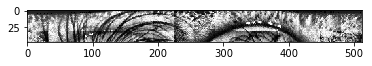

48

In [24]:
plt.imshow(ROI, cmap = 'gray')
plt.show()
np.shape(ROI)[0]

In [25]:
F1 = filterImage(equalImage, channel = 1)

In [26]:
F1

array([[ -1.15514737,  -0.9315609 ,  -1.41324626, ...,  -0.81037015,
         -0.9398545 ,  -0.94696141],
       [ -1.51741214,  -2.2796262 ,  -0.62116768, ...,  -1.17186649,
         -0.92425808,  -0.91306311],
       [ -1.46814849,  -1.16059572,  -1.15854547, ...,  -0.04875287,
         -1.61232826,  -1.58256688],
       ..., 
       [ -0.74384329, -13.01164007,  -5.27605915, ...,  -3.96527568,
         -2.83088404,  -0.61377348],
       [ -7.31261491, -11.30603927,  -4.12621823, ...,   4.33867572,
         -5.86326079,  -3.28588048],
       [ -7.3440052 , -11.31708345,  -4.12966643, ...,   4.34251141,
         -5.88352818,  -3.30614786]])

In [36]:
F2 = filterImage(equalImage, channel = 2)


In [37]:
#F2

In [38]:
def getFeatureVec(F1, F2):
    vec1 = []
    vec2 = []
    for y in range(0, 6):
        for x in range(0, 64):
            m1 = np.sum(F1[8*y:8*(y+1), 8*x:8*(x+1)])/64
            sigma1 = np.sum(np.abs(F1[8*y:8*(y+1), 8*x:8*(x+1)] - m1))/64
            
            m2 = np.sum(F2[8*y:8*(y+1), 8*x:8*(x+1)])/64
            sigma2 = np.sum(np.abs(F2[8*y:8*(y+1), 8*x:8*(x+1)] - m2))/64
            
            vec1.append(m1)
            vec1.append(sigma1)
            vec2.append(m2)
            vec2.append(sigma2)
    return(vec1 + vec2)

# Iris Matching


In [39]:
# Feature Extraction
V = getFeatureVec(F1, F2)
V

[3.2197321549318771,
 2.1361972597191636,
 2.9380250044773693,
 2.1761908050397514,
 2.3074569019684659,
 1.3548759722674109,
 2.3068072992951456,
 1.6881537376377143,
 2.2525215623937256,
 1.4771705270631541,
 2.609279738673993,
 1.5729747016395346,
 2.6440953753434564,
 1.3618185762685502,
 2.3470014687413823,
 1.0694636575063323,
 2.5002288182984094,
 2.2423975003038805,
 3.072599815648799,
 2.633057971209027,
 4.0636191037417557,
 3.3616452670884125,
 3.4115005618671144,
 2.8988389859788981,
 4.3964075598594254,
 4.15647464510183,
 6.3042713355288234,
 5.1587064925023718,
 6.9437426030369229,
 4.6254291856530241,
 7.5084506140968843,
 4.2700840860717246,
 9.1523171859721479,
 5.4360356323264636,
 5.458335279685512,
 5.9094890227114067,
 5.8239519030507267,
 4.45526058336565,
 4.7067059742794299,
 3.5002943193187539,
 6.1008010683627267,
 4.5818776185256826,
 7.4932526960506021,
 4.8266414160869573,
 6.7975528547042927,
 5.0804807394719997,
 6.4765888272709162,
 3.7796849369203169,


In [31]:
def callALLFuncs(filename):
    img = cv2.imread(filename,0) 
    [X_pupil,Y_pupil,r] = pupilBoundary(img)
    [X_iris, Y_iris, r_iris] = irisBoundary(img)
    normImg = Lima_Normalization(img, X_iris, Y_iris, r_iris, X_pupil,Y_pupil,r)
    eqImage = hisEqulization(normImg)
    F1 = filterImage(eqImage, channel = 1)
    F2 = filterImage(eqImage, channel = 2)
    V = getFeatureVec(F1, F2)
    return(V)

In [32]:
callALLFuncs('./CASIA Iris Image Database (version 1.0)/019/2/019_2_2.bmp') == V


0
[[ 0  0  0 ...,  0  0  0]
 [ 0  0  0 ...,  0  0  0]
 [ 0  0  0 ...,  0  0  0]
 ..., 
 [ 0  0  9 ..., 19  9  0]
 [23  4 21 ..., 30 28 20]
 [23  4 18 ..., 30 28 20]]


False

In [37]:
from scipy.stats import mode
a = [[1,2,3],[0,6,-1], [1,3,3]]

mode(a, axis = 0)[0][0]

array([1, 2, 3])

In [14]:
def combidePredbyMode(predLabel, k = 4):
    predMode =[]
    newLen = np.int0(len(predLabel)/k)  # 432/ 4 = 108
    newtestLabel = np.arange(1,109)
    for i in range(0,newLen):
        predMode.append(mode(predLabel[i*k: k*(i + 1)])[0][0])
    accuracy = sum(predMode == newtestLabel)/len(newtestLabel)
    return(predMode, accuracy)



TypeError: can't multiply sequence by non-int of type 'float'

In [ ]:
d1_mode_pred, d1_Mode_Accuracy_lda = combidePredbyMode(d1_pred_lda, k = 4)
d2_mode_pred, d2_Mode_Accuracy_lda = combidePredbyMode(d2_pred_lda, k = 4)
d3_mode_pred, d3_Mode_Accuracy_lda = combidePredbyMode(d3_pred_lda, k = 4)
print(d1_Mode_Accuracy_lda)
print(d2_Mode_Accuracy_lda)
print(d3_Mode_Accuracy_lda)